

# Workshop 2: Antimicrobial resistance

<img src="freestocks-nss2eRzQwgw-unsplash.jpg" style="float: right;" width="300" >Antimicrobial resistance (AMR) occurs when microorganisms develop the ability to survive exposure to antimicrobial drugs. This means that these drugs are no longer effective at killing or controlling the growth of the resistant microorganisms, which can lead to serious infections in humans and animals. 

AMR is a global public health threat as it can lead to the spread of untreatable diseases and increase the risk of outbreaks. EARS-Net (European Antimicrobial Resistance Surveillance Network) is a surveillance network  that monitors AMR in bacteria that cause infections in humans, under the coordination of the European Centre for Disease Prevention and Control (ECDC). 

EARS-Net collects data on a range of bacterial pathogens, including Escherichia coli, Staphylococcus aureus, and Streptococcus pneumoniae, as well as on the susceptibility of these bacteria to various antimicrobial drugs. The data is collected from a network of laboratories across the EU and is analyzed by the ECDC to generate annual reports on the status of AMR in the EU.

In this workshop, we will use Python programming to analyse data from EARS-Net to help us understand the magnitude of the problem of AMR, and to see how the prevalence of AMR has changed over time. 

#### Intended Learning Outcomes

By the end of this workshop, you should be able to:

* Describe how AMR prevalence has changed within Europe over the past decade, and how AMR prevalence differs geographically. 
* Import filter and select data using the Pandas module in Python
* Write code to produce appropriate graphs using the Seaborn module in Python

### Working as a group

The dataset we will analyse today is large - it contains AMR data for 8 bacterial species across 30 countries for 22 years. 

You should work together as a group:

* **Discuss your code, ideas and answers with other members of the group.** Peer assistance (not copying answers but talking through your approaches to the problem) can help avoid you getting stuck, increase how much you learn from the session and make it more enjoyable.

* **Co-ordinate your analyses.** Split the more involved tasks between the group: select different countries and organisms to look at and compare what you observe. 

### Final task

* **As a group** Assemble a single figure that illustrates the problem of antimicrobial resistance. That figure may have individual subplots if you wish

* **Individual work** Upload the figure to Pebblepad. Write a paragraph to accompany the figure your group produced. Explain current status of AMR in Europe and what your figure indicates regarding the need for the development of new antimicrobials and the better management of current ones. 

**Saving figures to disk** 

You will want to save your figures as JPG, PNG or PDF files. To do this you can use the command `plt.savefig("my_plot.png")`. Replace the file extension with 'jpg' or 'pdf' to produce those types of files.


# Dataset Information

Data were downloaded from https://atlas.ecdc.europa.eu/public/index.aspx?Dataset=27&HealthTopic=4. All indicators and all time periods were downloaded.
    
For further information about the data, see 'AMR_Information_about_the_data_2021.pdf'


### Importing modules

As discussed in Lecture 2, we need to import external Python libraries (modules) before we can use them. By importing these libraries, the code we write will have access to a range of tools and functions for working with and visualising data. 

Here we import: 
* pandas: A library for data manipulation and analysis in Python. It provides tools for reading and writing data, handling missing values, and manipulating data frames.
* matplotlib: A library for data visualization in Python. It provides functions for creating a wide variety of plots and charts, including scatter plots, bar plots, histograms, and many more.
* seaborn: A library for statistical data visualization in Python. It is built on top of matplotlib and provides a high-level interface for drawing statistical graphics.



In [2]:
# import modules
%matplotlib inline

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Task 2.1: Loading in the data

Before we can analyse or visulise the dataset, we first need to load it. The data is provided as a CSV (Comma Separated Values) file. 

To load a CSV file into Pandas, you can use the read_csv function of the Pandas library. Here is an example of how to use read_csv:

```Python
import pandas as pd

# Load the CSV file into a DataFrame named 'df'
df = pd.read_csv('file.csv')

```

In the example above, `read_csv()` reads the CSV file called 'file.csv' from the specified path and loads it into a Pandas DataFrame.

Load the data in the file named 'ECDC_percentage_resistant.csv' into a Pandas dataframe called amr_df


In [3]:
amr_df = pd.read_csv("ECDC_percentage_resistant.csv")

# Task 2.2: Checking the loaded data

Before we start working with the data, you should check that it has been correctly loaded in. Are your data types as expected?

Run the following commands to view your dataframe and its attributes:

|Command|Description|
|-------|:-----------|
|amr_df.head(5)|The head method displays the first 5 lines of the dataframe|
|amr_df.info()| The info method is useful for getting a quick overview of the data in a DataFrame, especially when working with large datasets. It displays the number of rows and columns in the DataFrame, the data type of each column, the number of non-null values in each column, and the memory usage of the DataFrame.|


In [43]:
display(amr_df.head(5))

,Organism,AntimicrobialGroup,Indicator,Year,RegionCode,RegionName,PercentageResistant
0,Acinetobacter spp.,Aminoglycosides,"R - resistant isolates, percentage",2012,AT,Austria,NaN
1,Acinetobacter spp.,Aminoglycosides,"R - resistant isolates, percentage",2012,BE,Belgium,NaN
2,Acinetobacter spp.,Aminoglycosides,"R - resistant isolates, percentage",2012,BG,Bulgaria,58.461538
3,Acinetobacter spp.,Aminoglycosides,"R - resistant isolates, percentage",2012,CY,Cyprus,52.173913
4,Acinetobacter spp.,Aminoglycosides,"R - resistant isolates, percentage",2012,CZ,Czechia,NaN


In [15]:
organism = 'Klebsiella pneumoniae' 
    
region = 'Greece'

antimicrobials = ["Aminoglycosides", "Carbapenems", "Fluoroquinolones", "Third-generation cephalosporins", "Combined resistance (third-generation cephalosporins, fluoroquinolones, and aminoglycosides)"]
for antimicrobial in antimicrobials:
    
    amr_1_df=amr_df.query("Organism ==@organism and RegionName ==@region and AntimicrobialGroup ==@antimicrobial")

    display(amr_1_df.head(200))

,Organism,AntimicrobialGroup,Indicator,Year,RegionCode,RegionName,PercentageResistant
8751,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2005,EL,Greece,58.732212
8780,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2006,EL,Greece,51.248514
8810,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2007,EL,Greece,51.802266
8840,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2008,EL,Greece,53.258845
8870,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2009,EL,Greece,57.807716
8898,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2010,EL,Greece,59.988074
8927,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2011,EL,Greece,68.433882
8957,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2012,EL,Greece,59.902029
8987,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2013,EL,Greece,55.175364
9017,Klebsiella pneumoniae,Aminoglycosides,"R - resistant isolates, percentage",2014,EL,Greece,59.325211


,Organism,AntimicrobialGroup,Indicator,Year,RegionCode,RegionName,PercentageResistant
9255,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2005,EL,Greece,27.813713
9284,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2006,EL,Greece,32.855436
9314,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2007,EL,Greece,42.443064
9344,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2008,EL,Greece,36.592179
9374,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2009,EL,Greece,43.515673
9402,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2010,EL,Greece,49.081209
9431,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2011,EL,Greece,68.154034
9461,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2012,EL,Greece,60.479452
9491,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2013,EL,Greece,59.387924
9521,Klebsiella pneumoniae,Carbapenems,"R - resistant isolates, percentage",2014,EL,Greece,62.316176


,Organism,AntimicrobialGroup,Indicator,Year,RegionCode,RegionName,PercentageResistant
10263,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2005,EL,Greece,54.404145
10292,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2006,EL,Greece,49.642857
10322,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2007,EL,Greece,55.061983
10352,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2008,EL,Greece,64.292409
10382,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2009,EL,Greece,65.621156
10410,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2010,EL,Greece,70.883055
10439,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2011,EL,Greece,72.232416
10469,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2012,EL,Greece,69.677871
10499,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2013,EL,Greece,67.576792
10529,Klebsiella pneumoniae,Fluoroquinolones,"R - resistant isolates, percentage",2014,EL,Greece,67.638758


,Organism,AntimicrobialGroup,Indicator,Year,RegionCode,RegionName,PercentageResistant
10767,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2005,EL,Greece,60.594315
10796,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2006,EL,Greece,57.907253
10826,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2007,EL,Greece,61.831276
10856,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2008,EL,Greece,65.740741
10886,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2009,EL,Greece,68.665851
10914,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2010,EL,Greece,74.614472
10943,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2011,EL,Greece,75.795796
10973,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2012,EL,Greece,70.870459
11003,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2013,EL,Greece,70.115894
11033,Klebsiella pneumoniae,Third-generation cephalosporins,"R - resistant isolates, percentage",2014,EL,Greece,72.527473


,Organism,AntimicrobialGroup,Indicator,Year,RegionCode,RegionName,PercentageResistant


In [17]:
organism = 'Klebsiella pneumoniae' 
    
region = 'Greece'

antimicrobial = "Combined resistance (third-generation cephalosporins, fluoroquinolones, and aminoglycosides)"
    
amr_1_df=amr_df.query("Organism ==@organism and RegionName ==@region and AntimicrobialGroup ==@antimicrobial")

display(amr_1_df.head(200))

,Organism,AntimicrobialGroup,Indicator,Year,RegionCode,RegionName,PercentageResistant


# Task 2.3: Counting Species
    
You should now explore the dataset to find out:

a) What bacterial species are included and how many data entries there are for each?

b) Which countries are represented in the dataset?

c) Which antibiotic classes are included in data?

*Hint: value_counts() produces a frequency table for a categorial variable*

In [44]:
amr_df['RegionName'].value_counts()

Austria           547
Finland           547
Sweden            547
Portugal          547
Norway            547
Netherlands       547
Luxembourg        547
Italy             547
Belgium           547
Ireland           547
Iceland           547
Germany           547
Spain             547
Greece            547
Denmark           547
Estonia           539
Malta             535
Slovenia          535
Bulgaria          535
Czechia           535
Poland            534
France            534
Hungary           534
Romania           521
Croatia           508
Cyprus            507
United Kingdom    487
Latvia            483
Slovakia          481
Lithuania         456
Name: RegionName, dtype: int64

In [8]:
amr_df['AntimicrobialGroup'].value_counts()

Aminoglycosides                                                                                             1936
Fluoroquinolones                                                                                            1936
Carbapenems                                                                                                 1934
Aminopenicillins                                                                                            1888
Vancomycin                                                                                                  1258
High-level gentamicin                                                                                       1257
Combined resistance (third-generation cephalosporin, fluoroquinolones and aminoglycoside)                   1134
Third-generation cephalosporins                                                                             1134
Meticillin (MRSA)                                                                               

In [46]:
amr_df['Organism'].value_counts()

Escherichia coli            3778
Pseudomonas aeruginosa      3024
Klebsiella pneumoniae       2520
Enterococcus faecalis       1887
Enterococcus faecium        1886
Acinetobacter spp.          1192
Streptococcus pneumoniae    1008
Staphylococcus aureus        634
Name: Organism, dtype: int64

In [47]:
amr_df['Year'].value_counts()

2012    900
2014    900
2015    900
2016    900
2017    900
2018    900
2019    900
2013    900
2020    870
2021    870
2006    780
2008    780
2007    780
2011    780
2005    754
2010    754
2009    728
2004    365
2003    363
2002    351
2001    337
2000    217
Name: Year, dtype: int64

# Task 2.4: Exploring the prevalence of AMR over time

The data covers a time frame from 2001 to 2021, split by country, bacterial species and antimicrobial group.

The aim of the remainder of this workshop is to produce figures that illustrate:

* The magnitude of the problem of AMR: what percentage of isolates are resistant to antibiotics. How has that changed over time?

* Are there geographical differences in the prevalence of AMR?

What factors do you think may be responsible for the trends you have observed?



**You should complete this task *as a group*.**

Hints: 

* Stop and discuss: sketch out what you would like your figure to look like

* **You will need to subset your data to isolate individual countries, organisms or antibiotic classes.** `.query()` was covered in this week's lecture.
* Seaborn's lineplot is a good way to plot the change in a numerical variable over time. 
* Choropleth plots can be used to visualise data in a geographical context.
* If you want to create multiple panels in your plot, you could look up plt.subplots() https://www.w3schools.com/python/matplotlib_subplot.asp

n.b. your figure should be *representative* of your findings: you should not attempt to plot all the data!

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


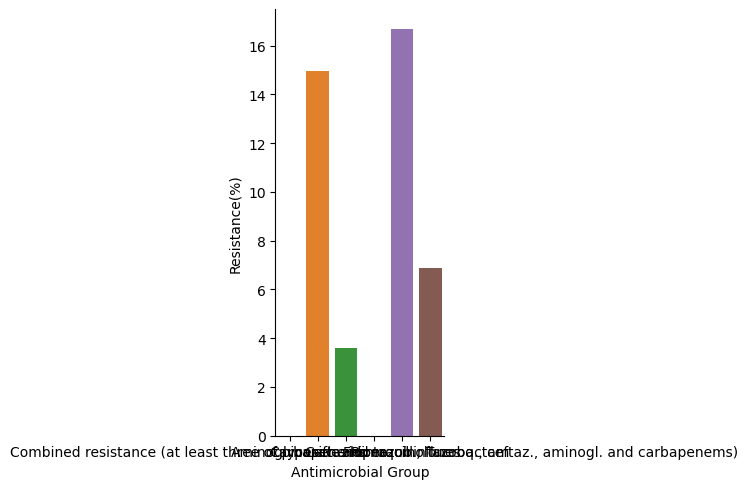

In [29]:
organism = "Pseudomonas aeruginosa"
region = "Estonia"

amr_2021_df=amr_df.query("Year == 2021 and Organism ==@organism and RegionName ==@region")

sns.catplot(x='AntimicrobialGroup', y='PercentageResistant', data=amr_2021_df, errorbar=("se"), kind='bar')
plt.xlabel('Antimicrobial Group');
plt.ylabel('Resistance(%)');


/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


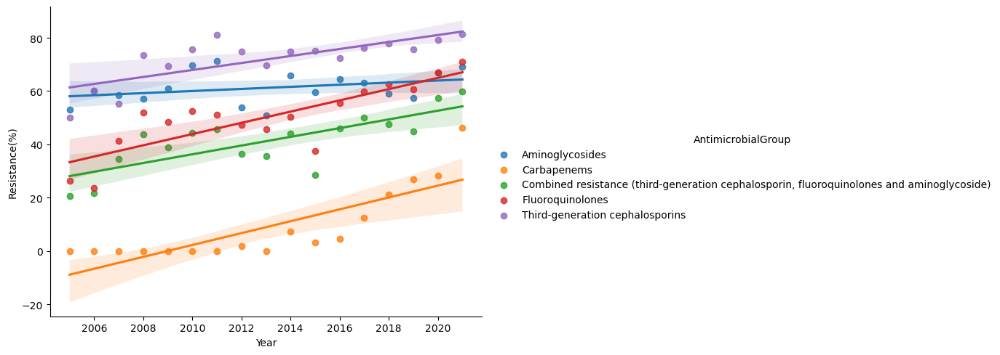

In [10]:
organism = 'Klebsiella pneumoniae' 
    
region = 'Bulgaria'
    
amr_1_df=amr_df.query("Organism ==@organism and RegionName ==@region")

sns.lmplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", aspect=1.5)
plt.xlabel("Year")
plt.ylabel("Resistance(%)")
plt.show()

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


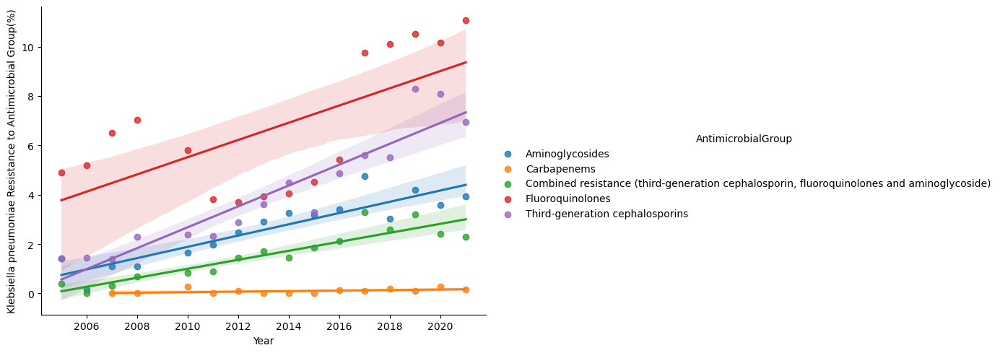

In [5]:
organism = 'Klebsiella pneumoniae' 
    
region = 'Sweden'
    
amr_1_df=amr_df.query("Organism ==@organism and RegionName ==@region")

sns.lmplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", aspect=1.5)
plt.xlabel("Year")
plt.ylabel(f"{organism} Resistance to Antimicrobial Group(%)")
plt.show()

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


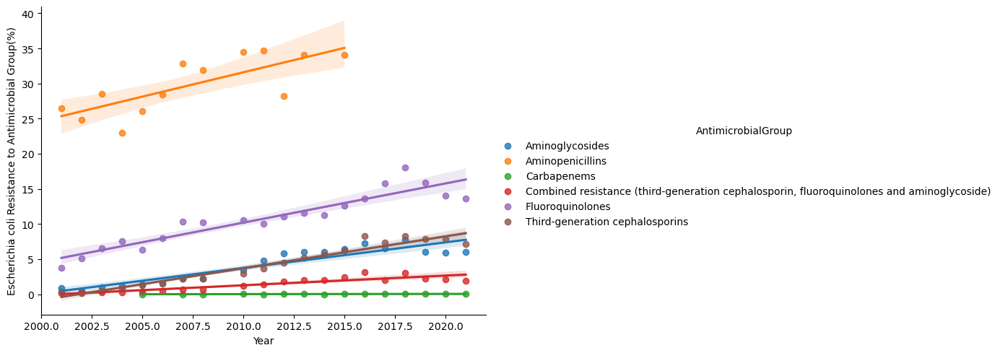

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


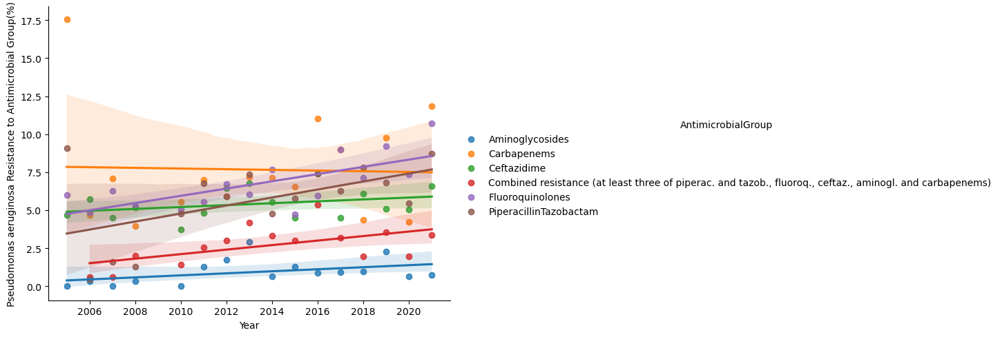

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


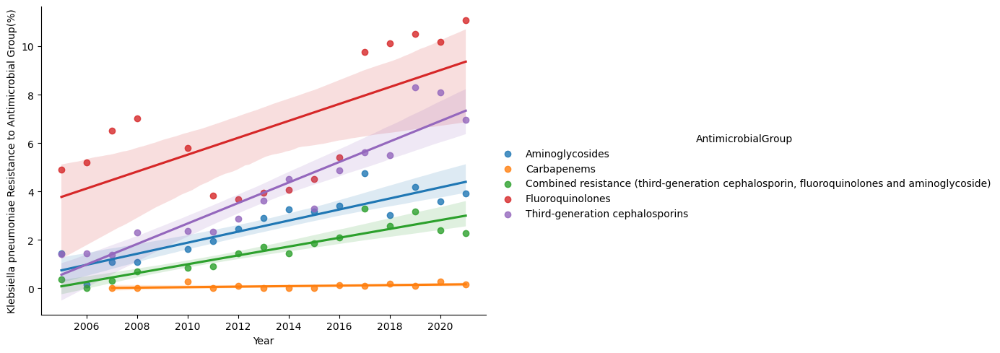

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


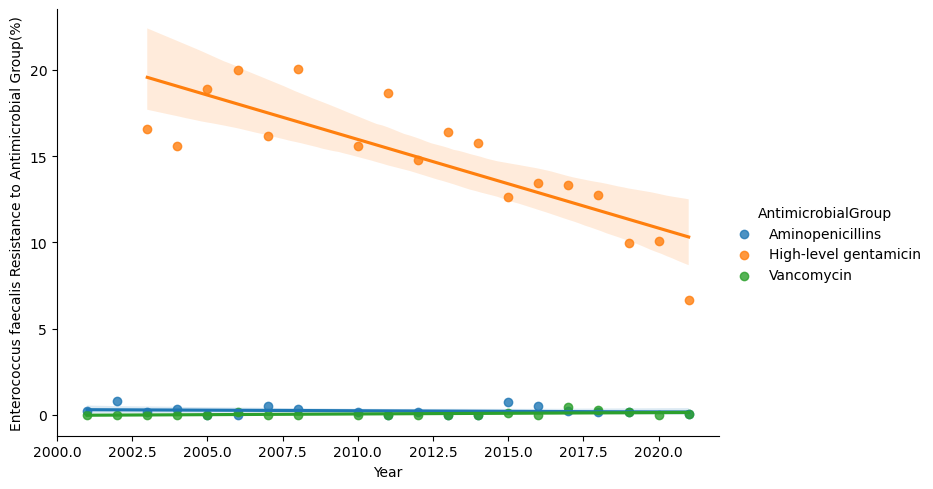

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


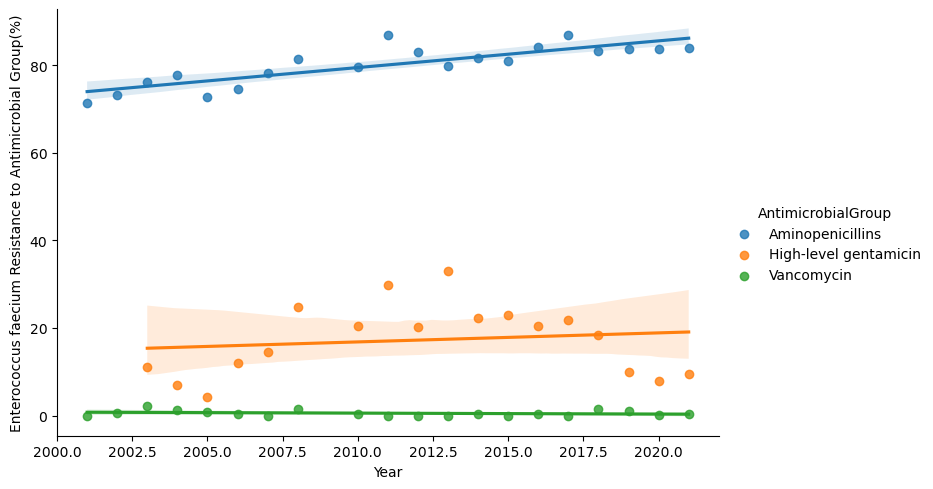

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


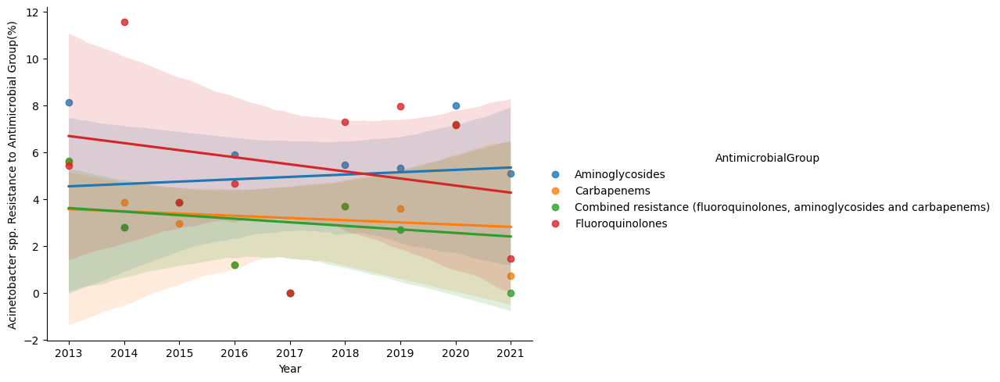

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


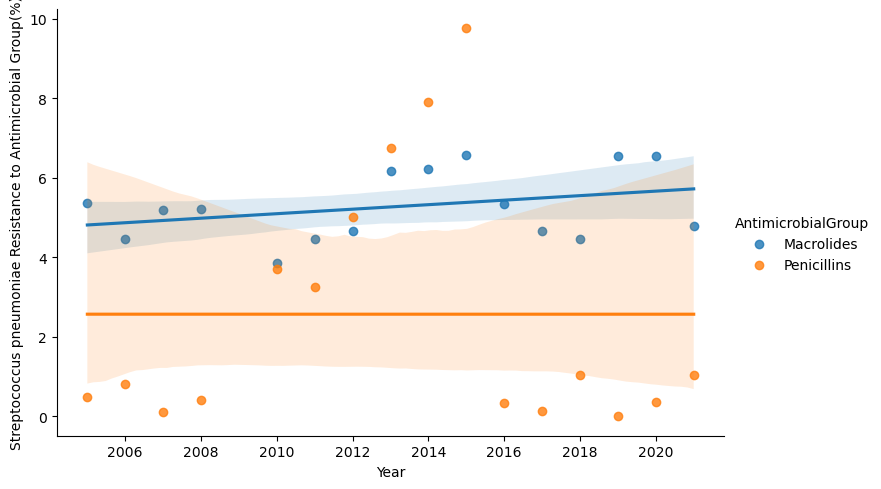

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


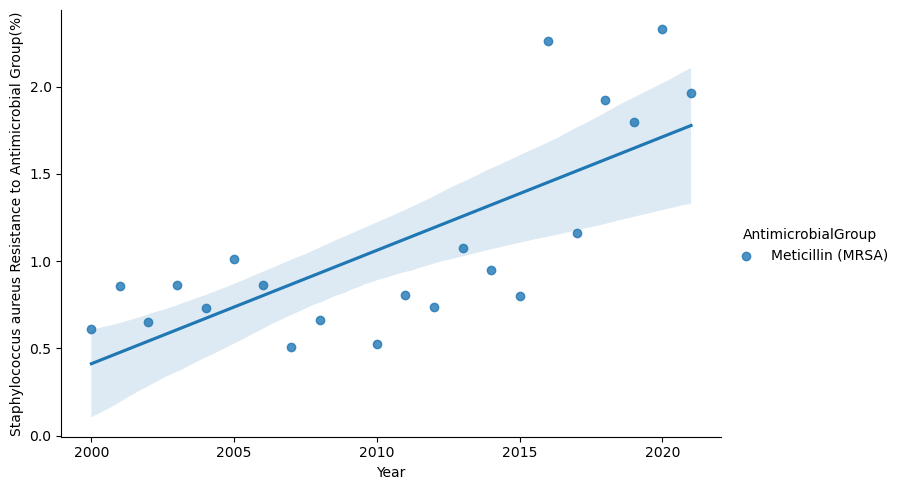

In [17]:
organism = ['Escherichia coli', 'Pseudomonas aeruginosa', 'Klebsiella pneumoniae', 'Enterococcus faecalis', 'Enterococcus faecium', 'Acinetobacter spp.', 'Streptococcus pneumoniae', 'Staphylococcus aureus']
for x in organism:
    
    region = 'Sweden'
    
    amr_1_df=amr_df.query("Organism ==@x and RegionName ==@region")

    sns.lmplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", aspect=1.5)
    plt.xlabel("Year")
    plt.ylabel(f"{x} Resistance to Antimicrobial Group(%)")
    plt.show()

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


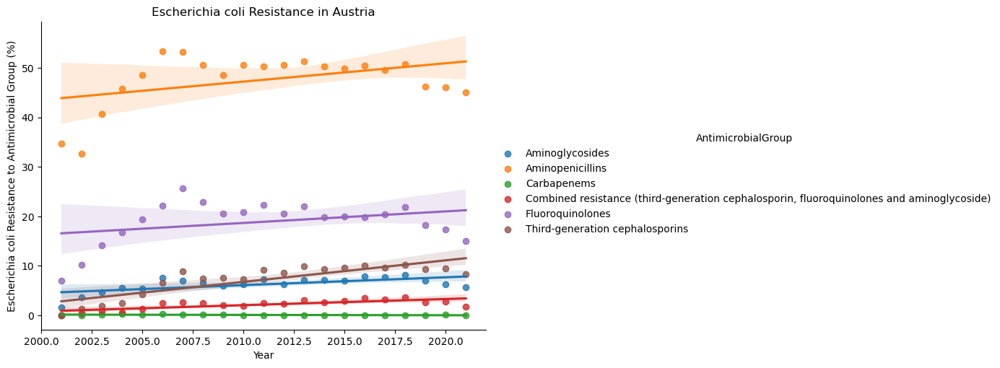

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


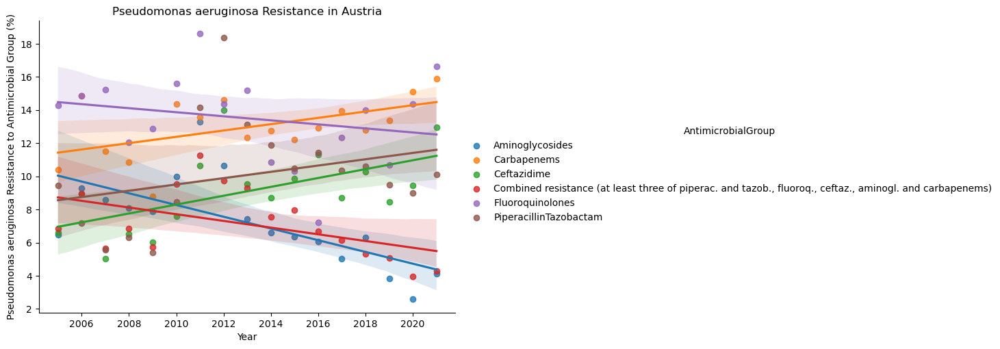

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


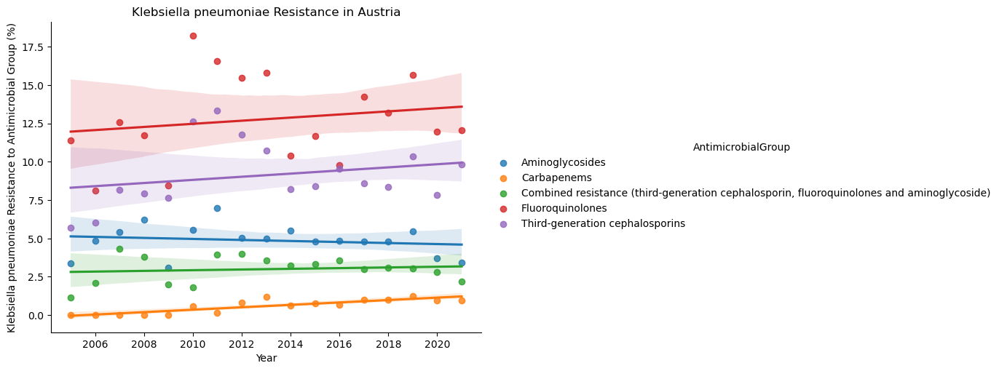

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


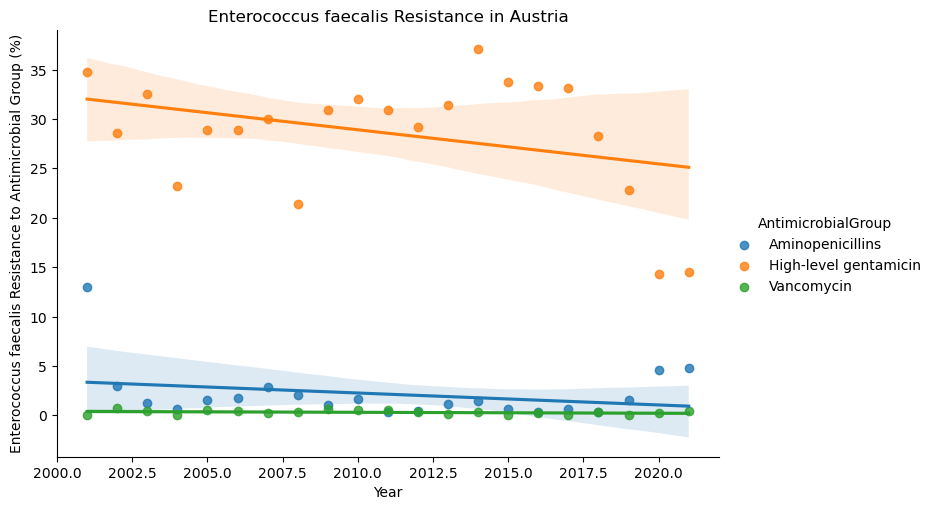

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


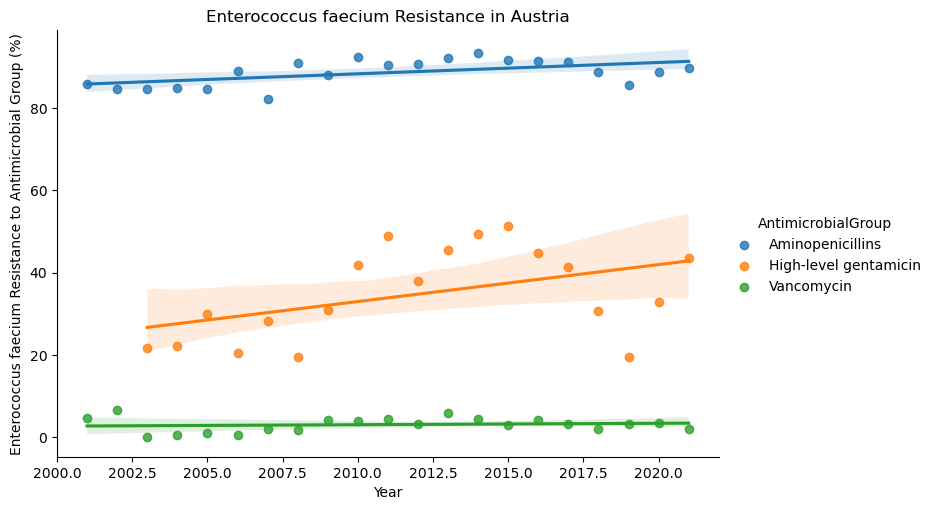

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


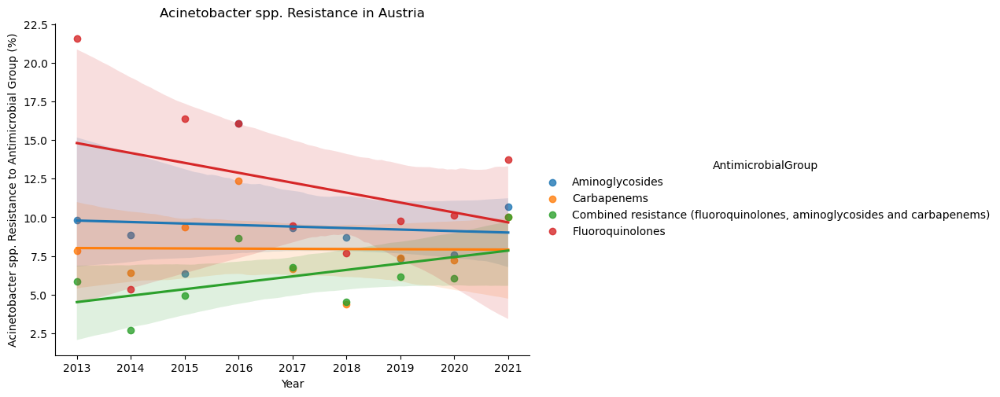

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


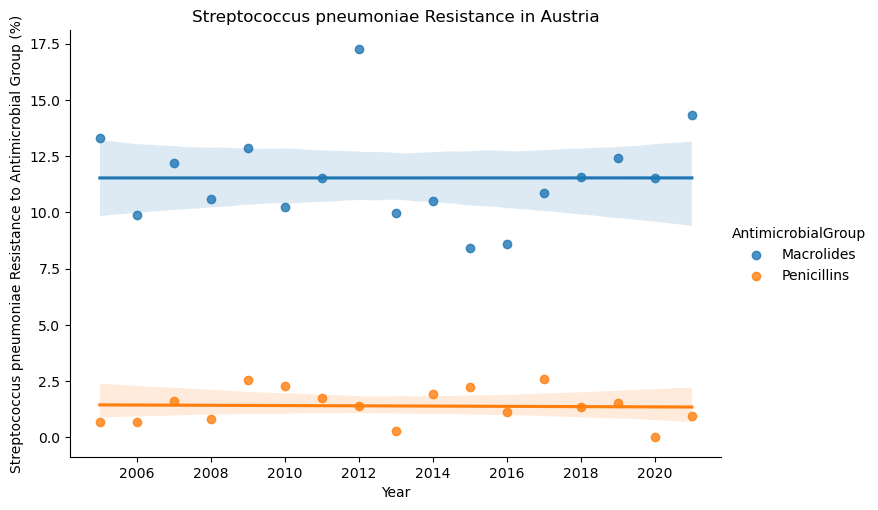

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


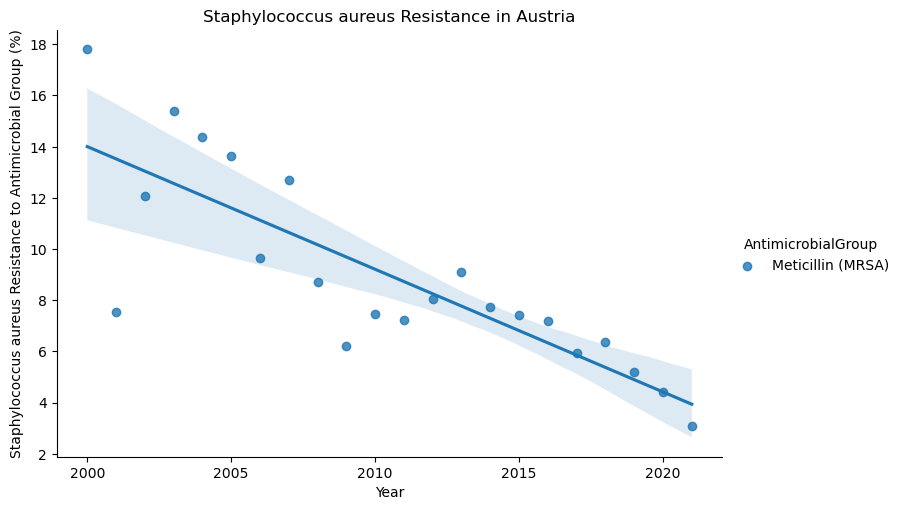

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


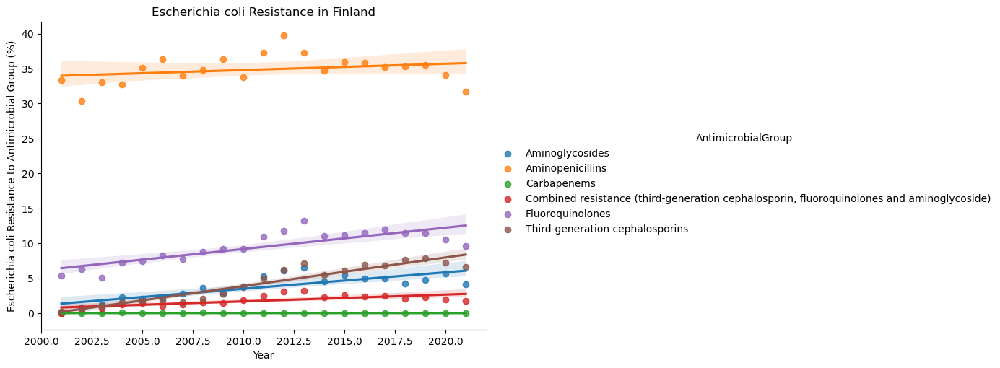

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


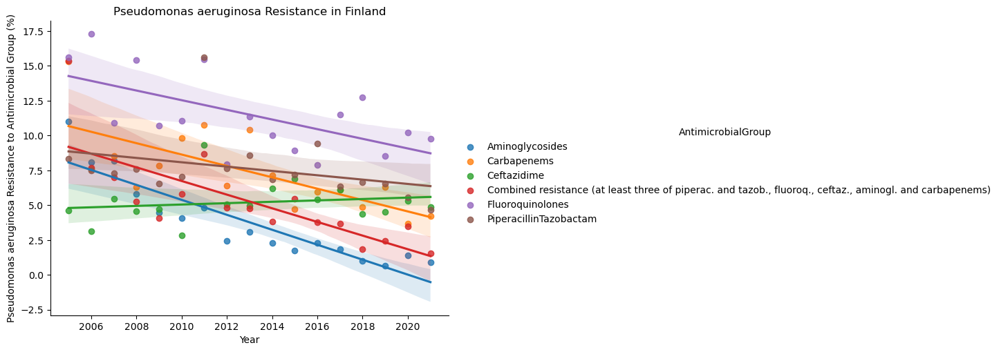

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


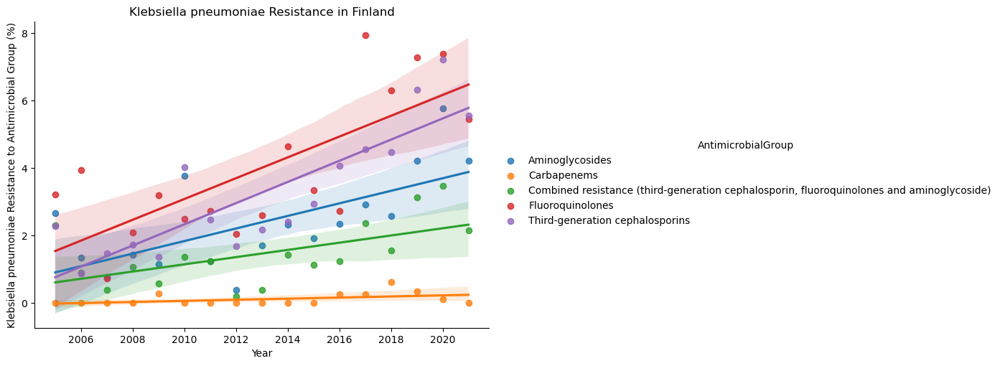

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


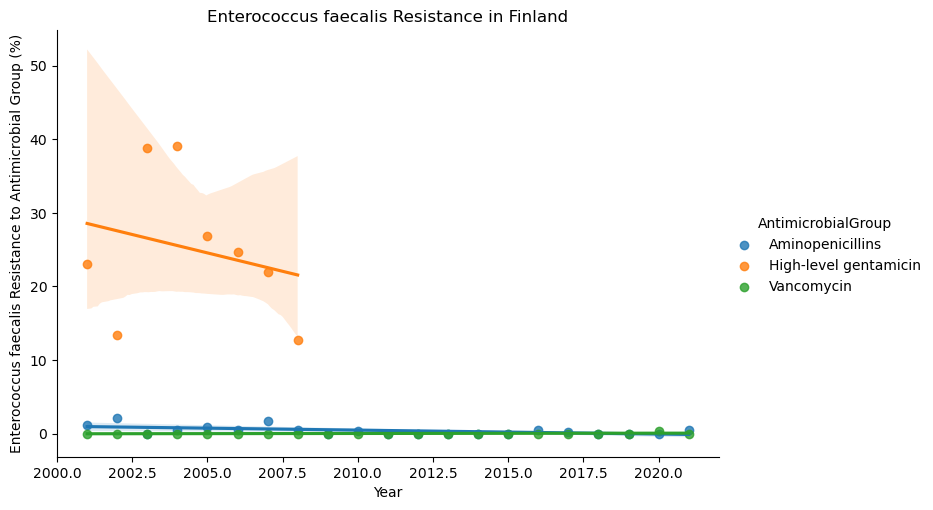

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


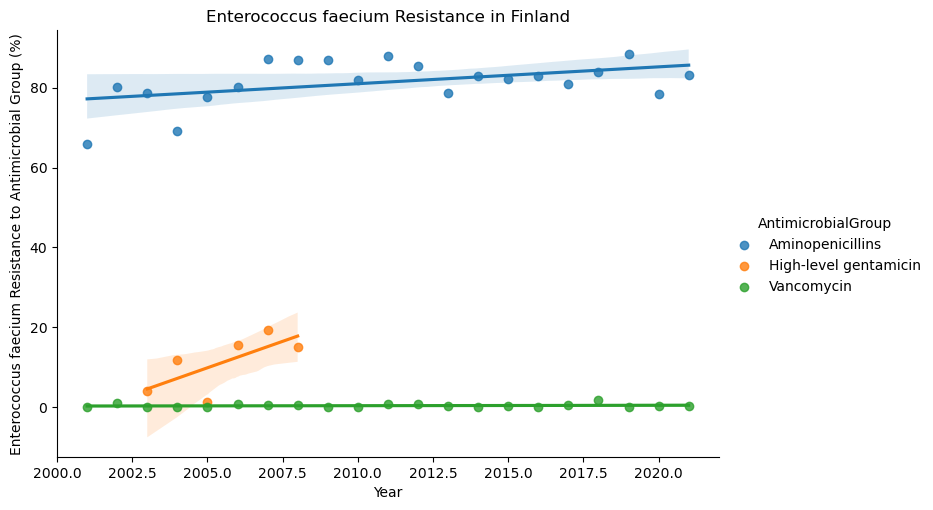

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


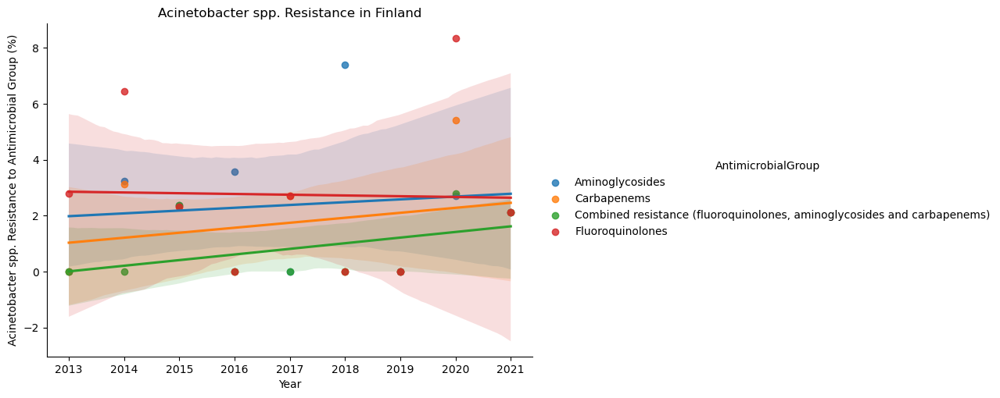

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


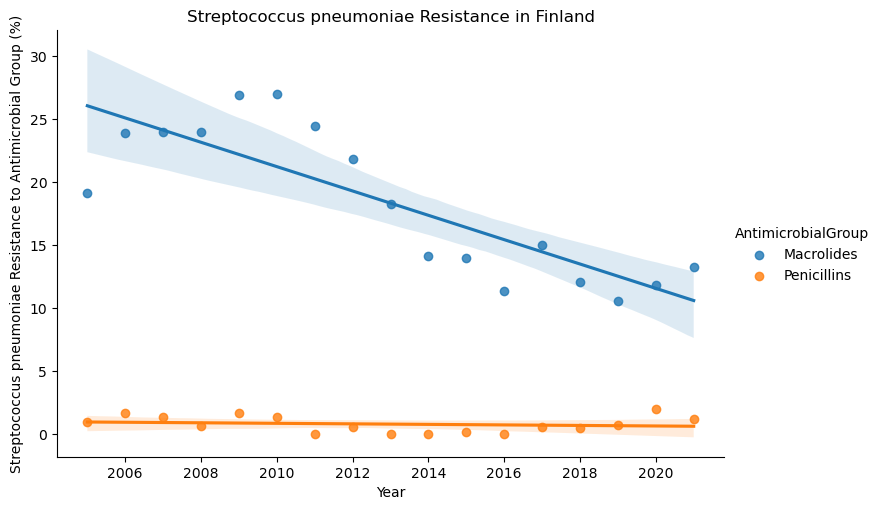

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


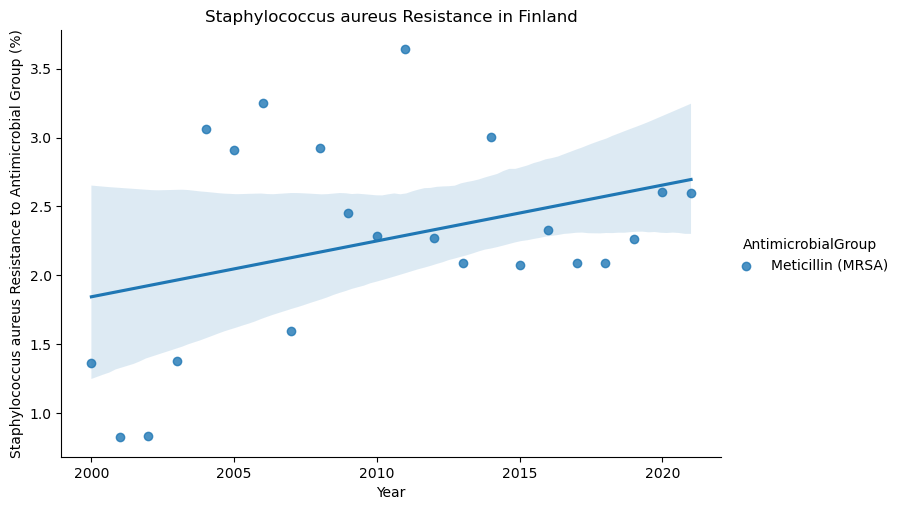

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


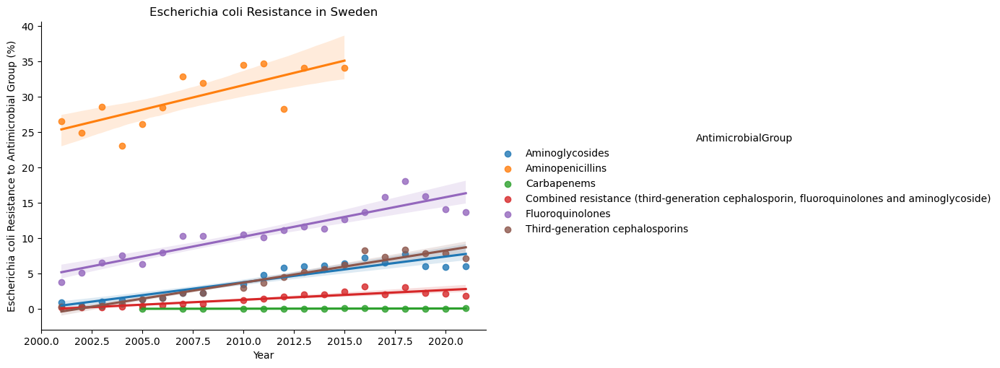

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


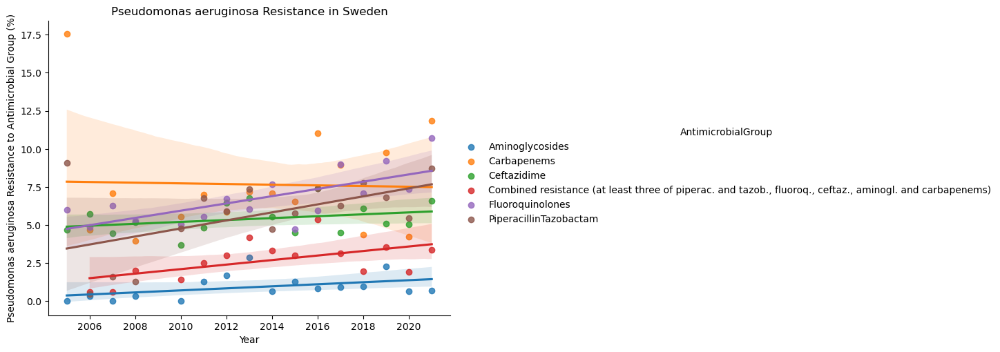

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


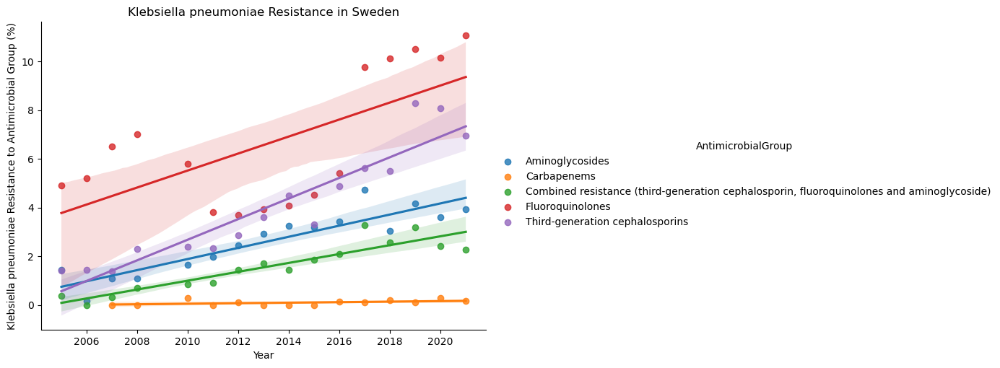

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


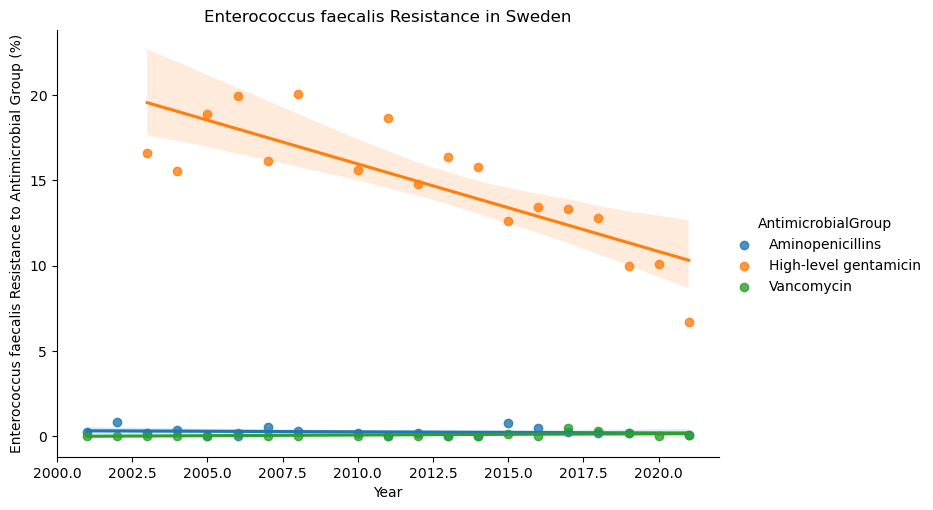

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


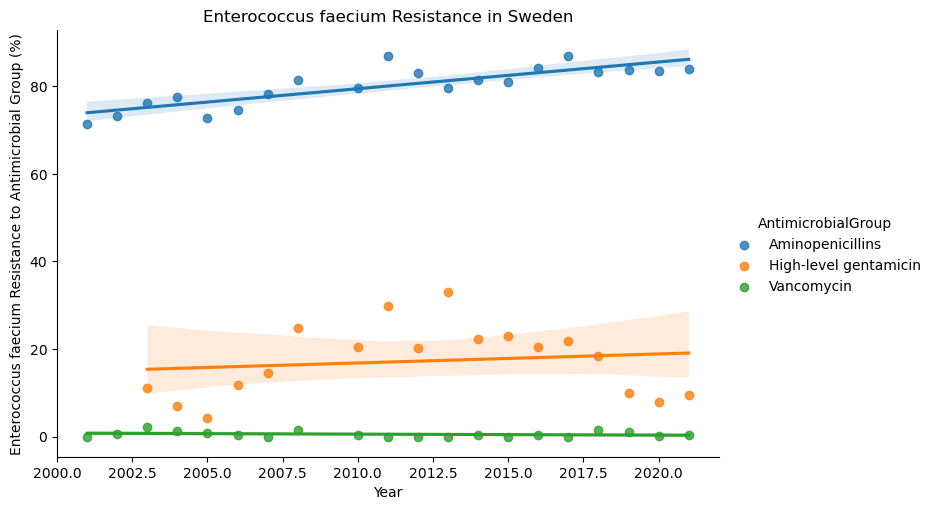

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


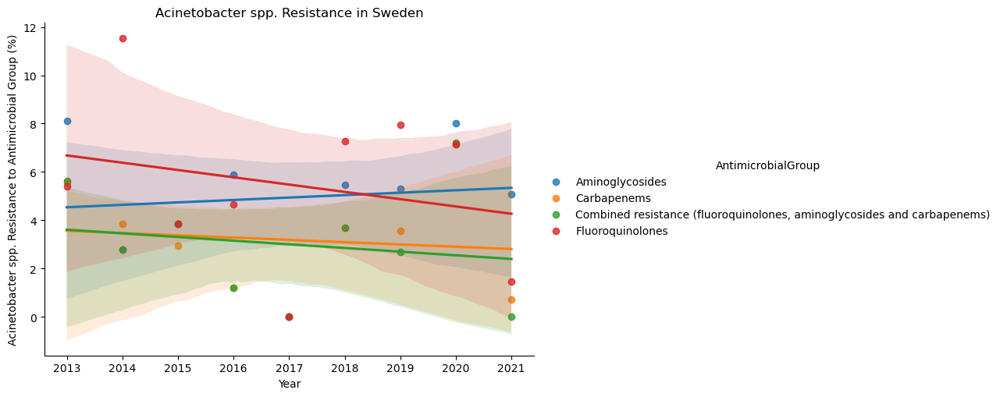

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


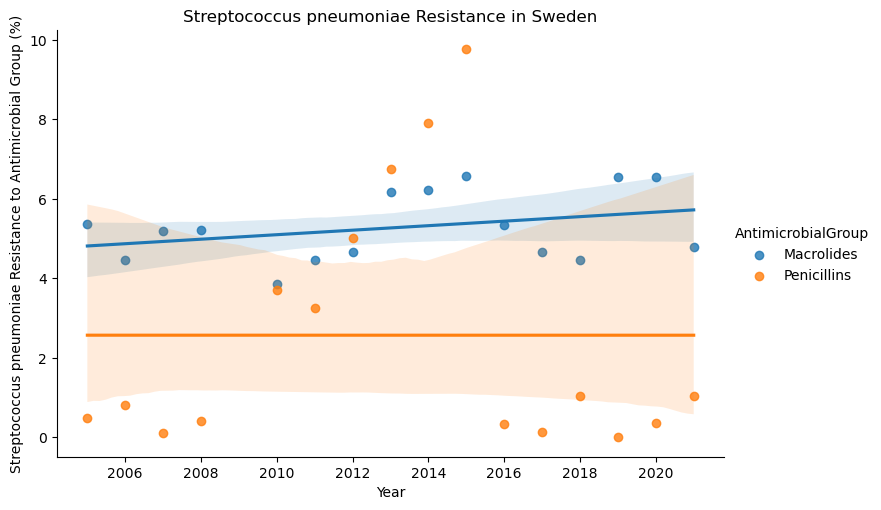

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


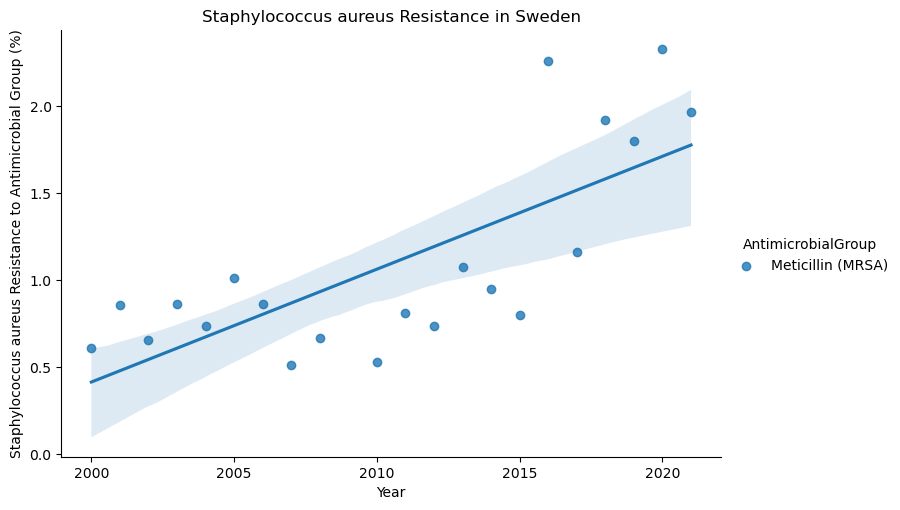

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


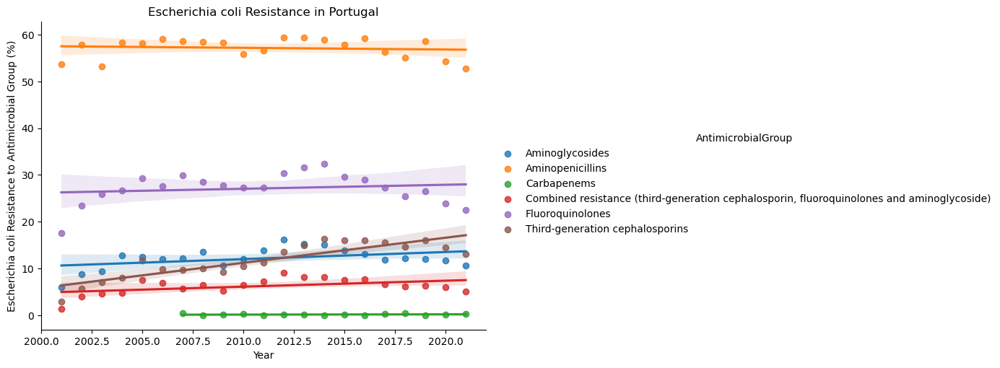

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


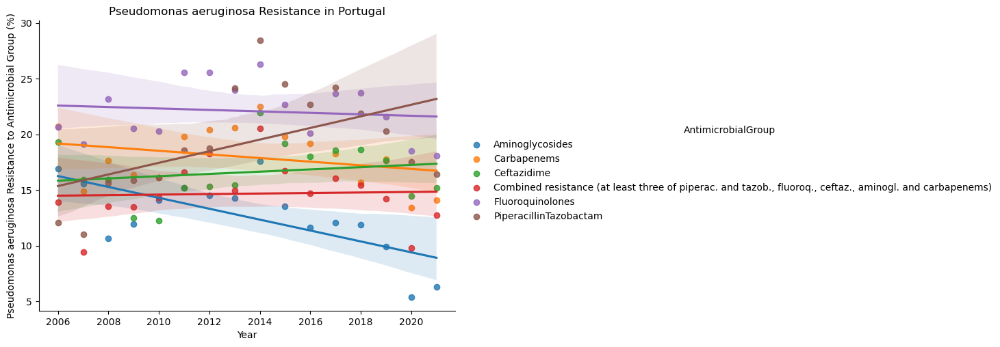

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


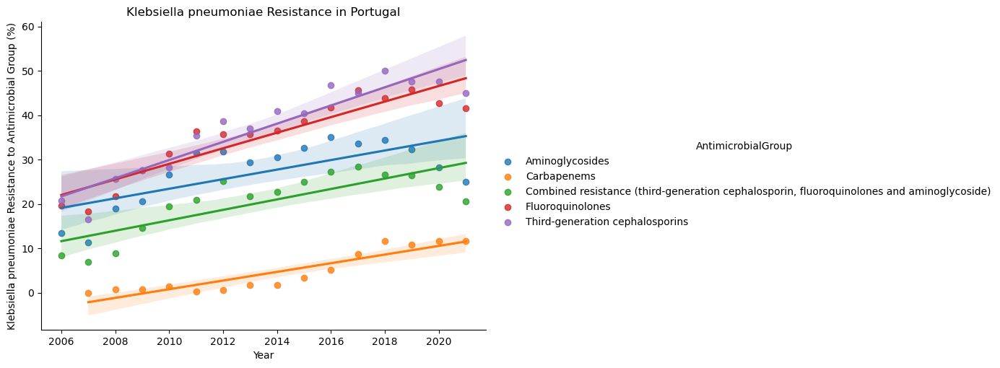

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


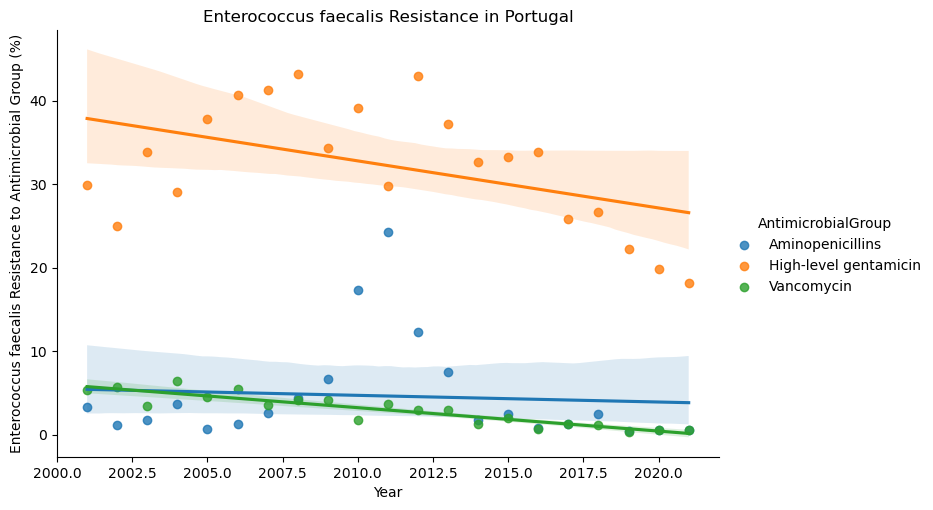

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


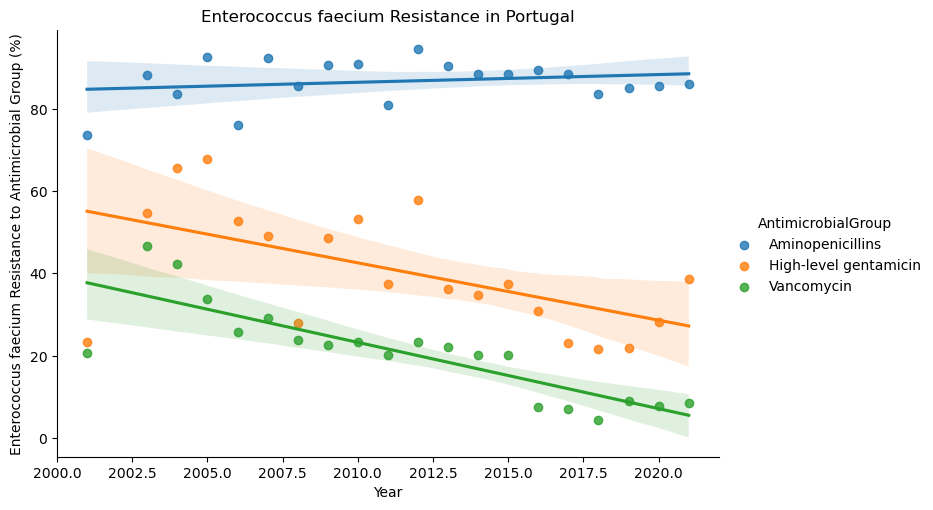

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


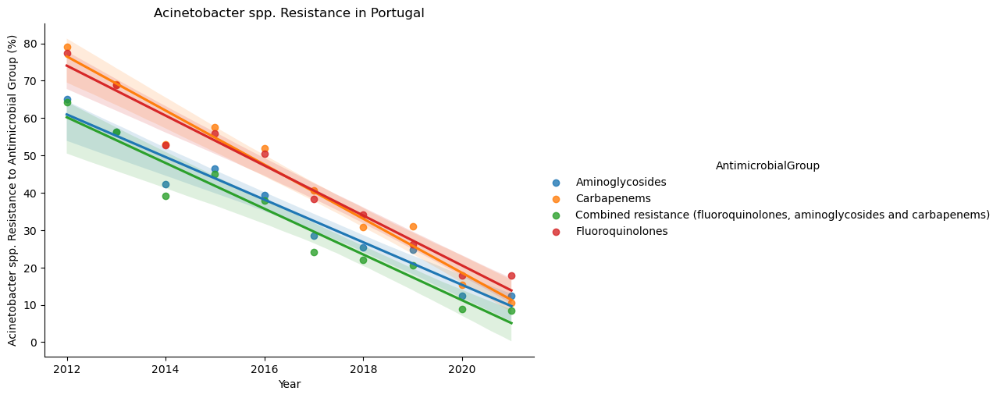

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


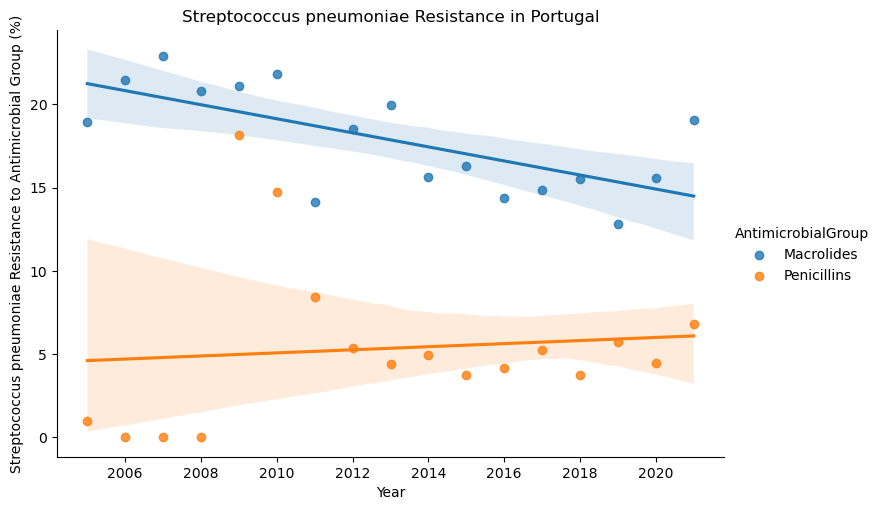

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


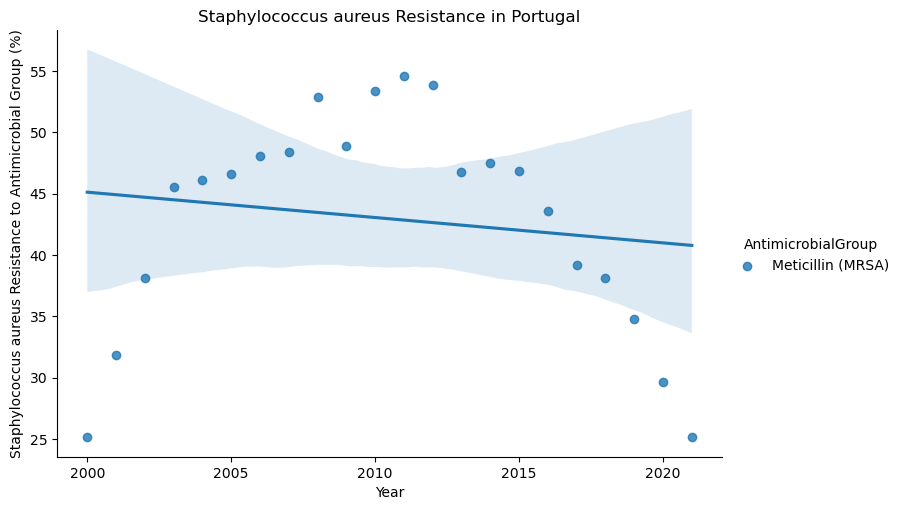

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


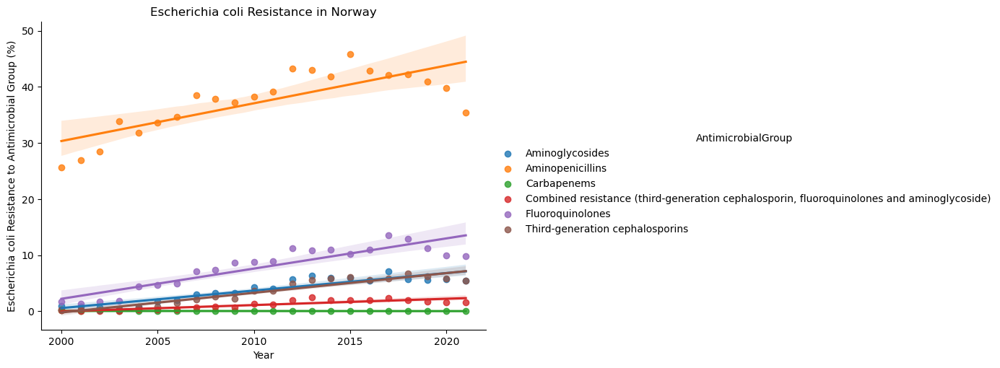

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


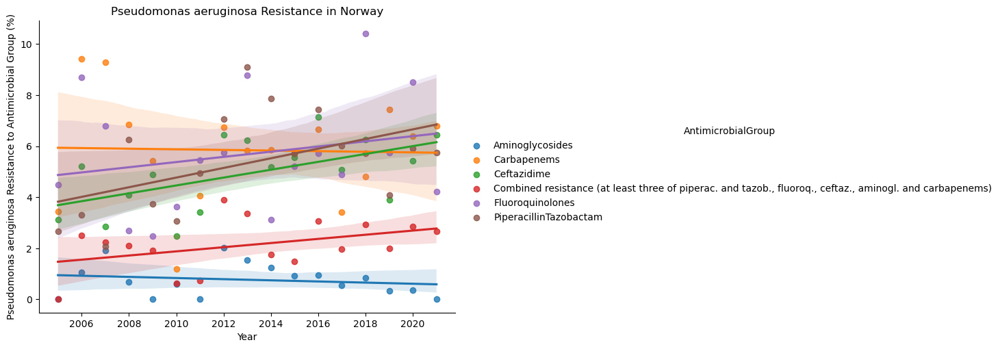

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


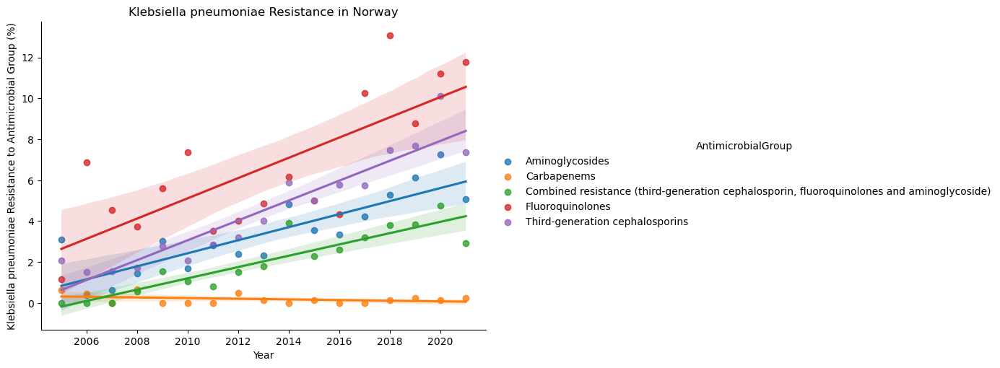

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


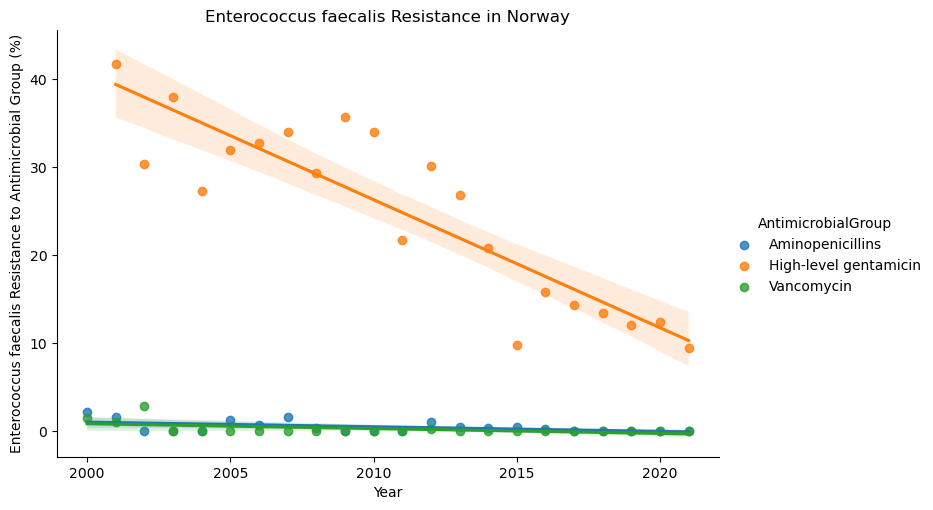

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


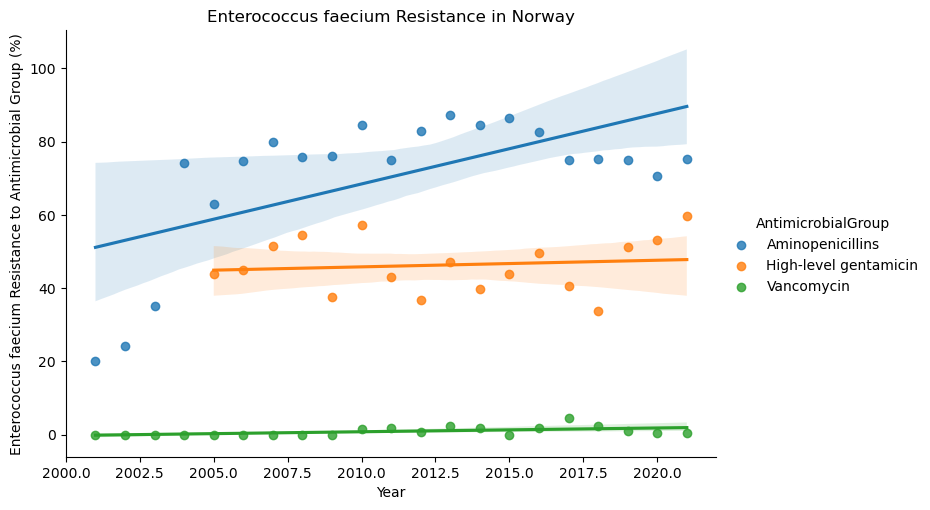

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


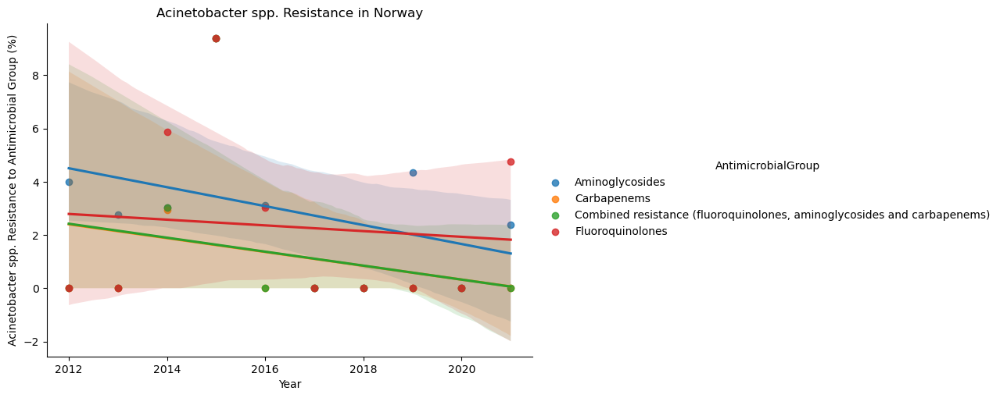

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


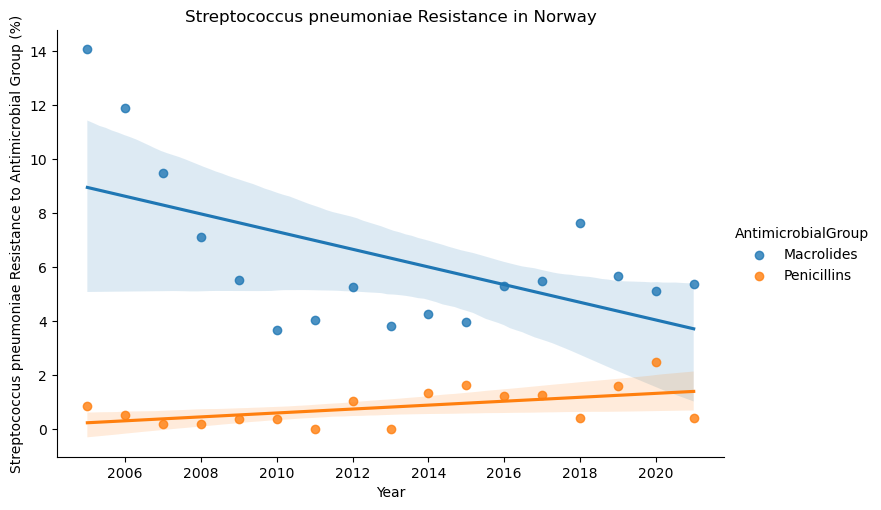

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


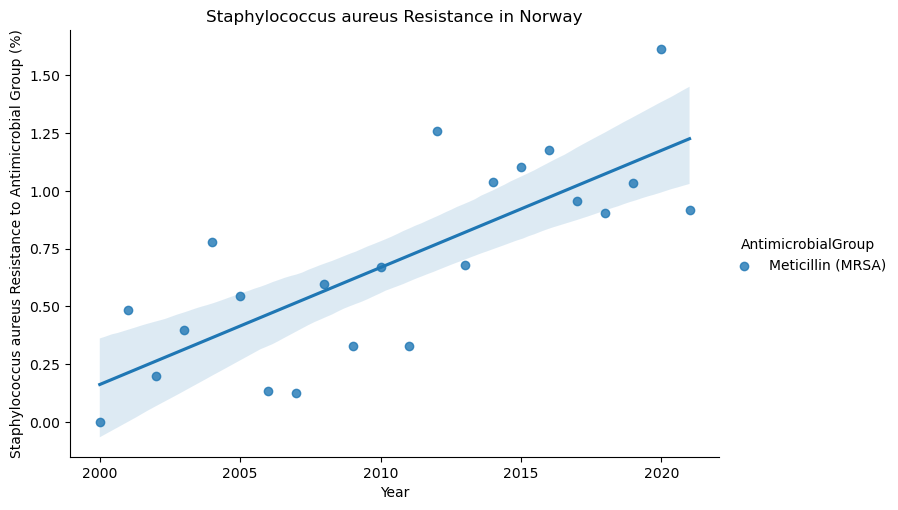

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


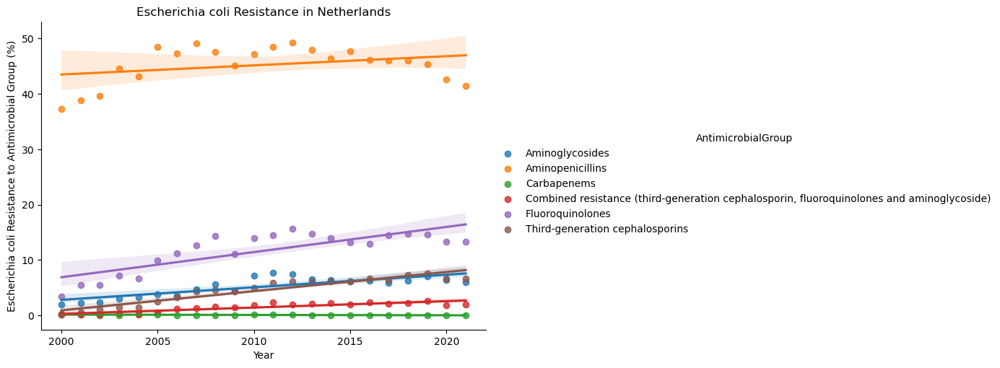

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


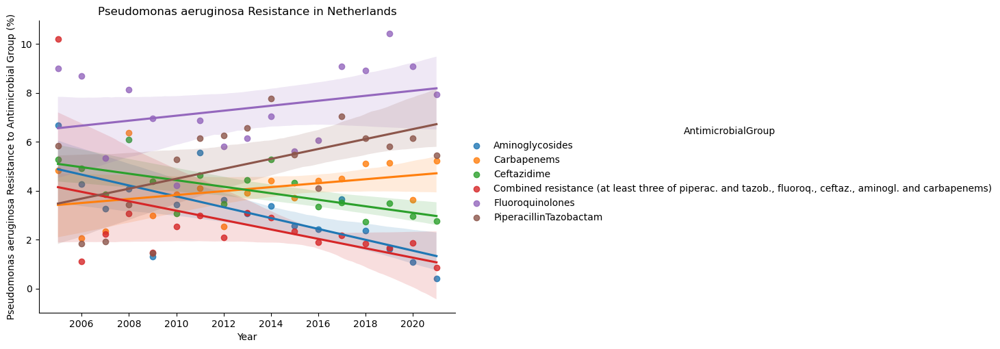

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


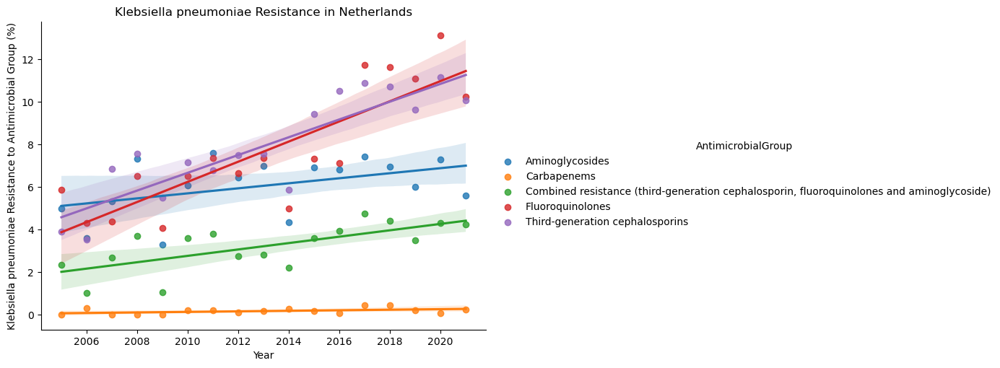

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


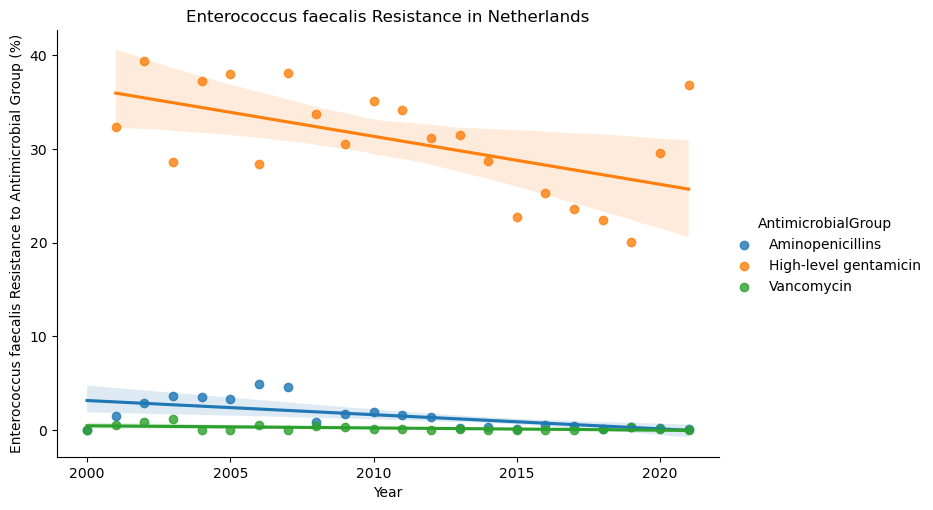

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


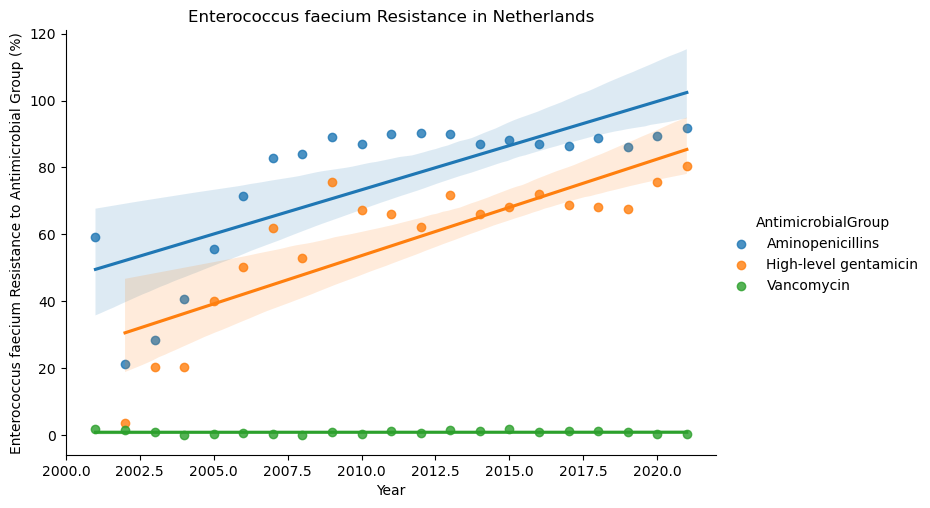

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


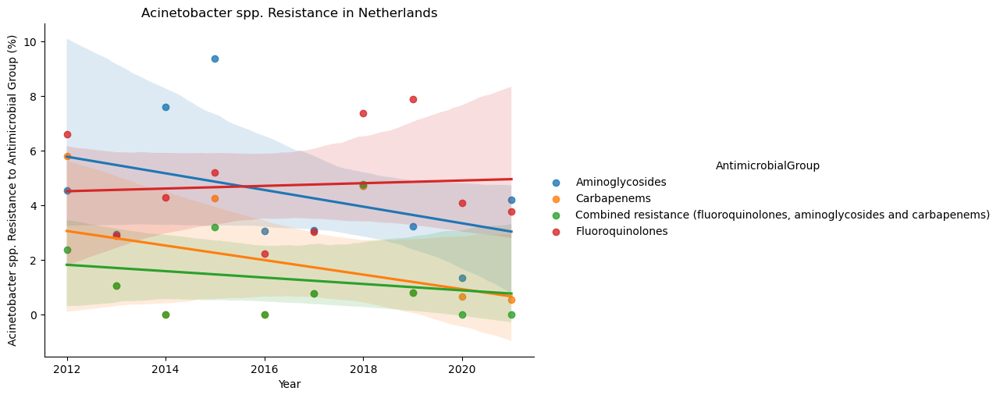

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


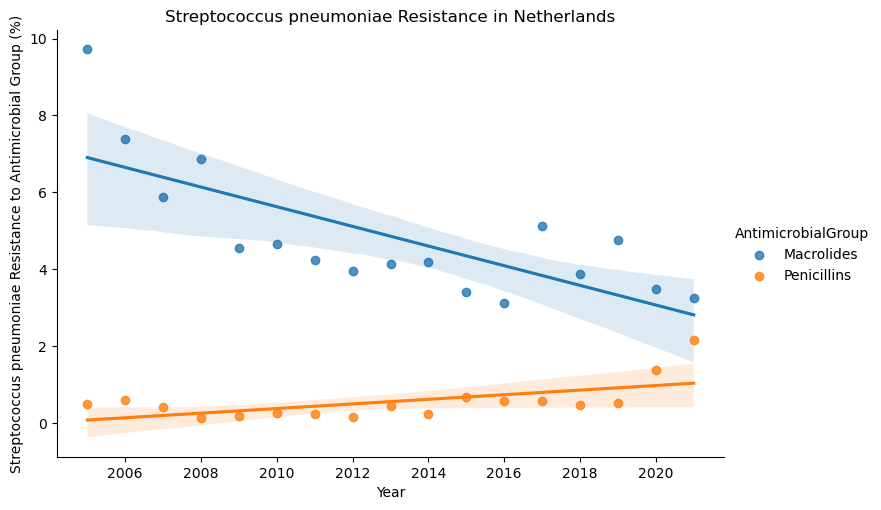

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


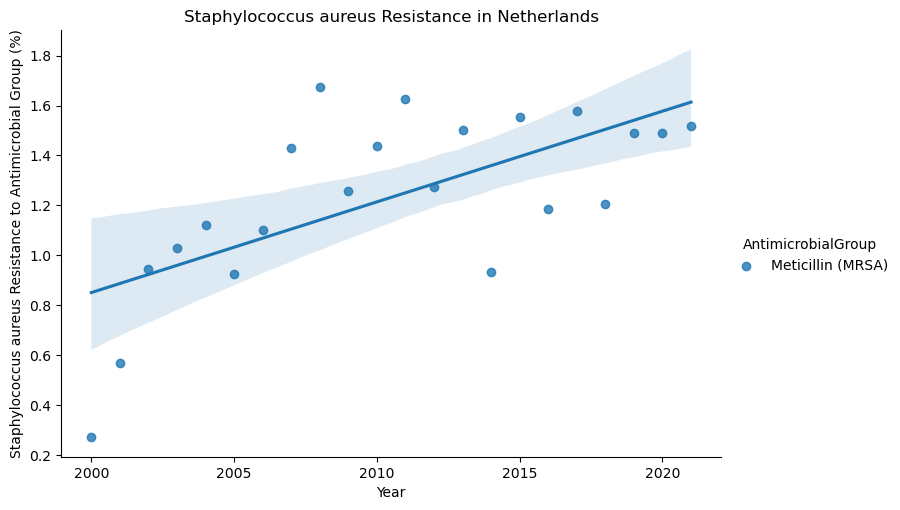

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


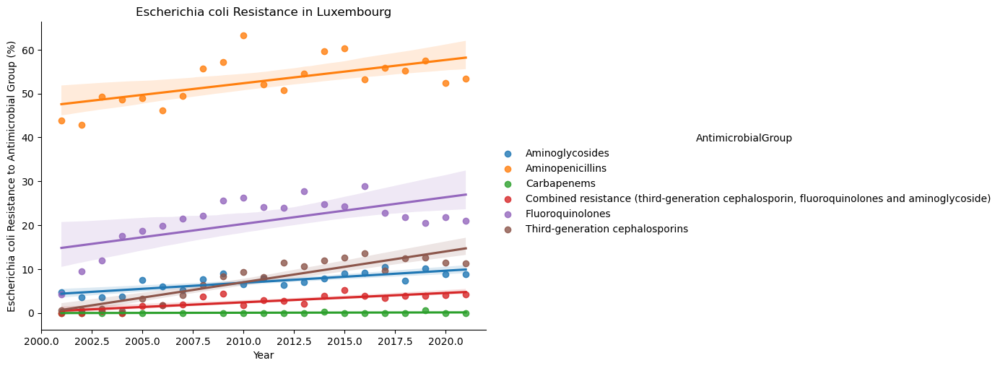

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


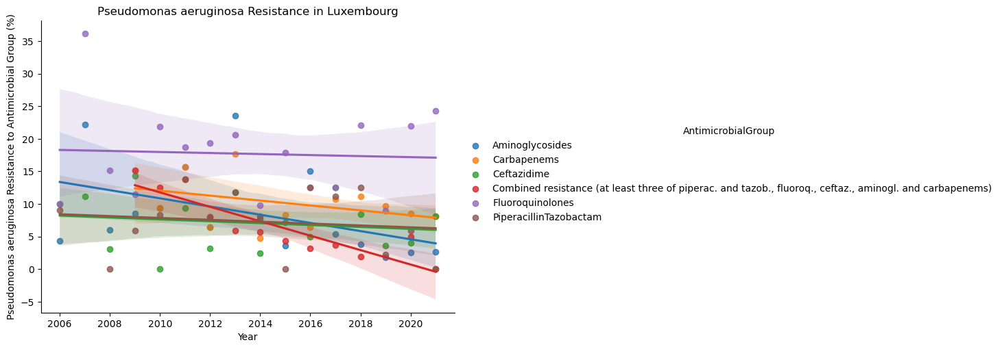

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


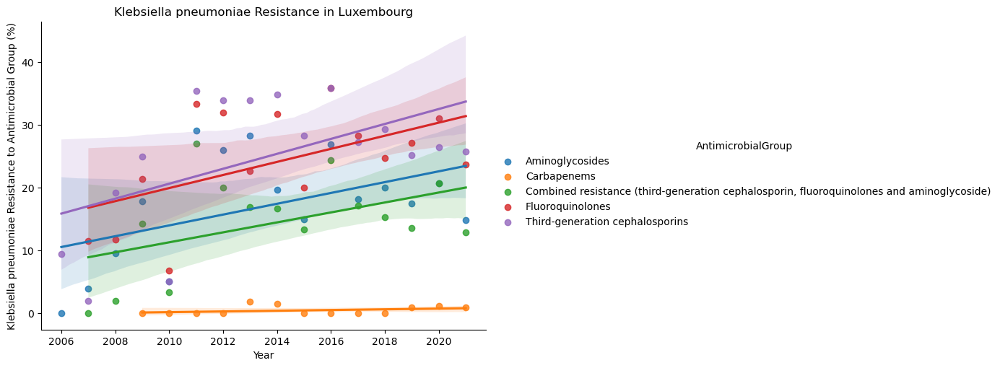

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


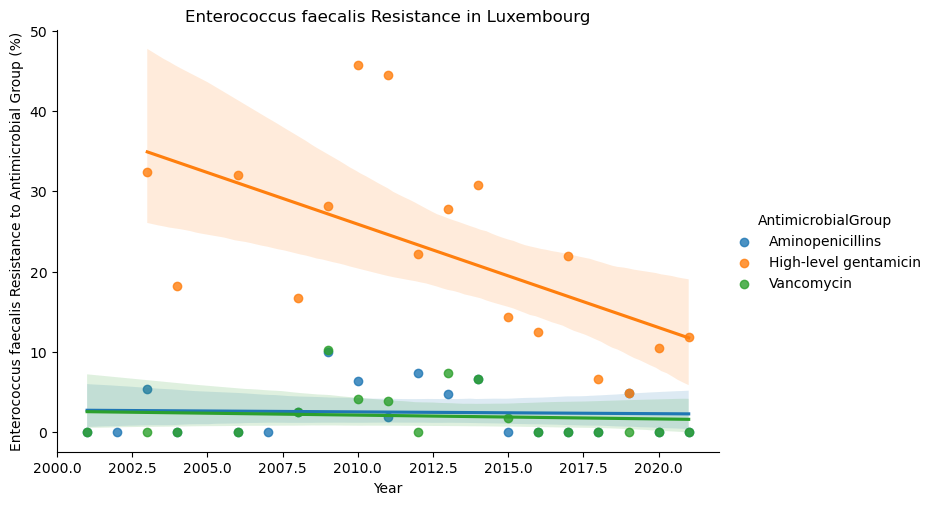

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


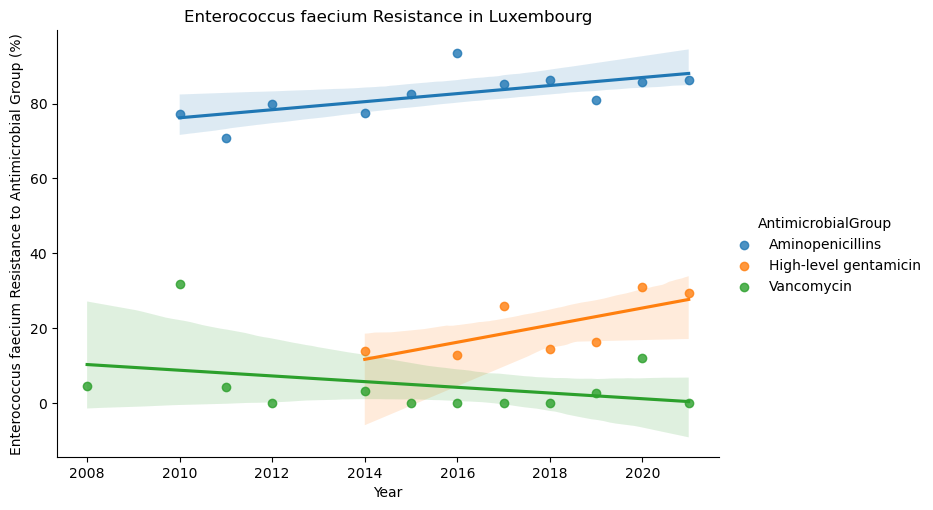

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


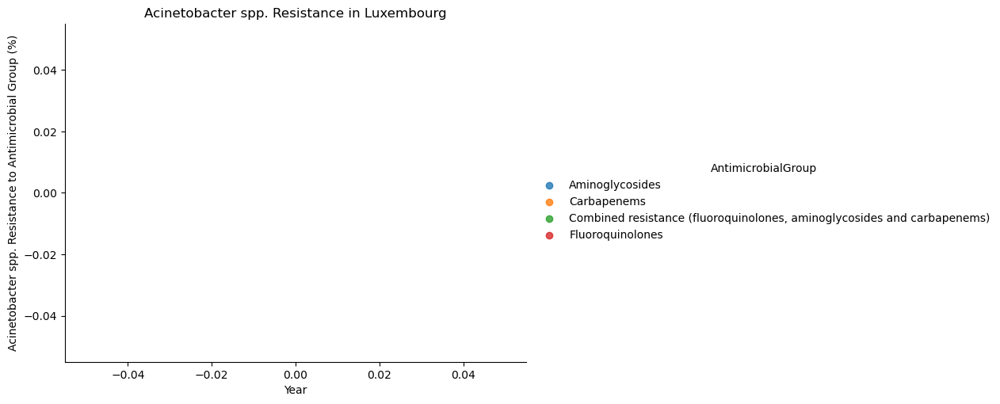

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


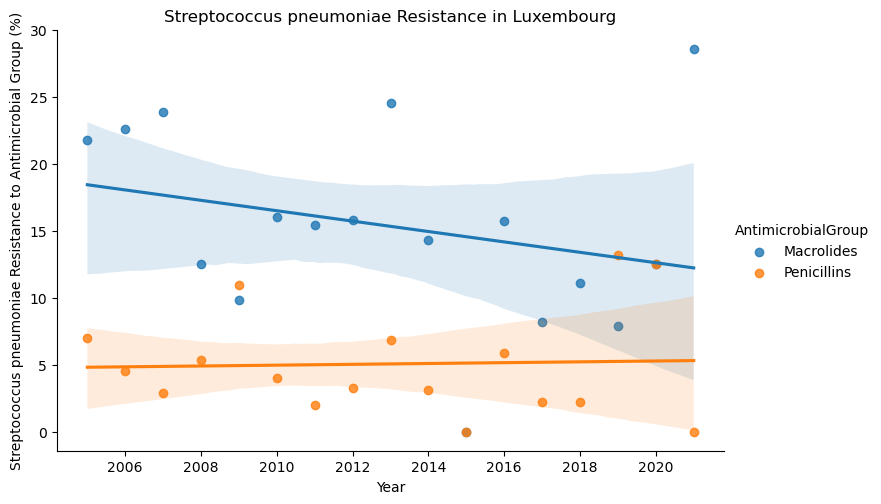

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


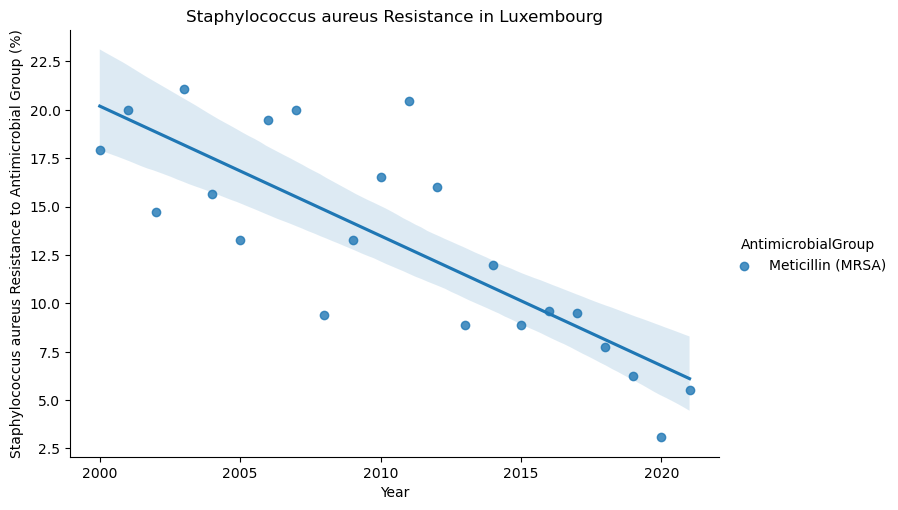

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


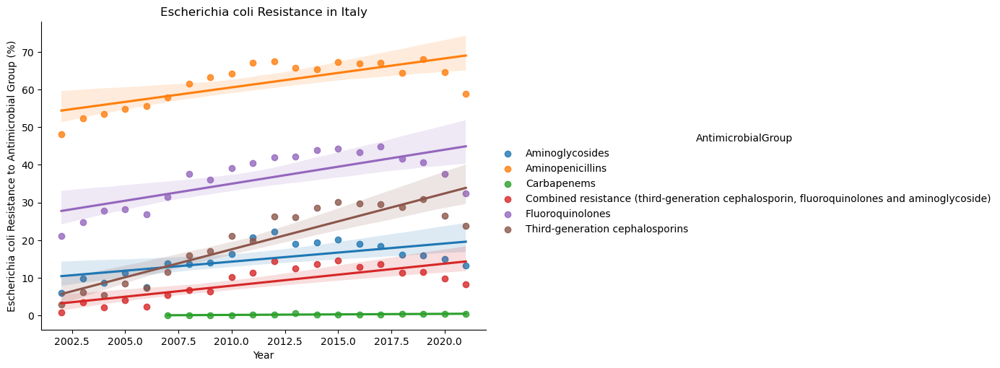

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


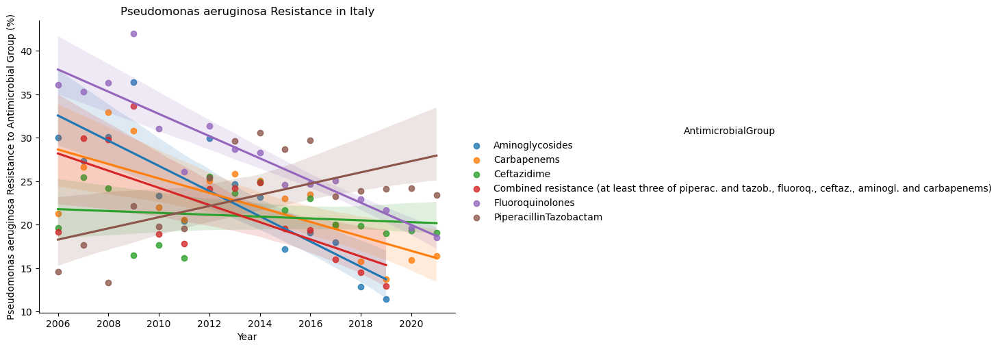

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


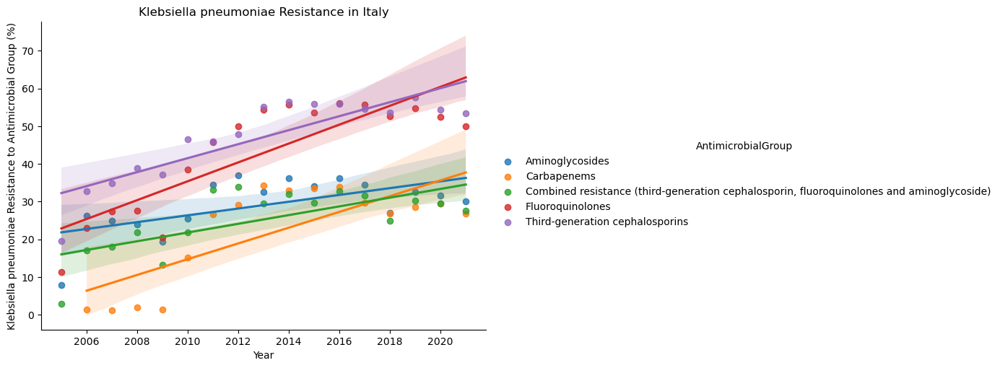

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


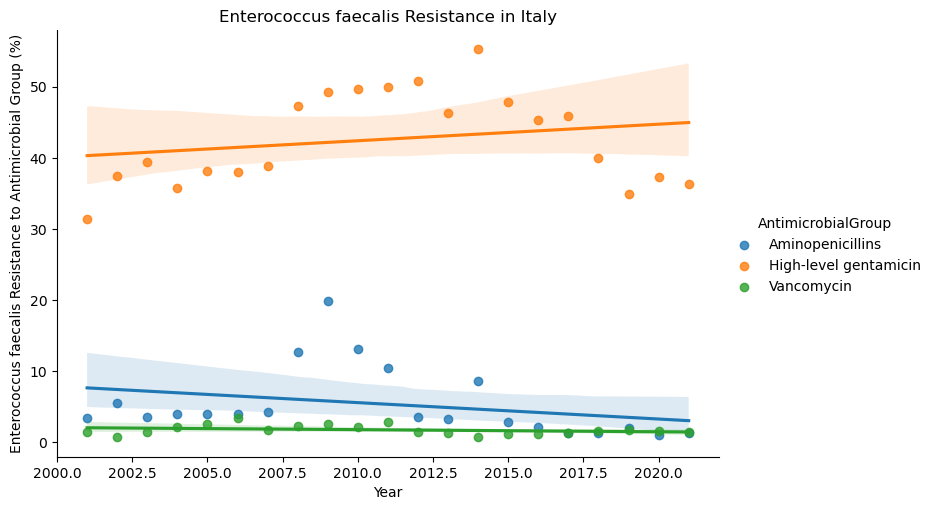

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


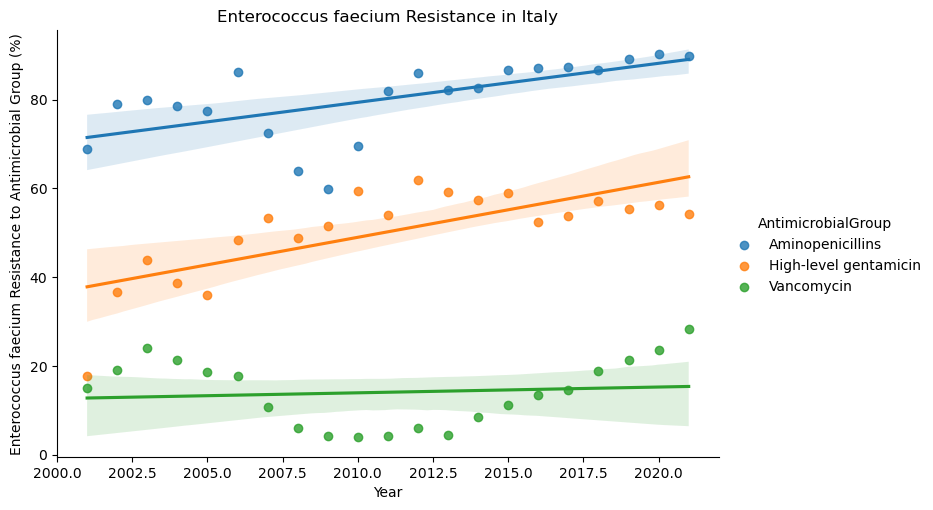

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


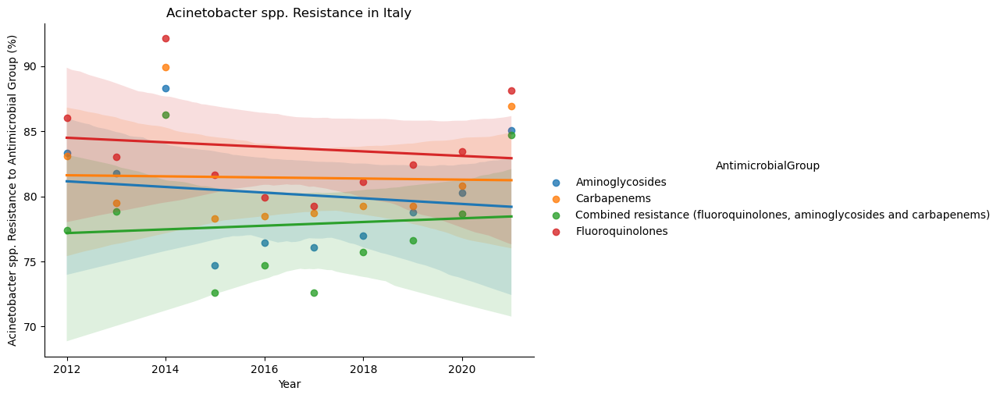

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


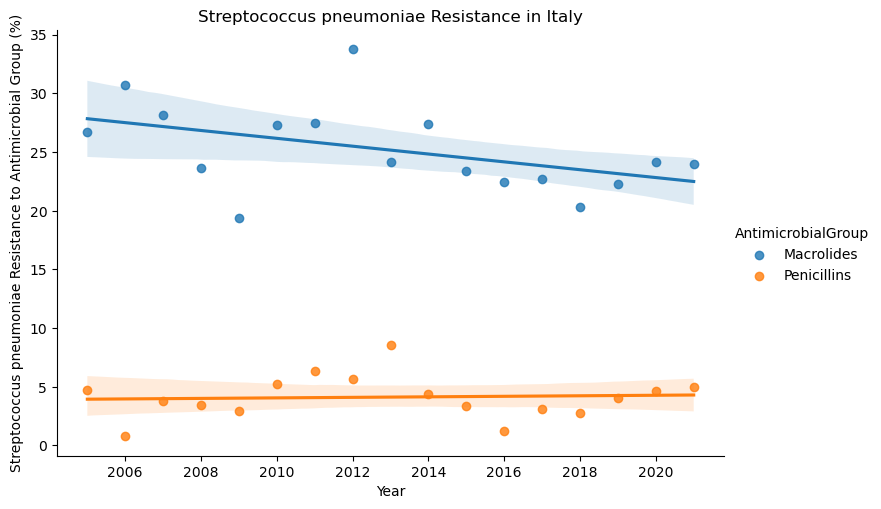

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


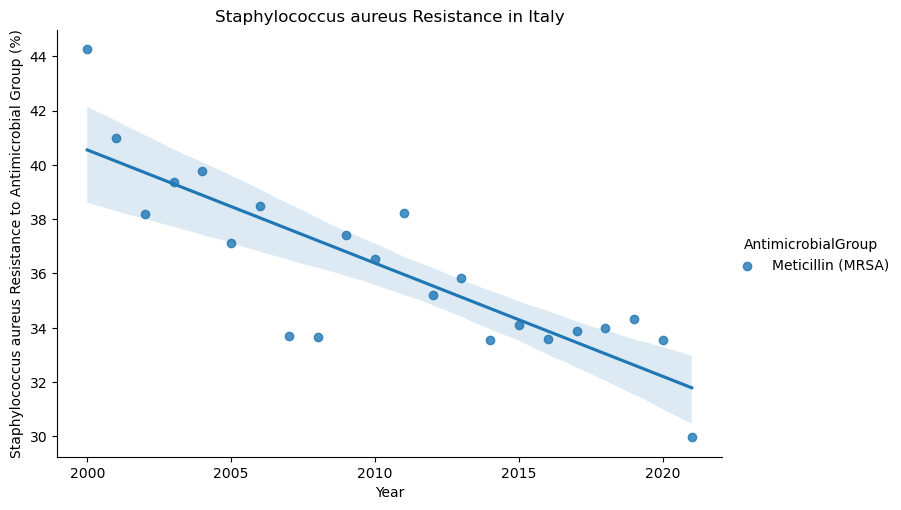

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


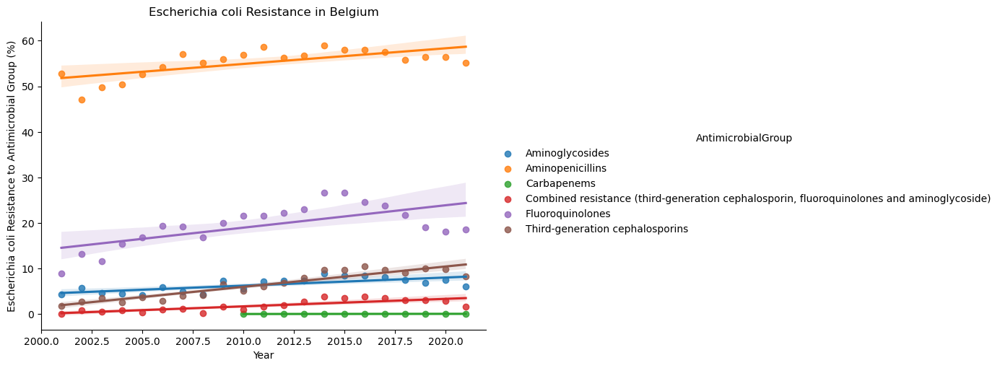

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


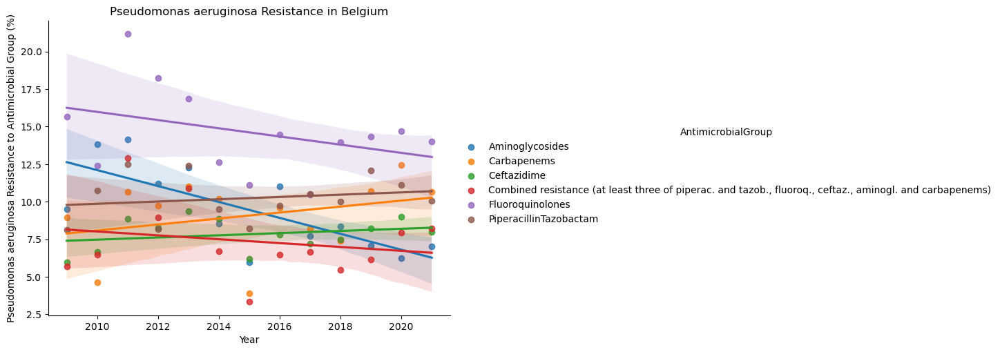

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


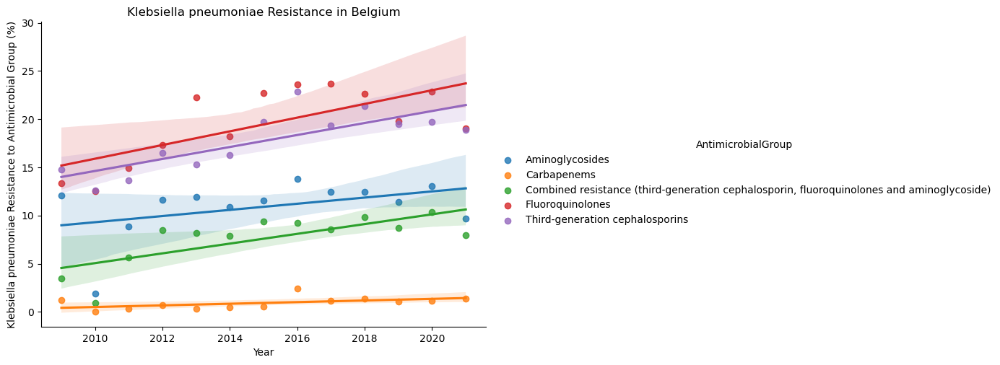

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


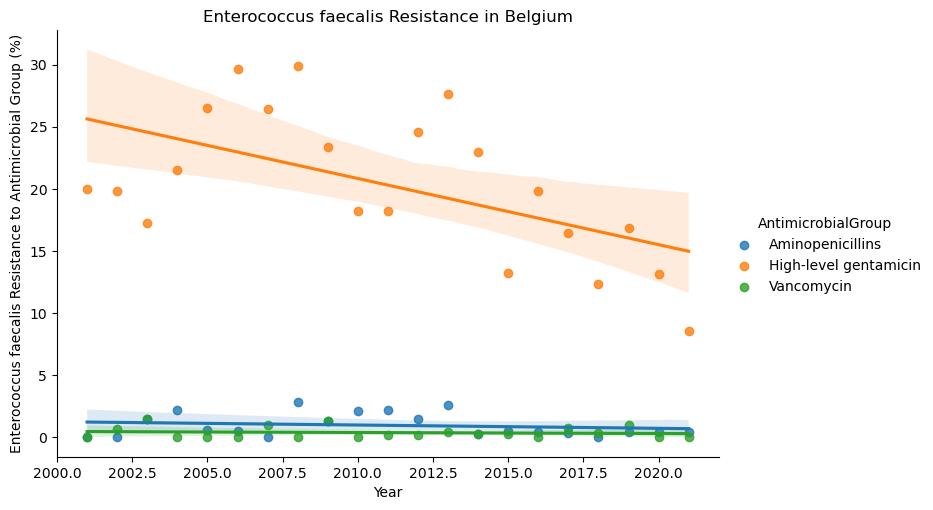

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


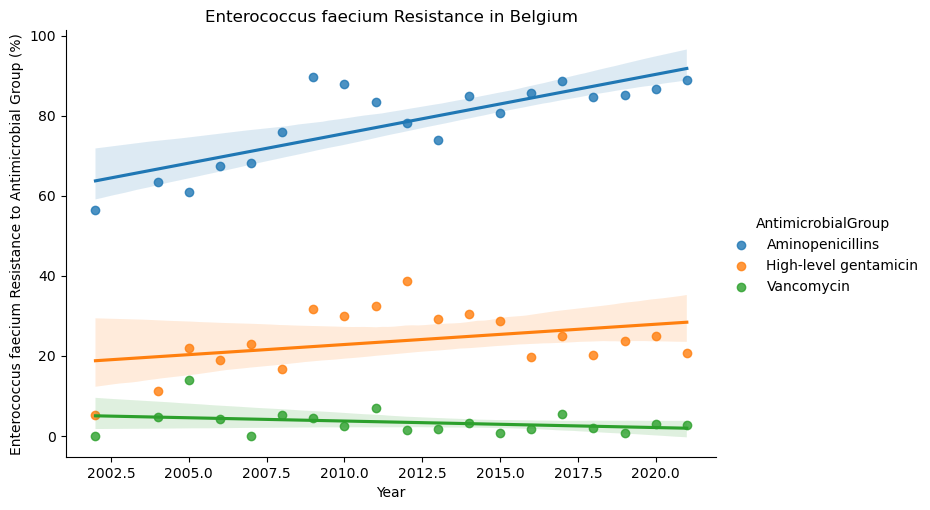

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


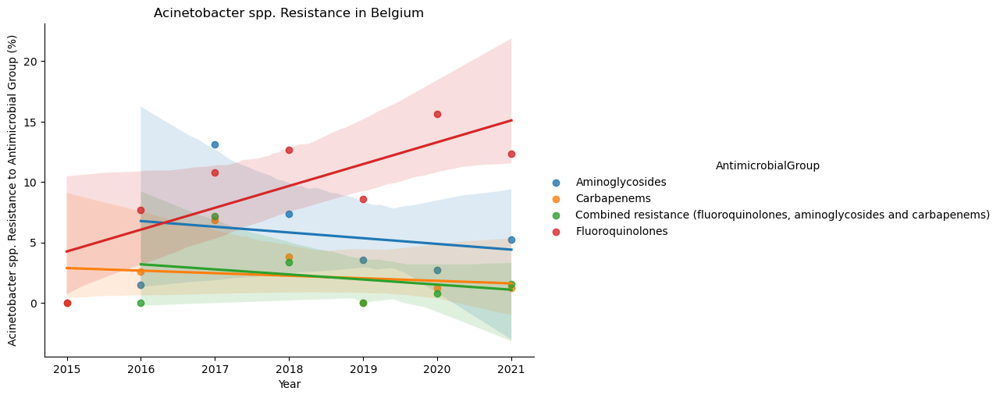

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


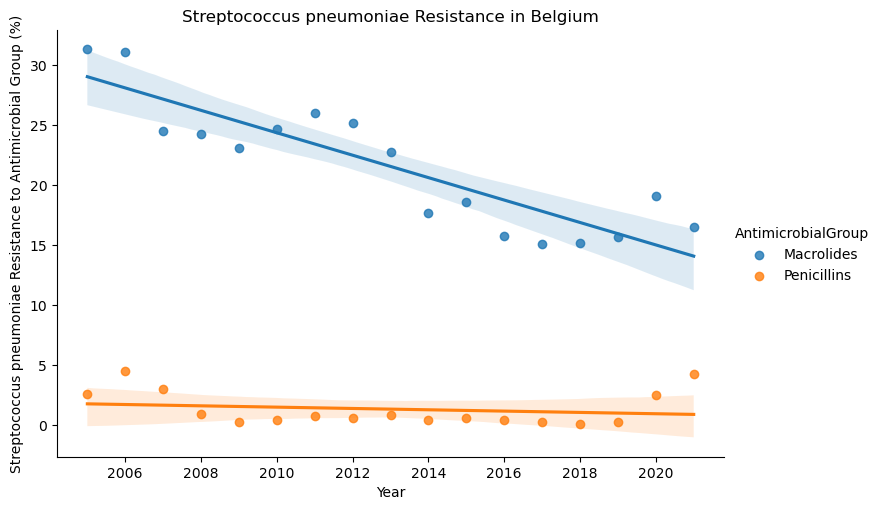

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


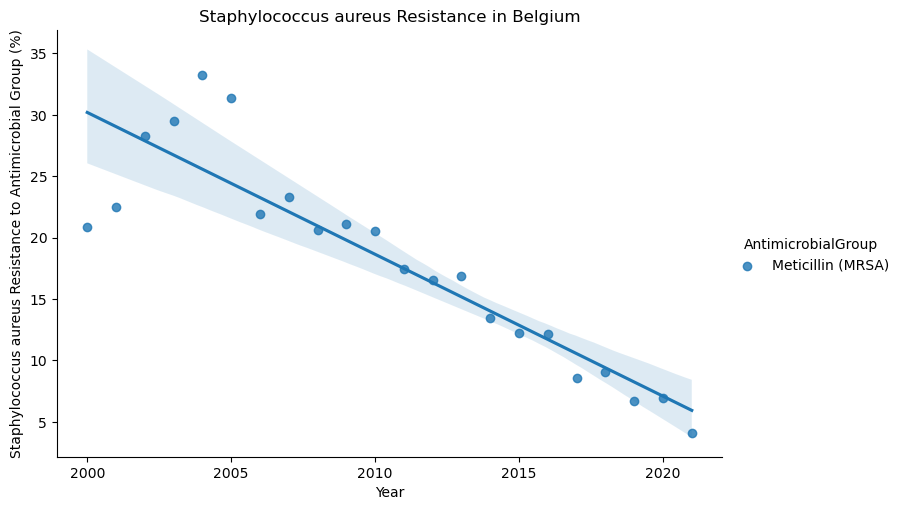

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


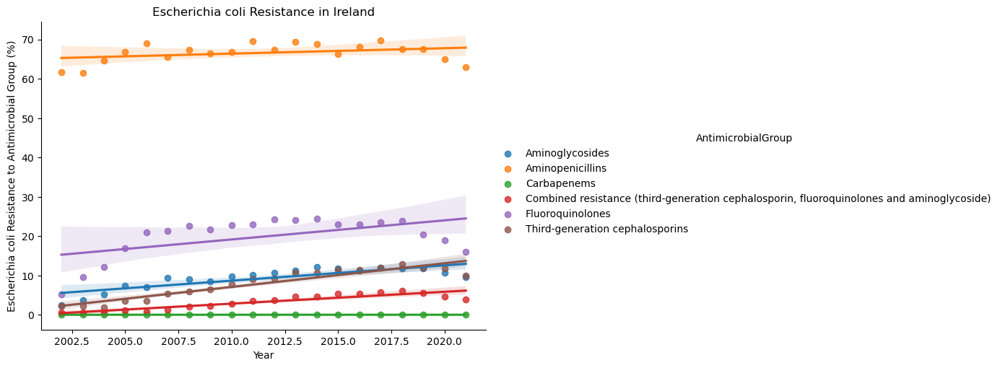

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


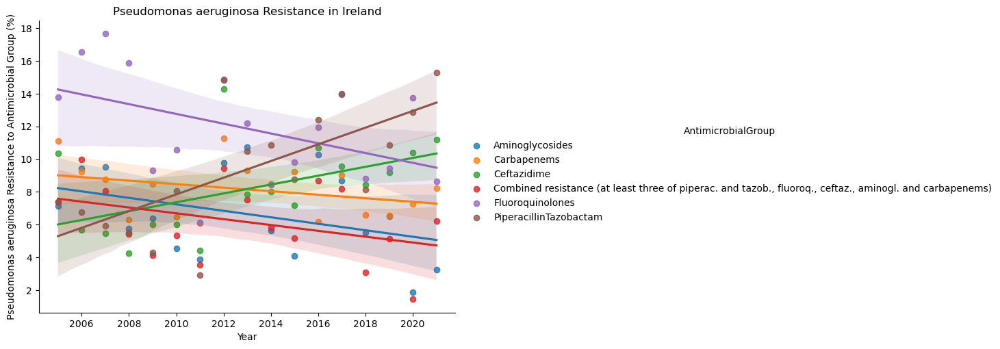

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


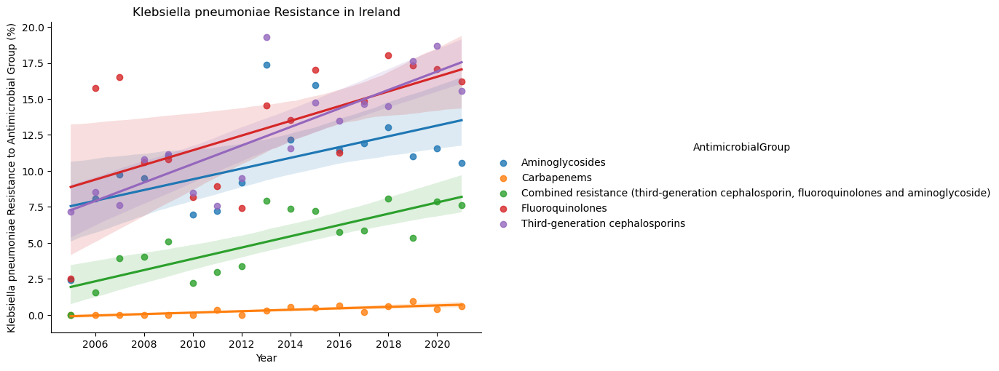

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


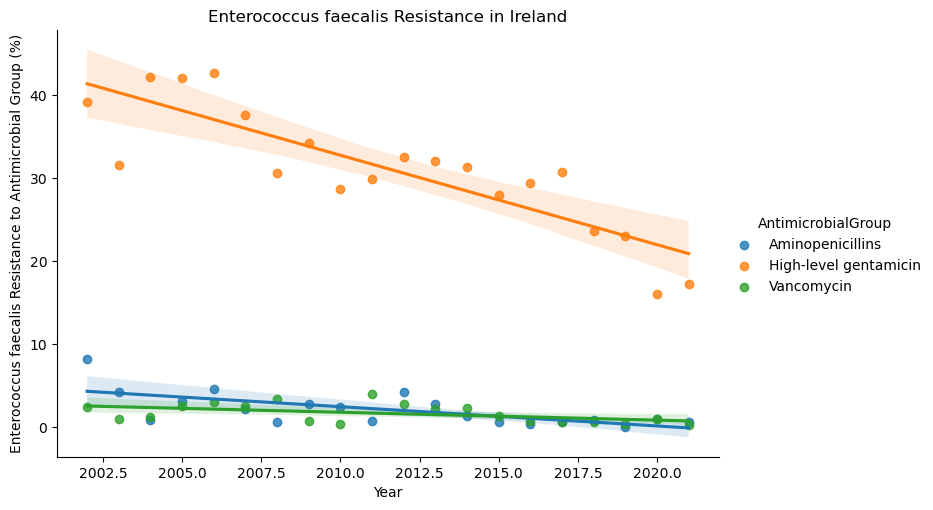

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


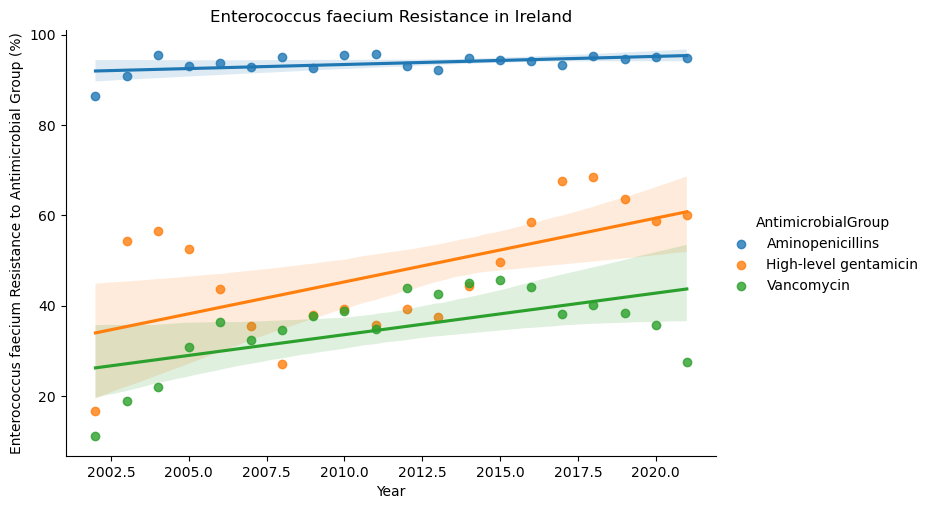

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


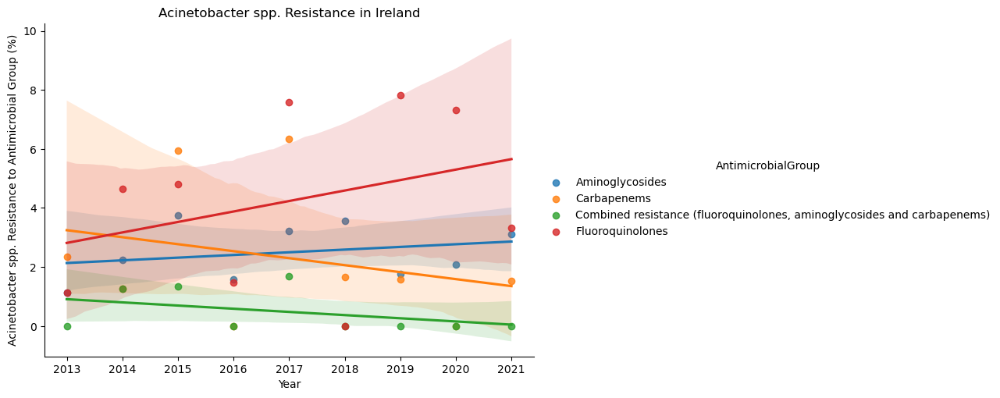

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


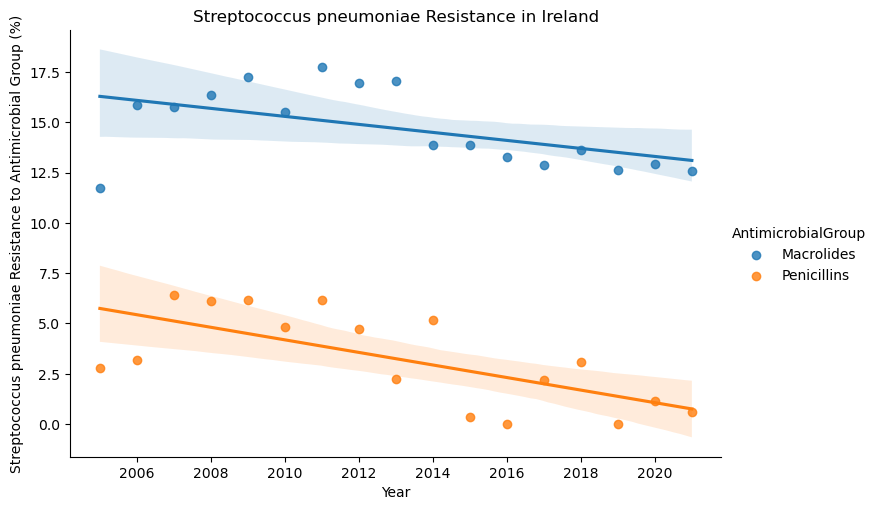

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


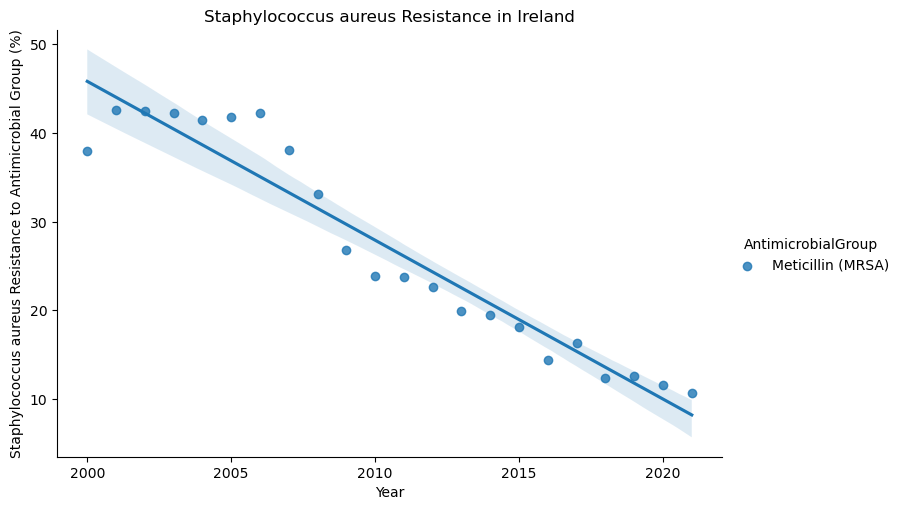

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


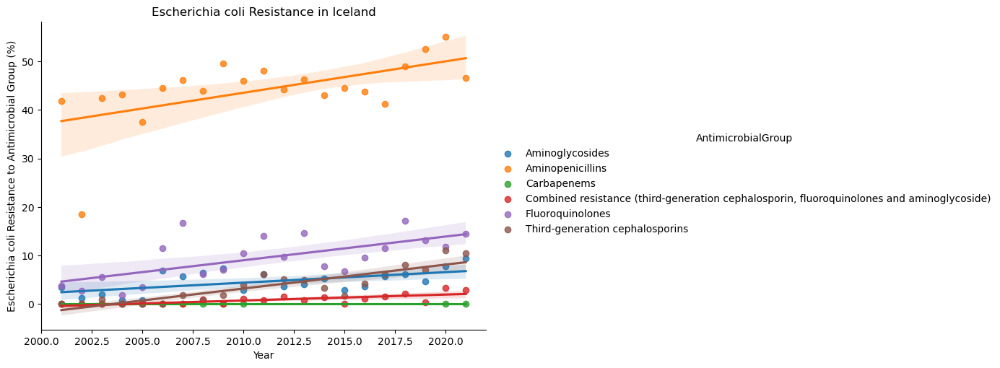

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


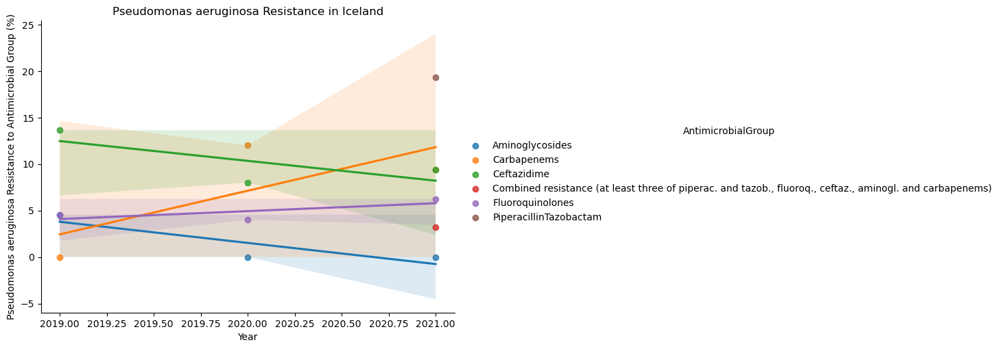

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


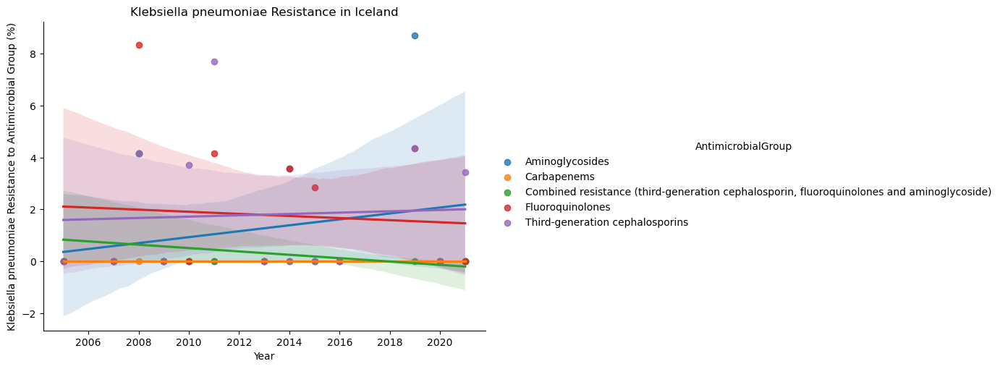

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


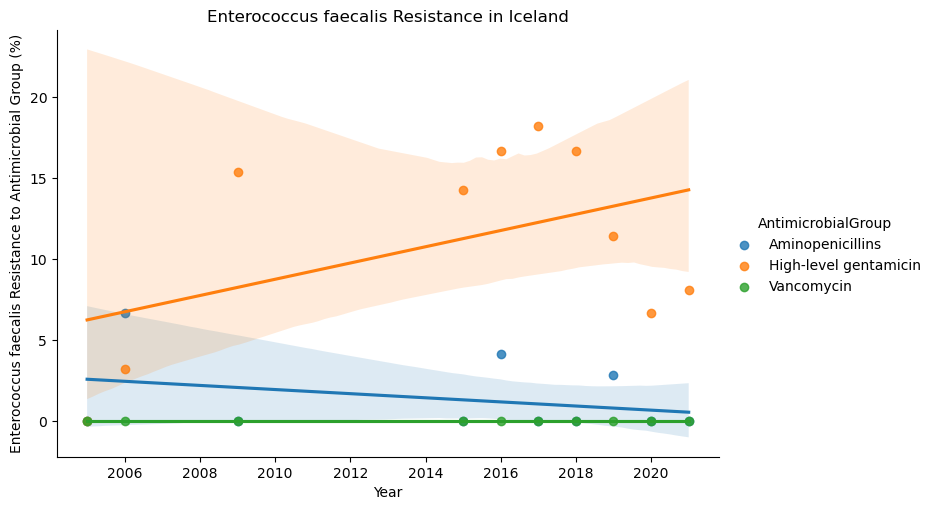

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


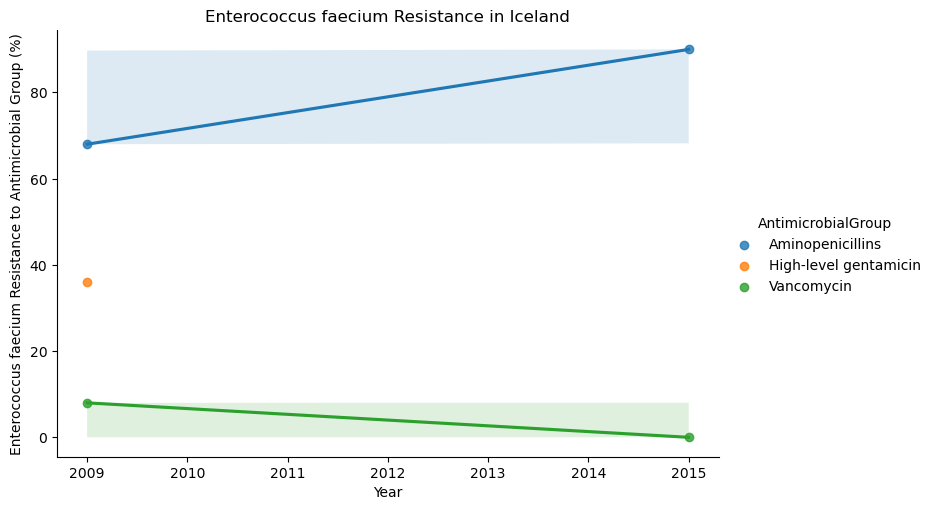

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


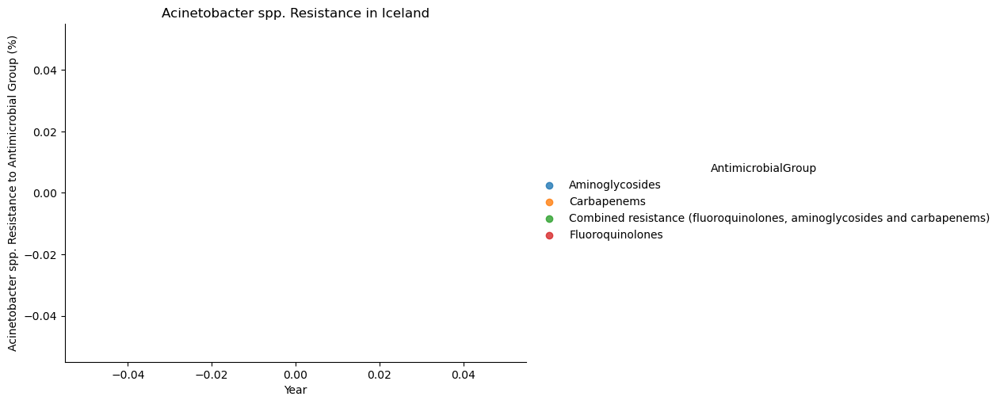

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


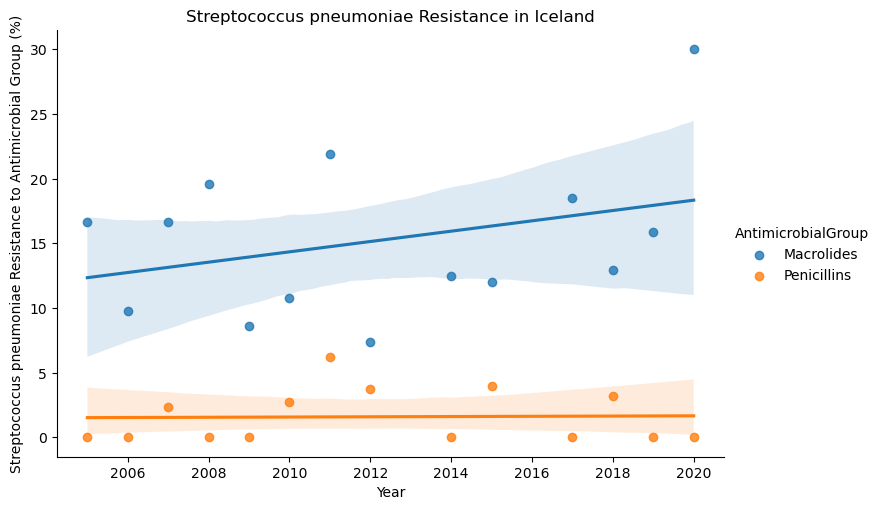

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


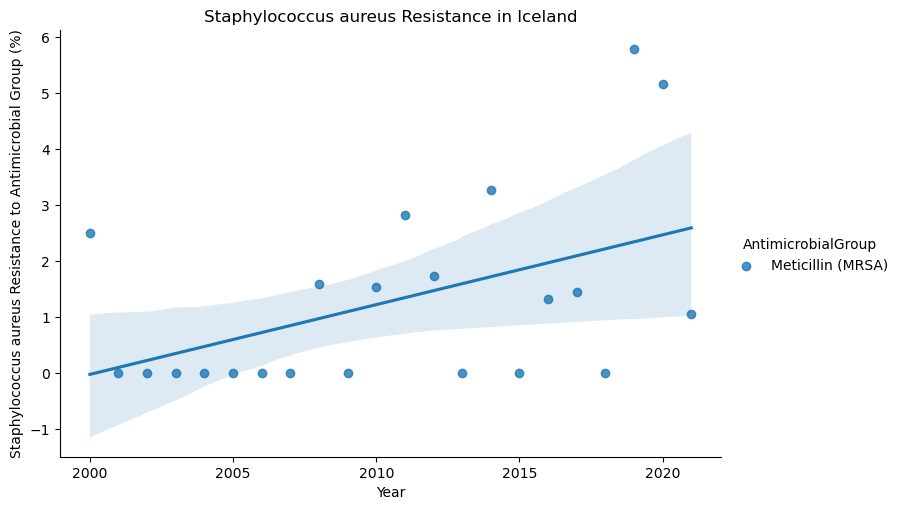

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


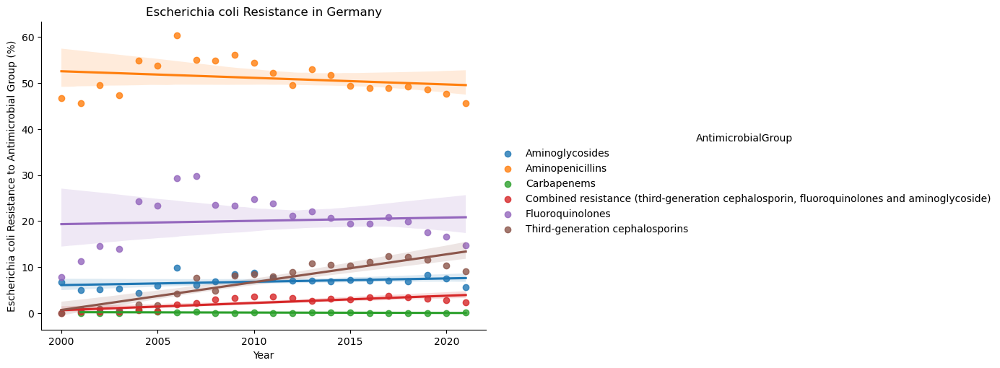

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


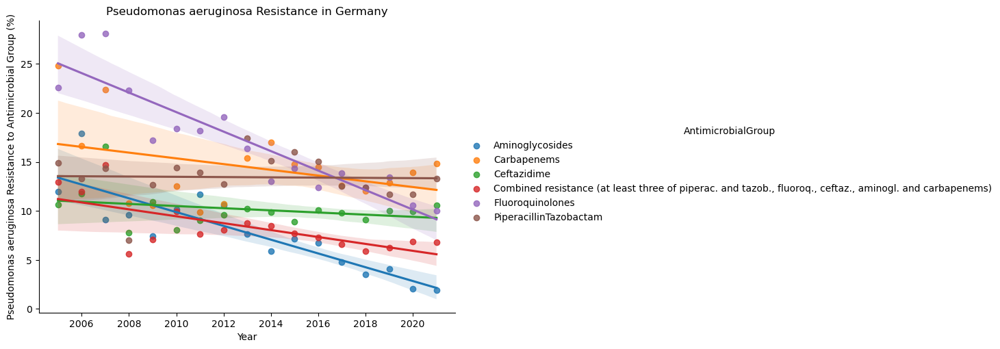

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


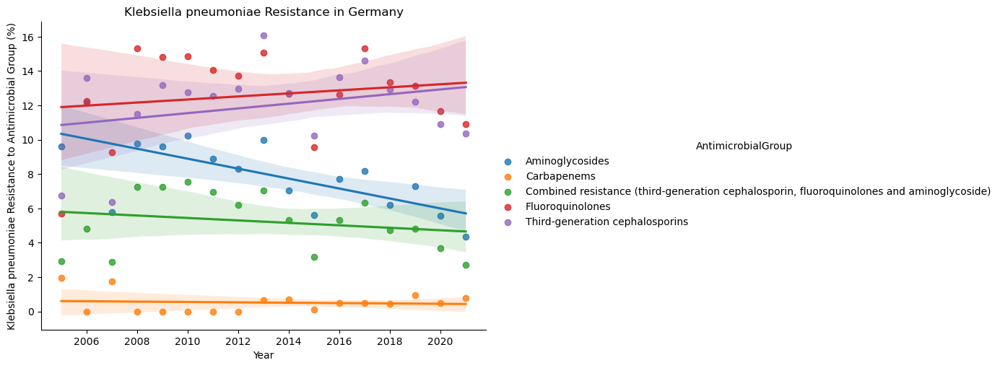

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


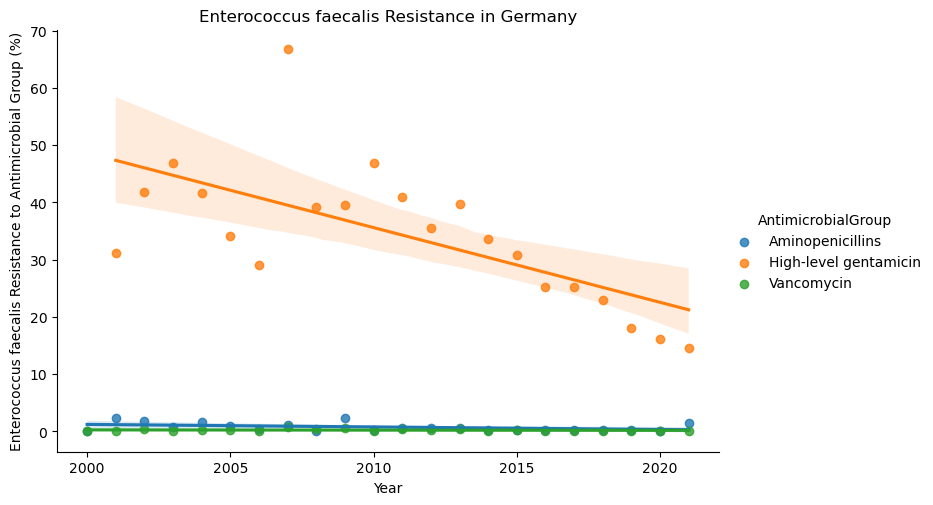

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


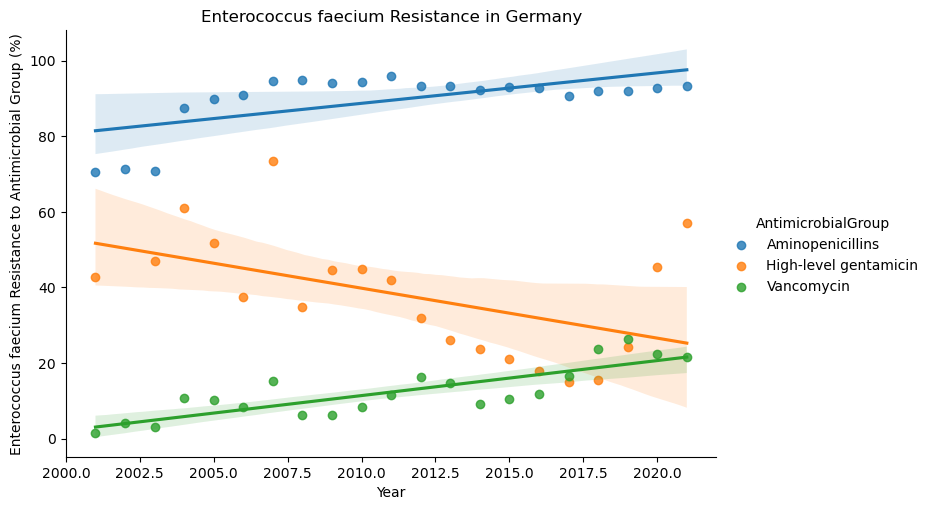

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


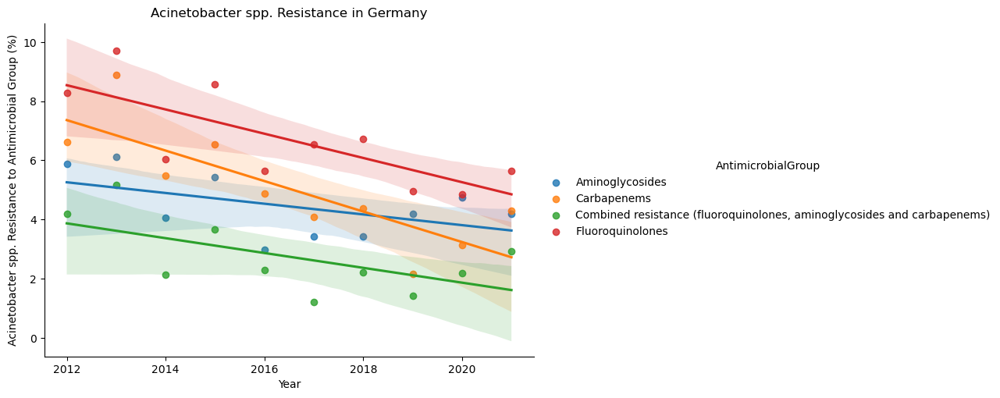

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


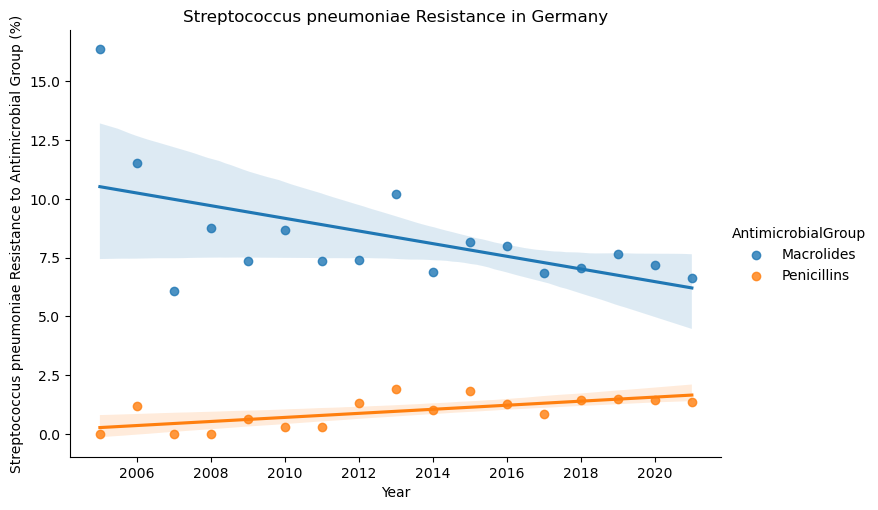

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


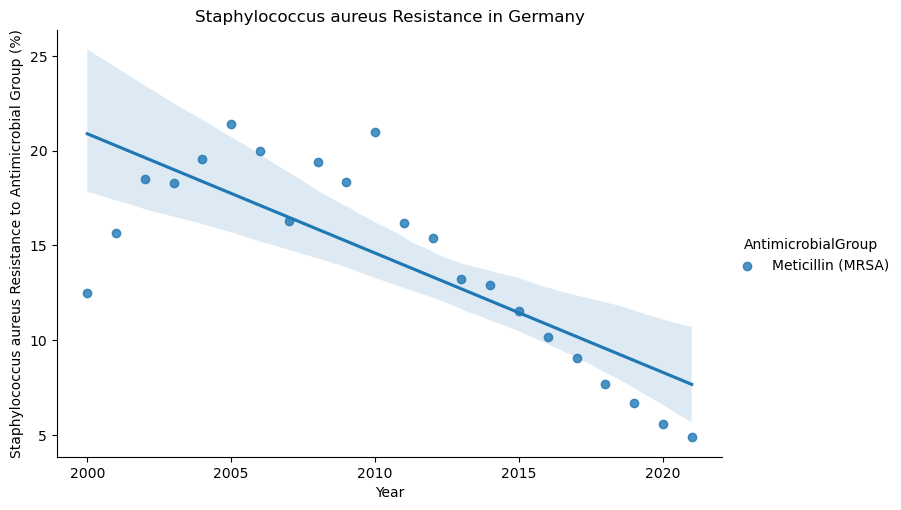

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


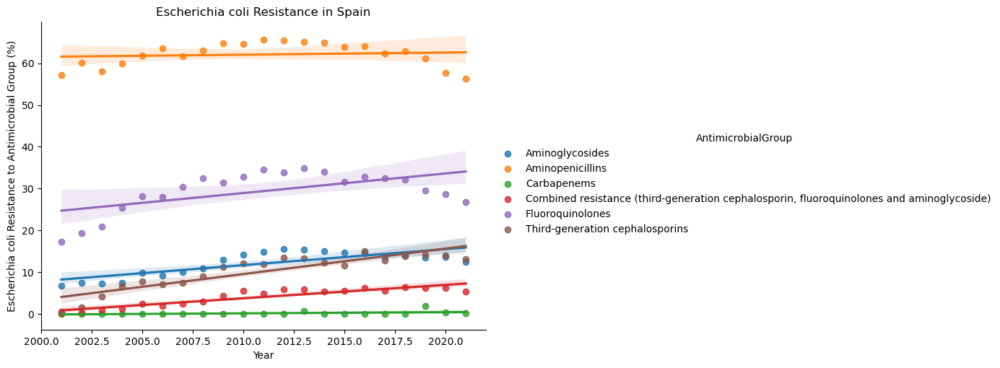

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


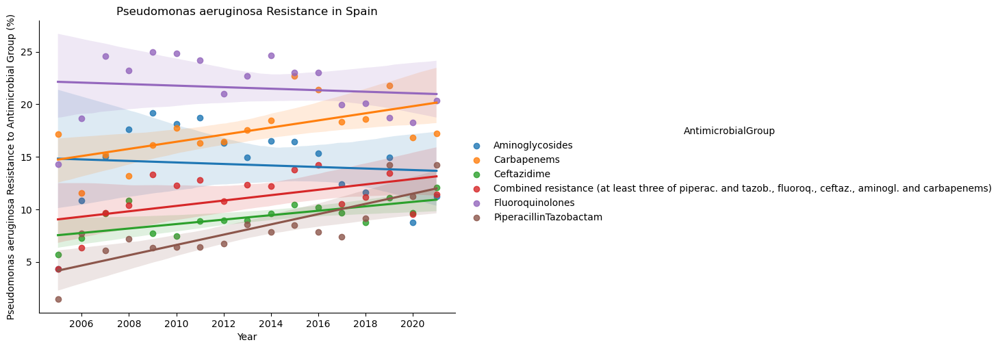

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


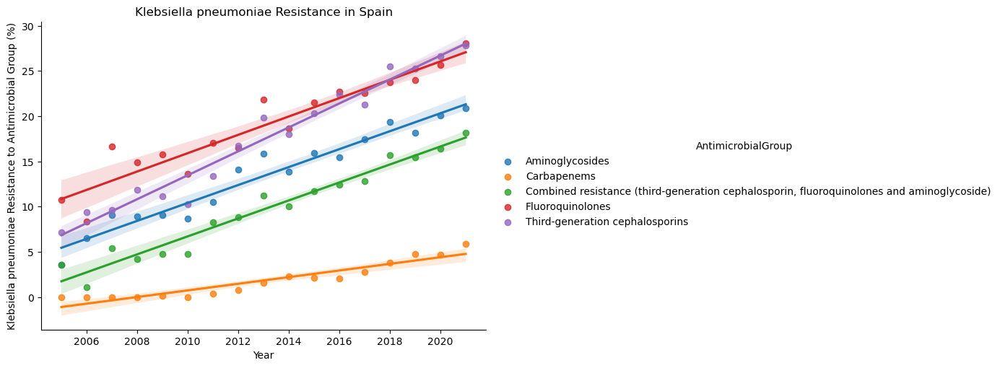

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


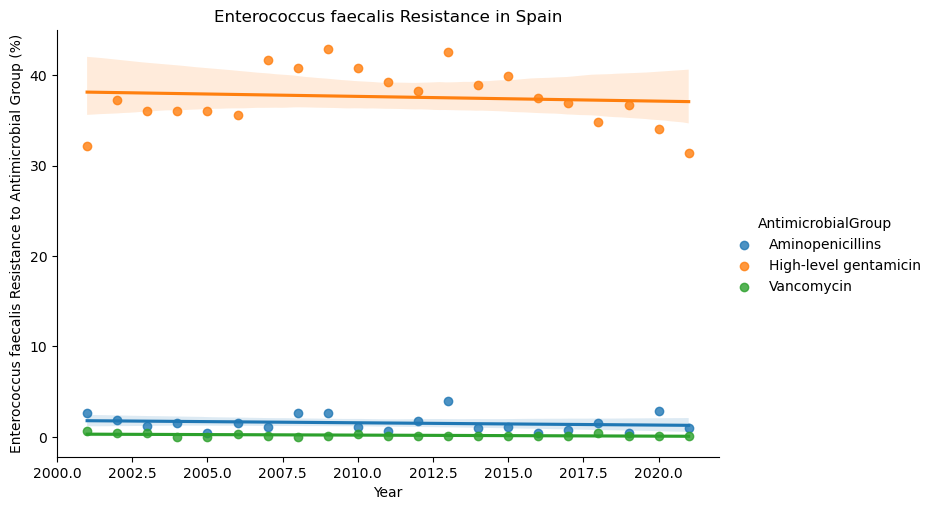

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


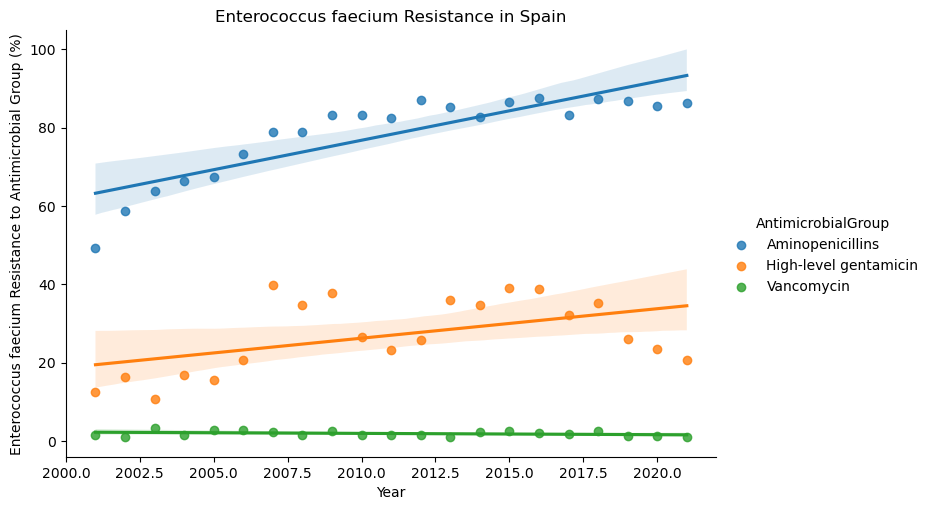

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


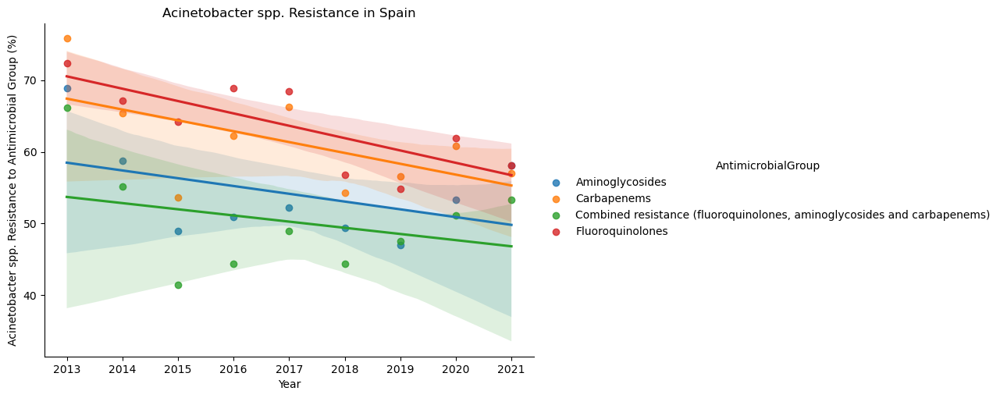

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


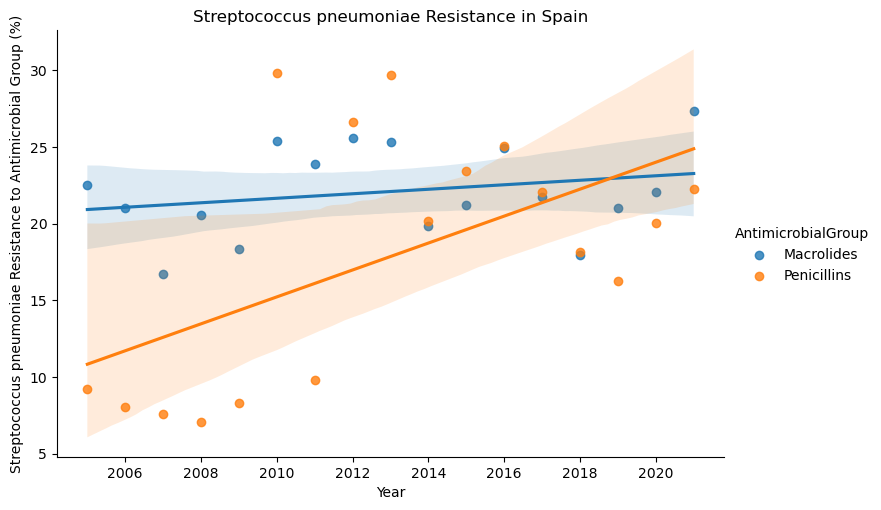

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


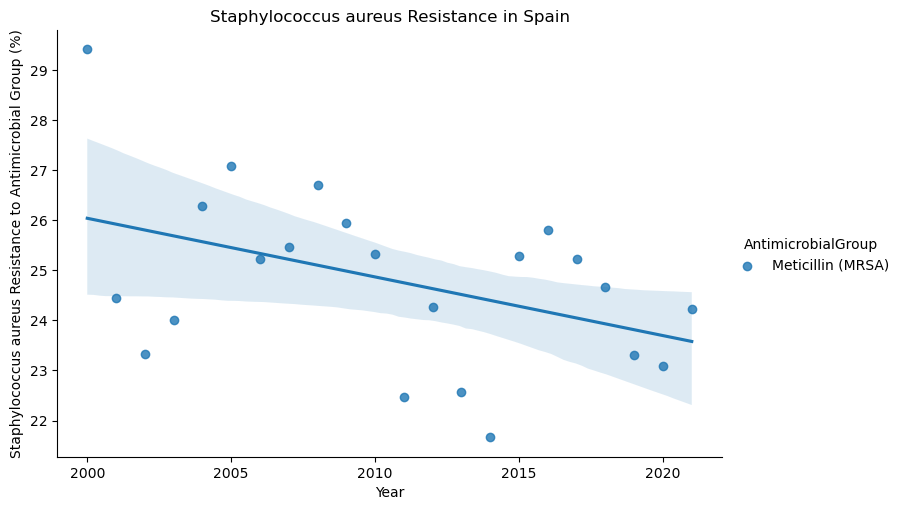

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


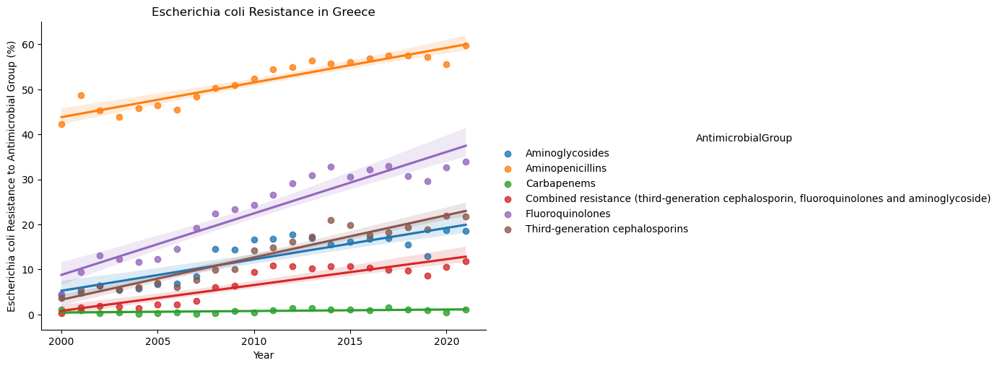

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


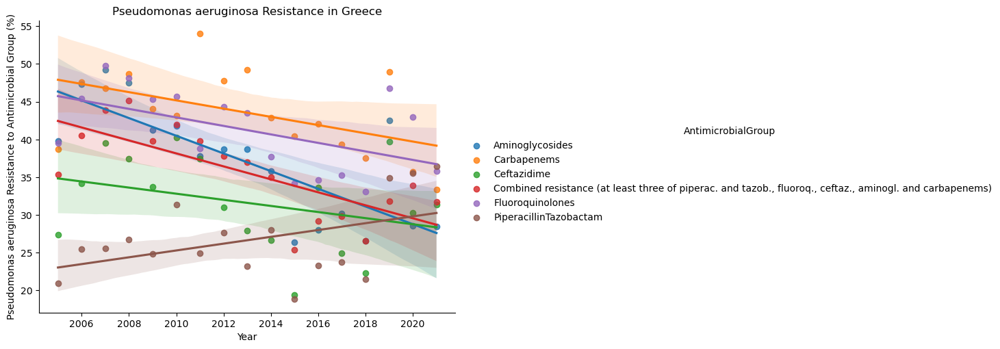

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


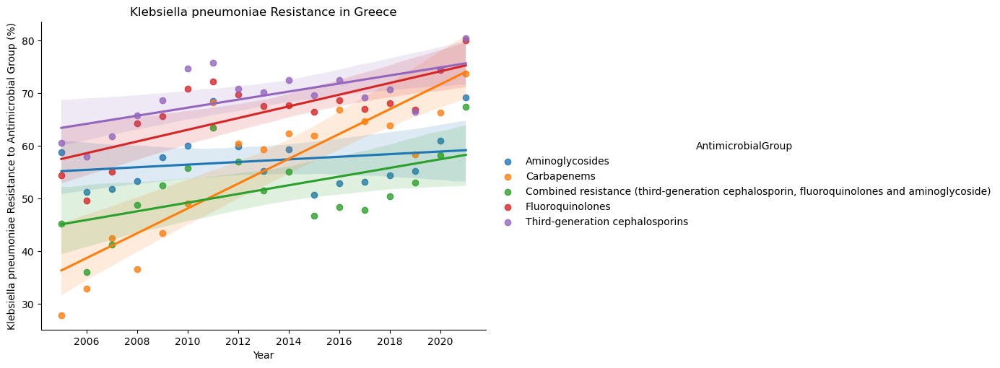

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


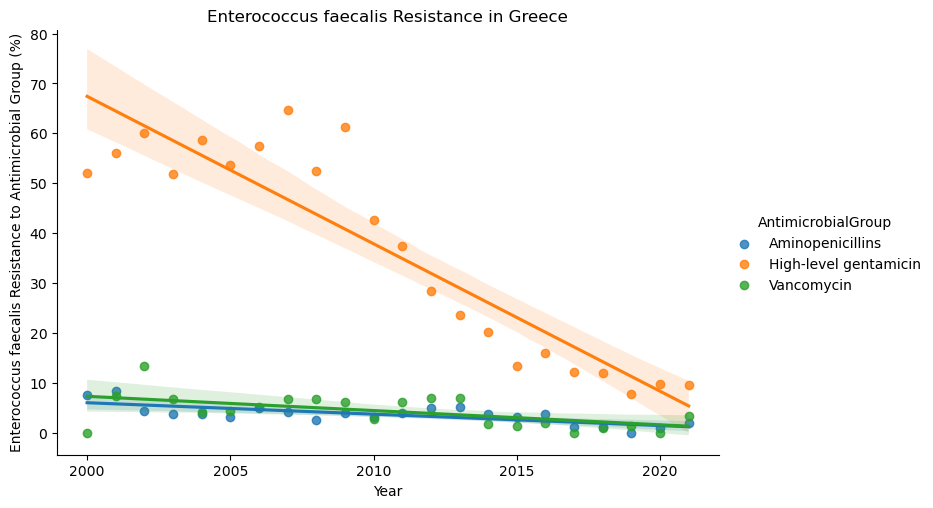

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


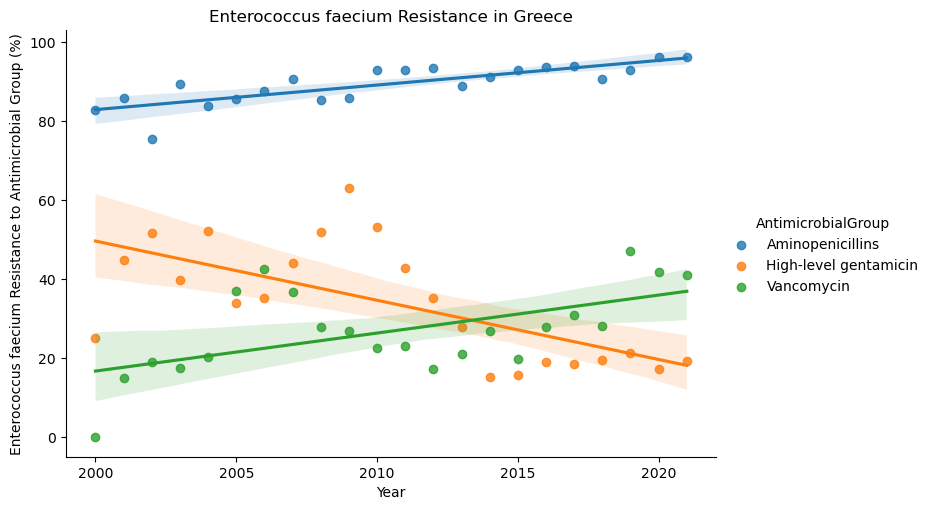

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


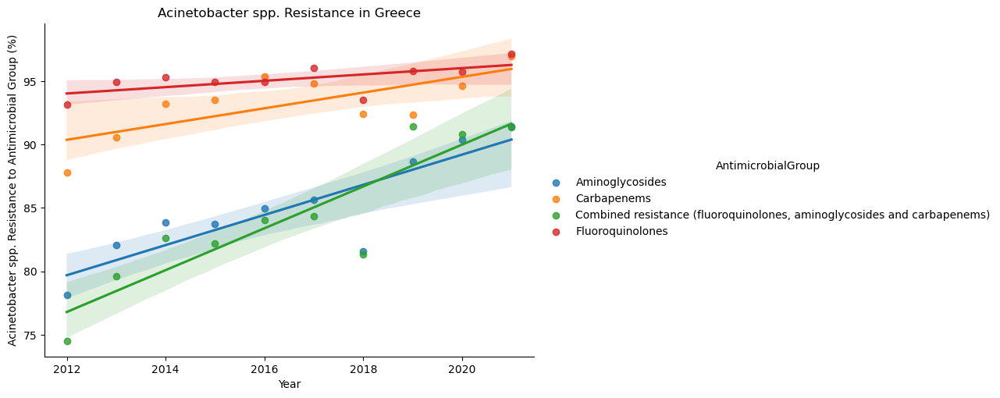

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


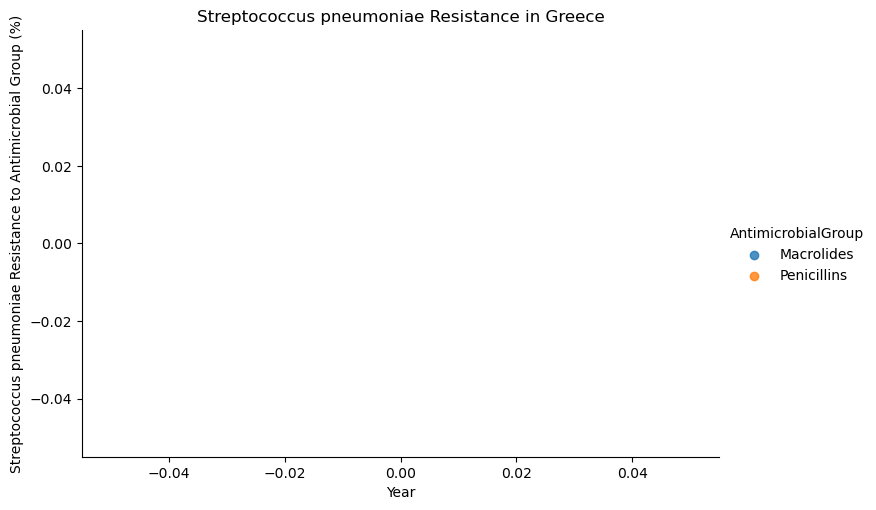

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


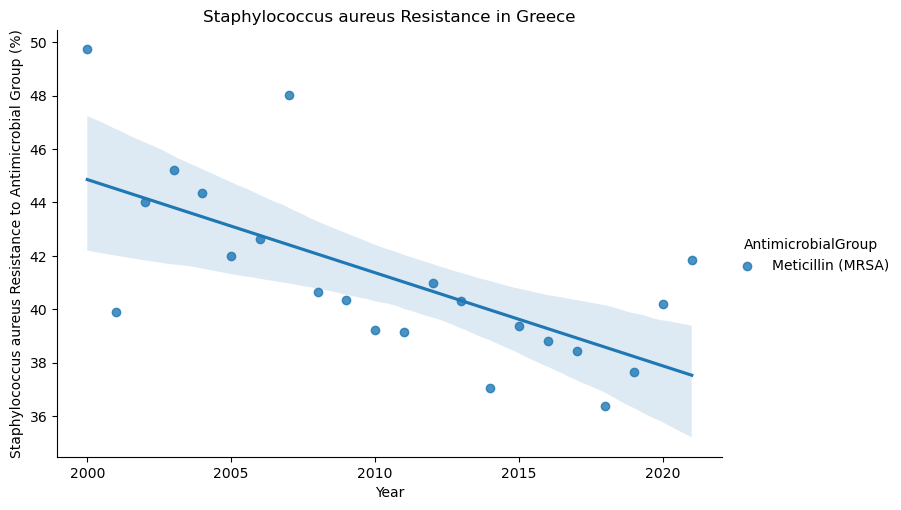

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


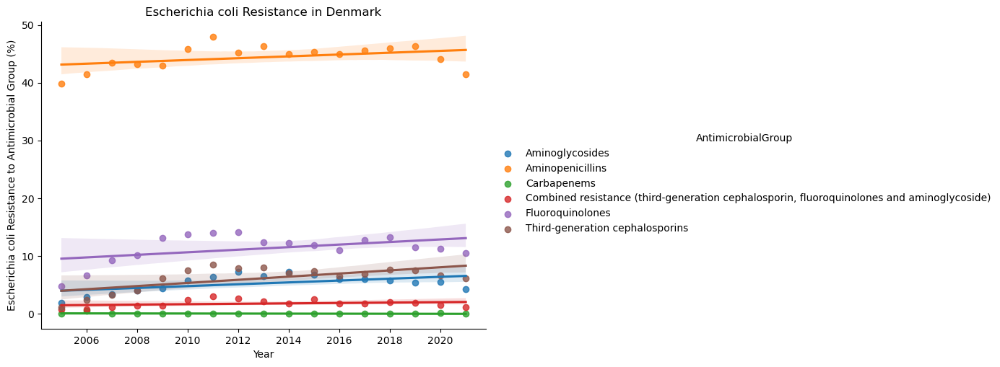

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


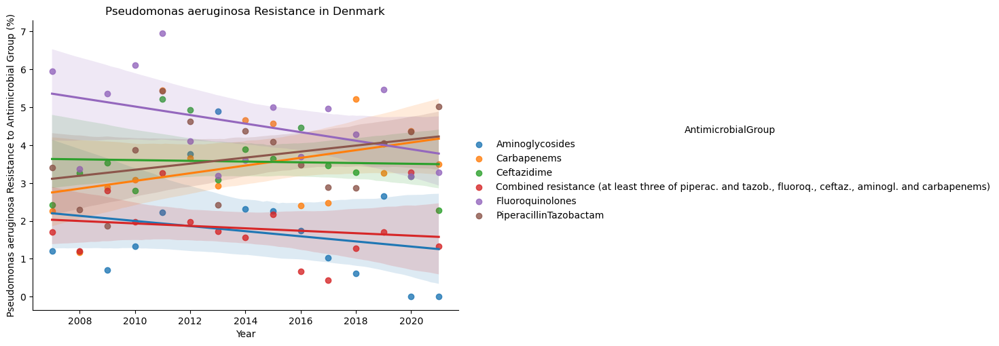

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


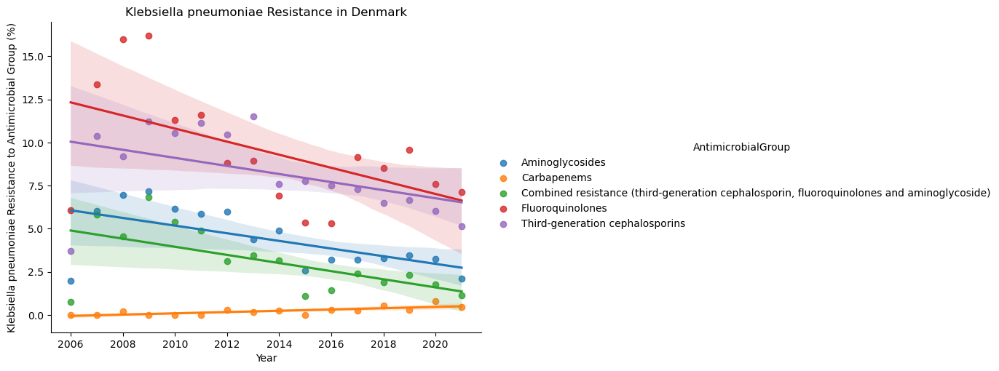

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


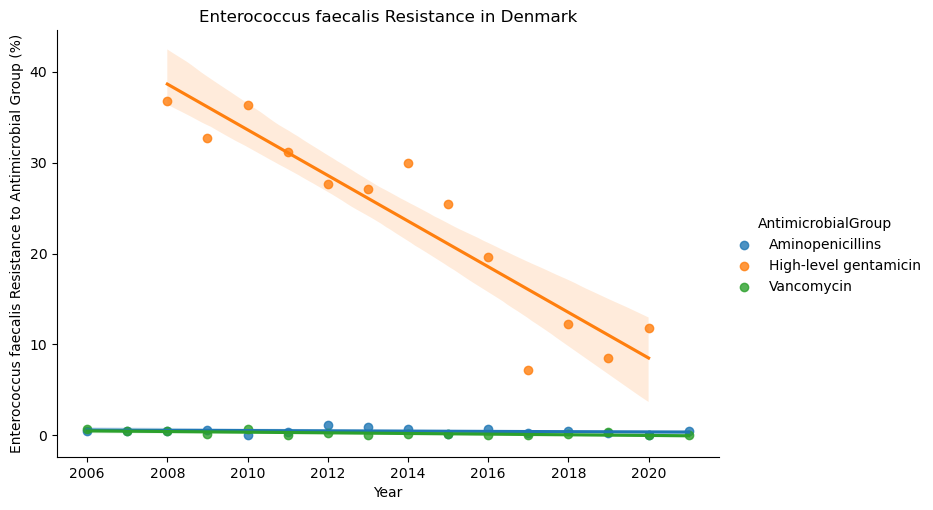

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


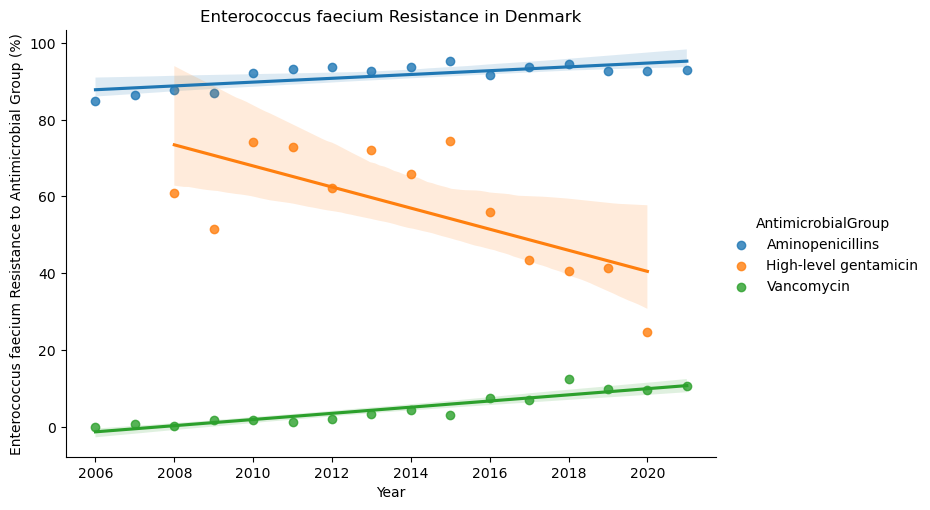

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


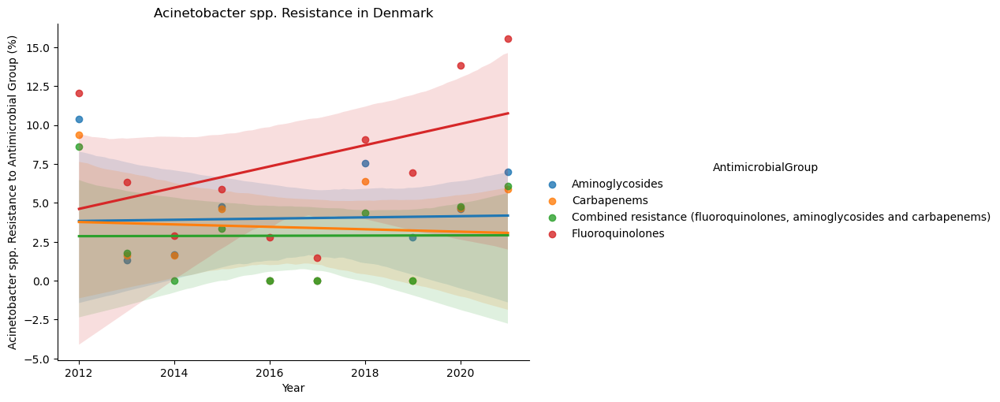

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


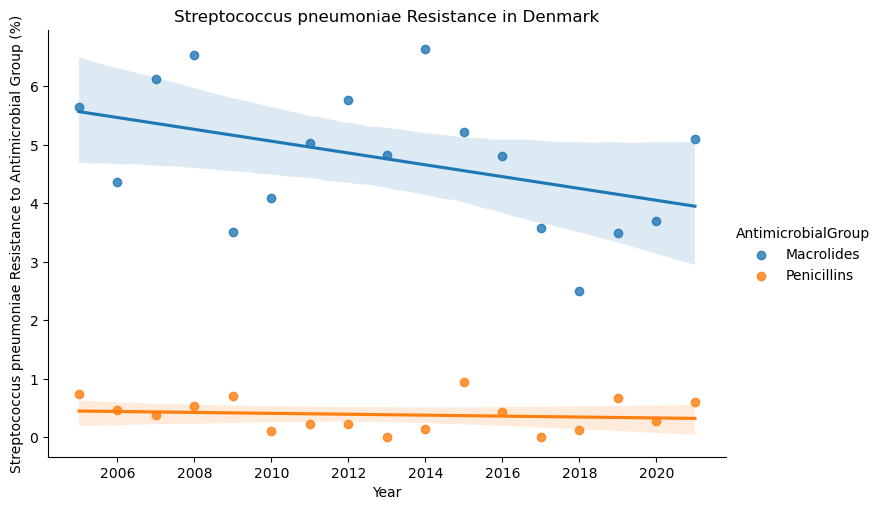

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


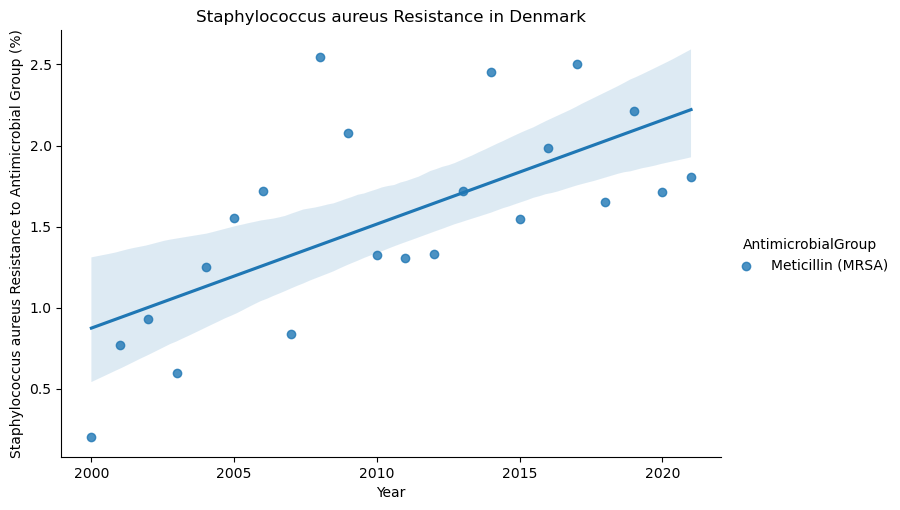

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


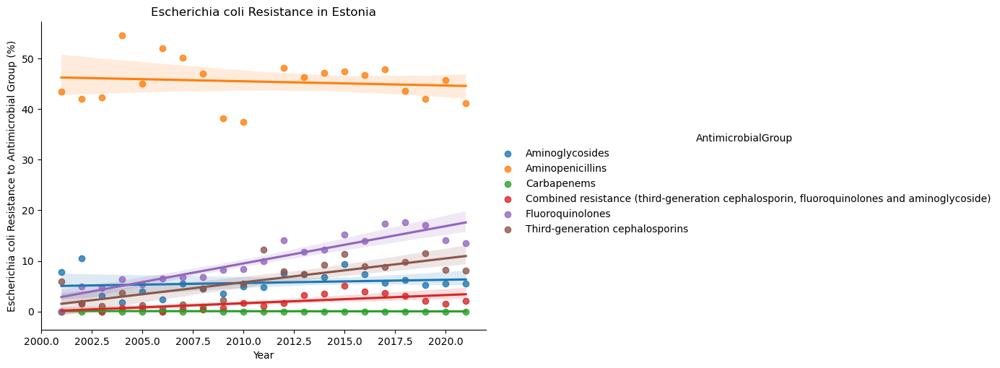

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


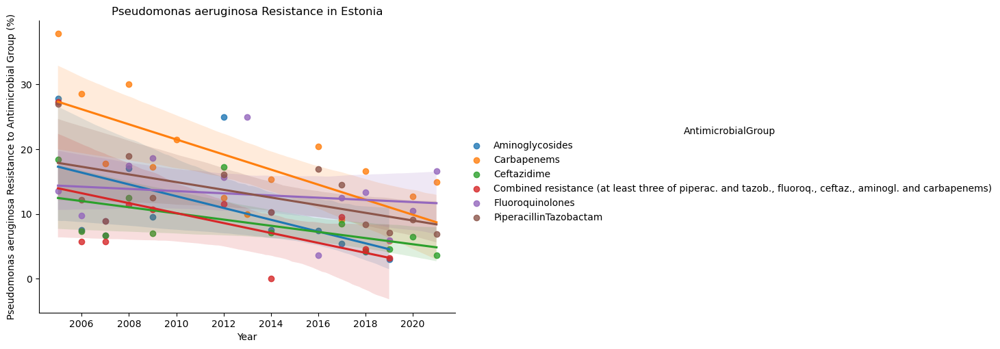

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


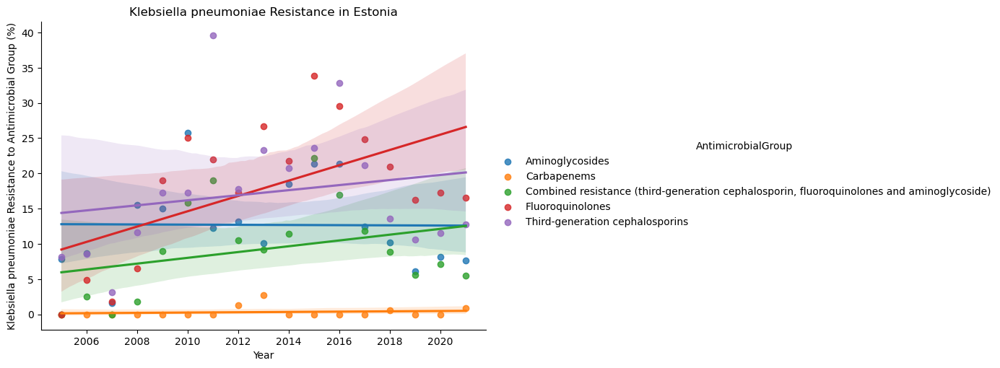

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


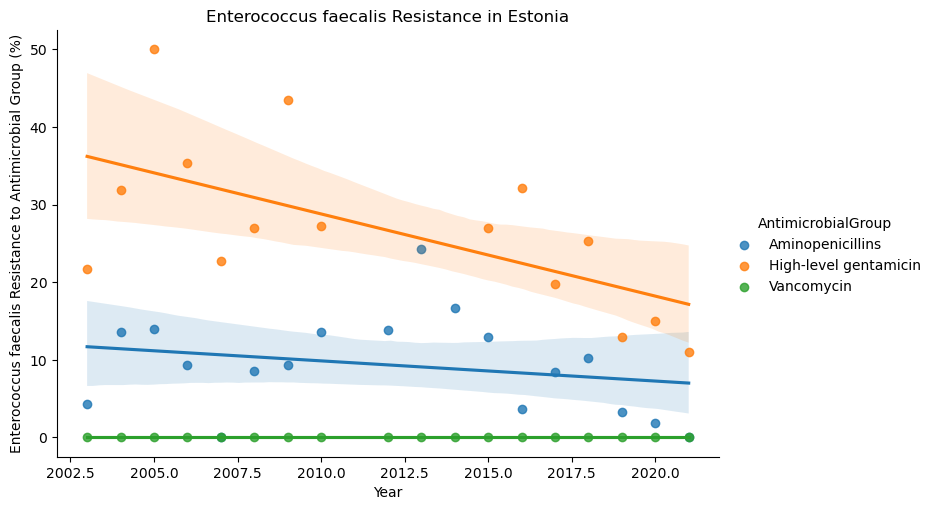

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


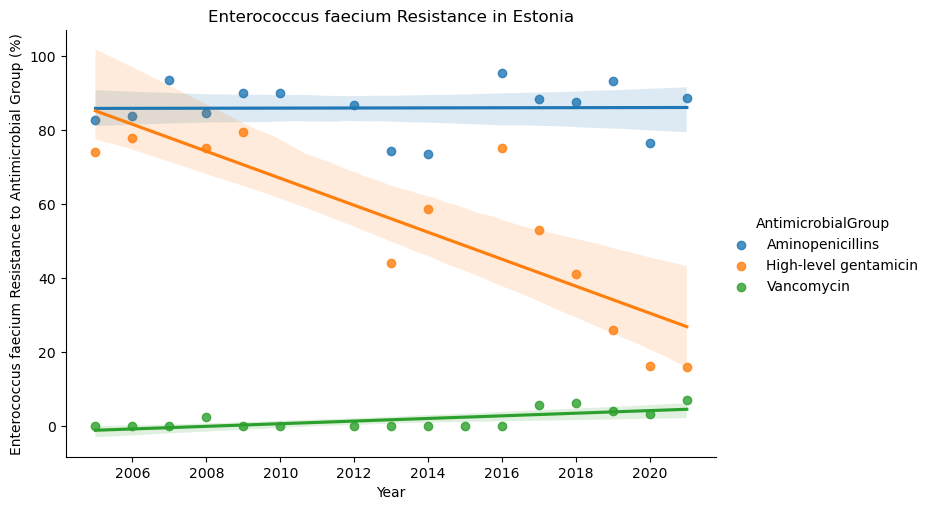

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


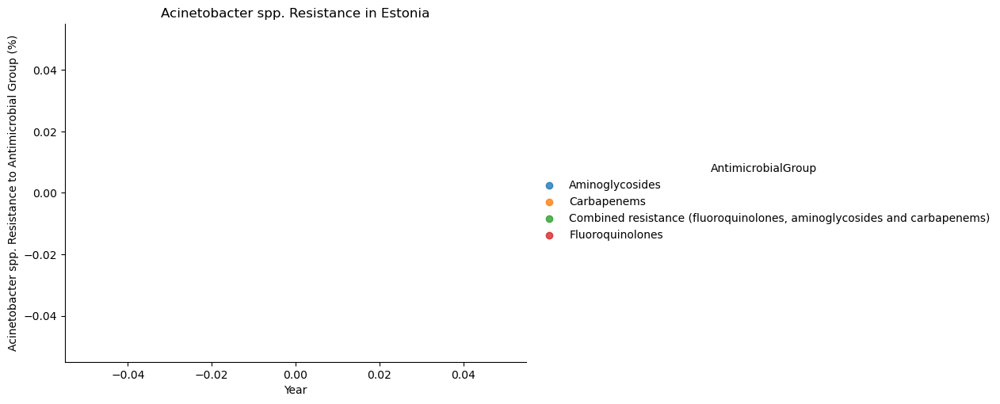

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


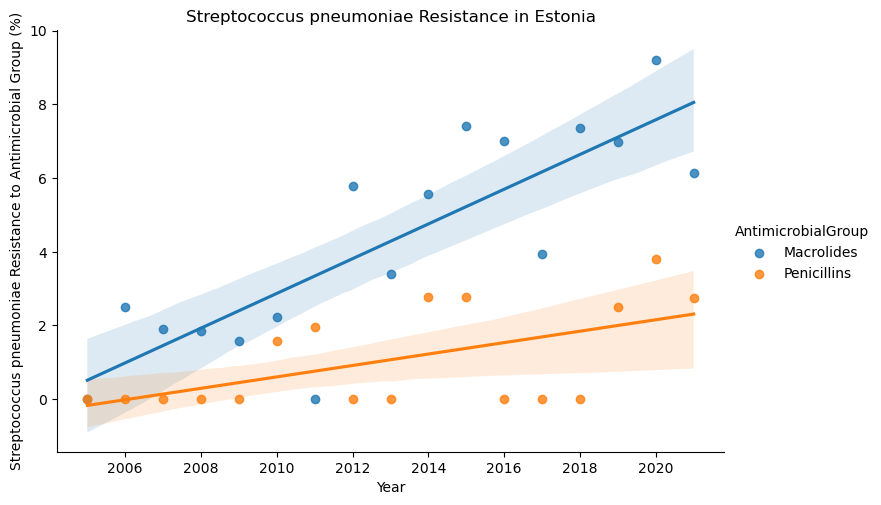

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


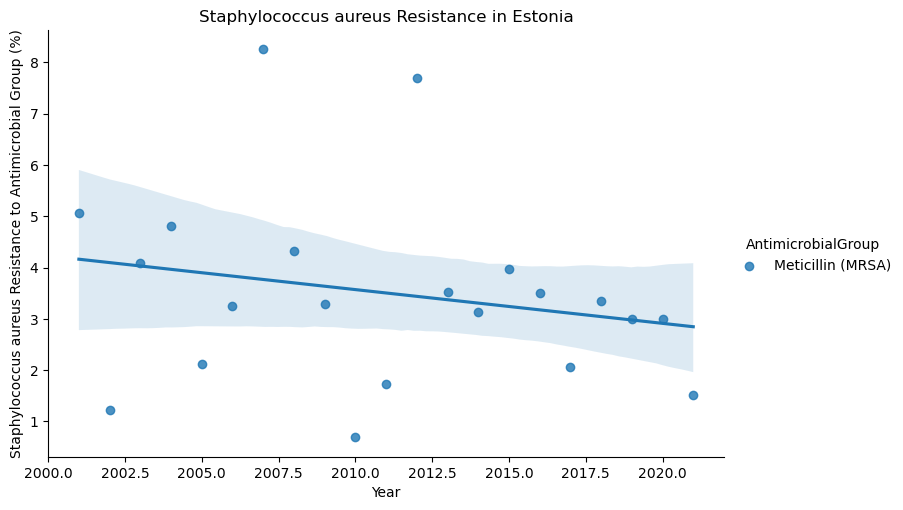

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


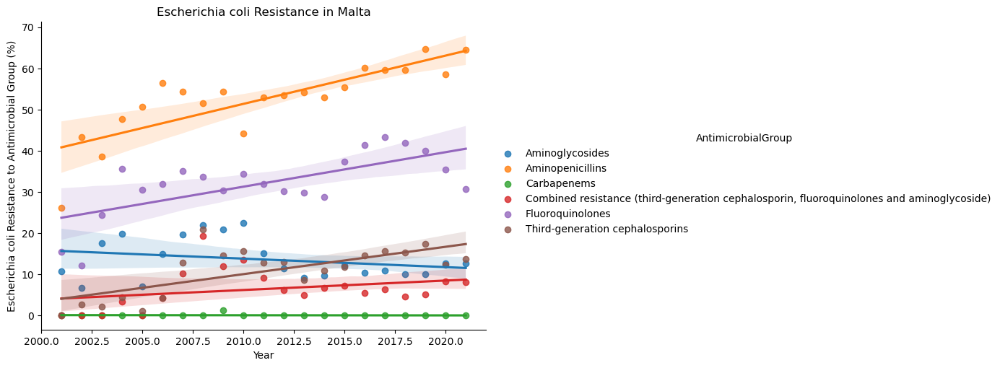

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


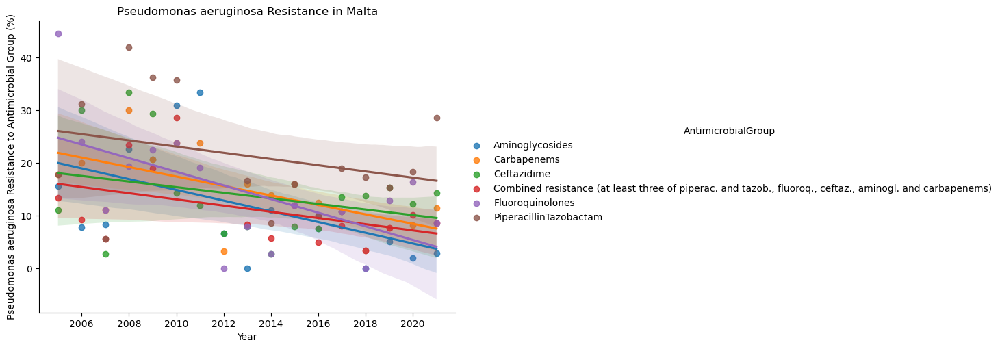

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


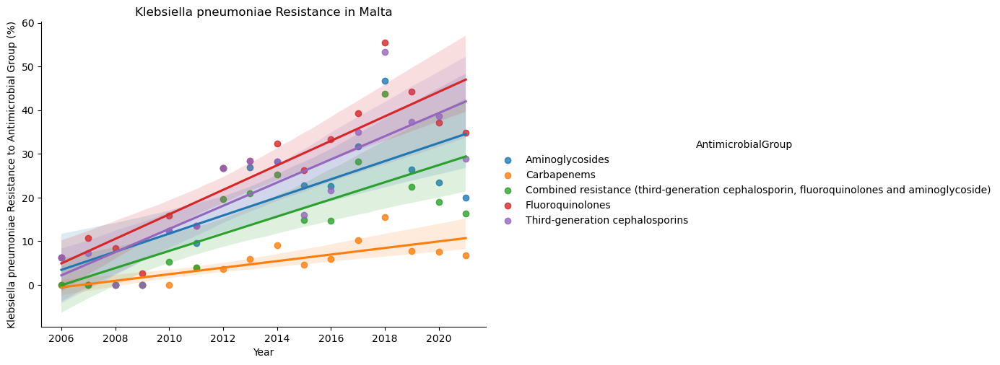

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


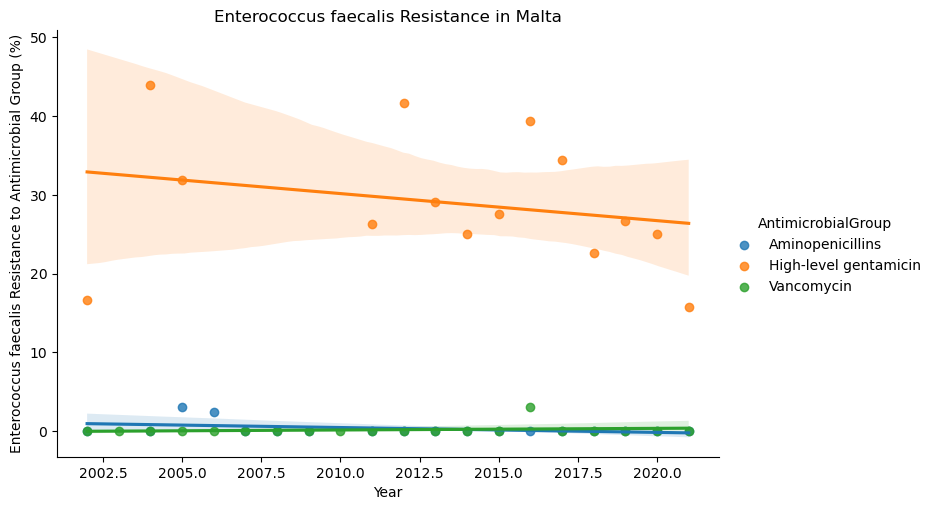

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


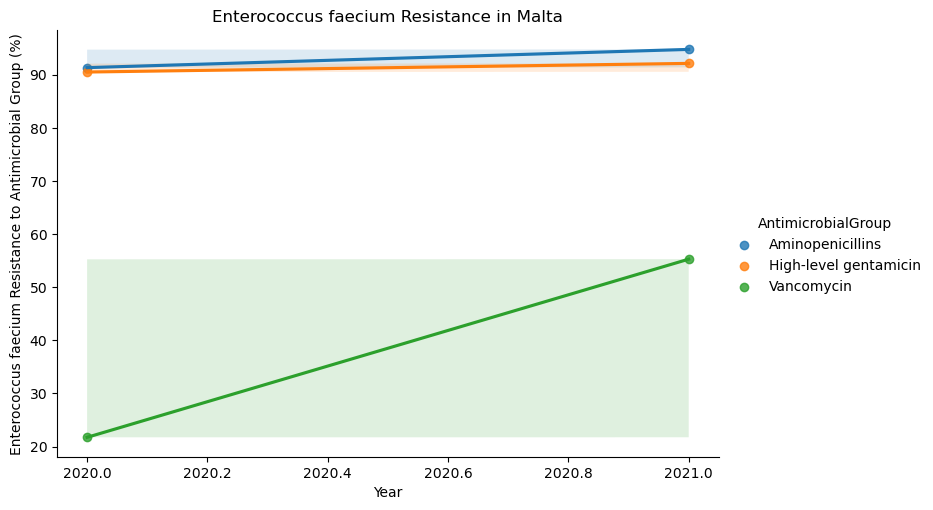

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


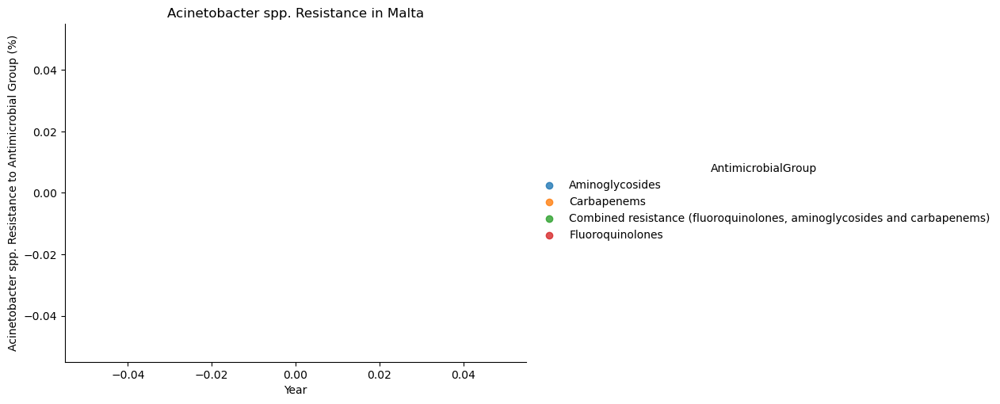

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


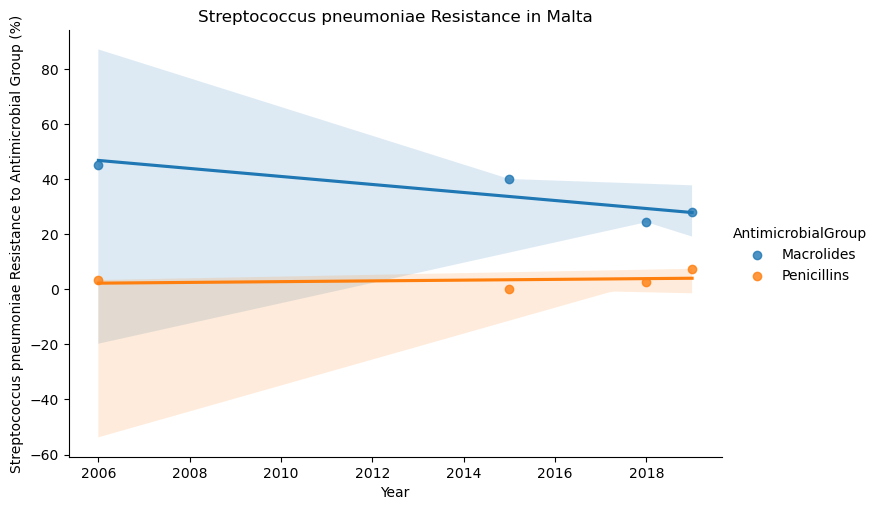

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


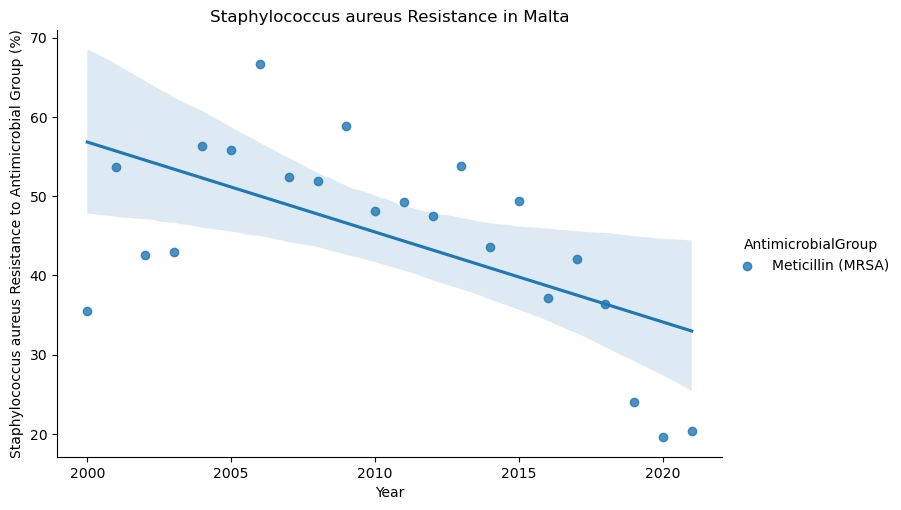

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


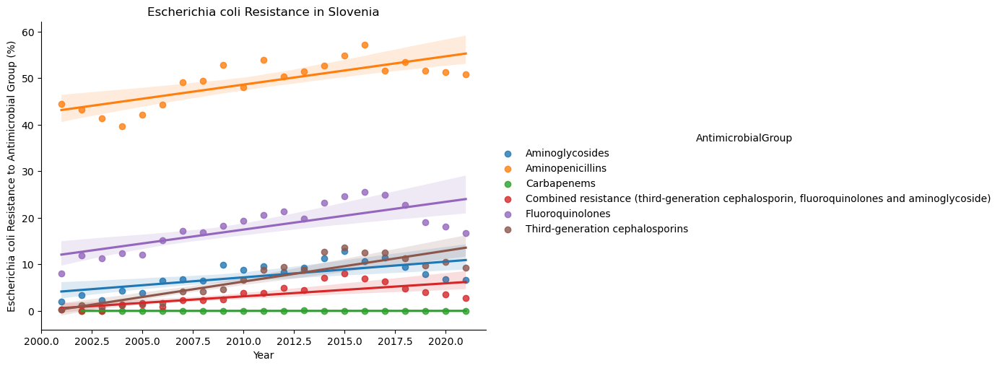

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


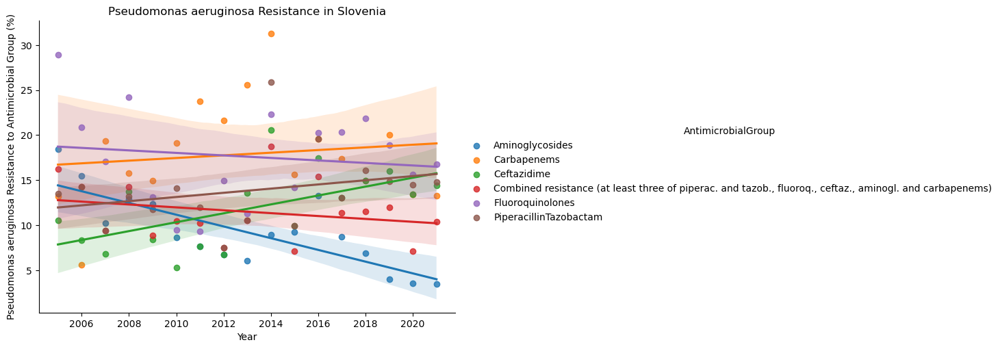

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


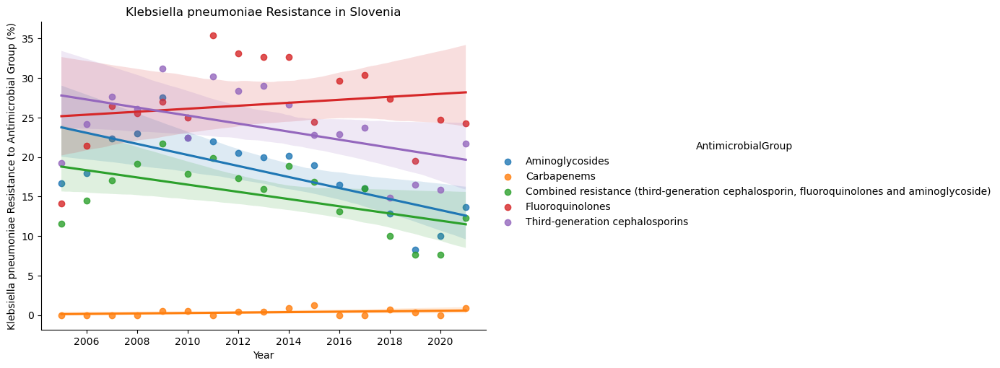

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


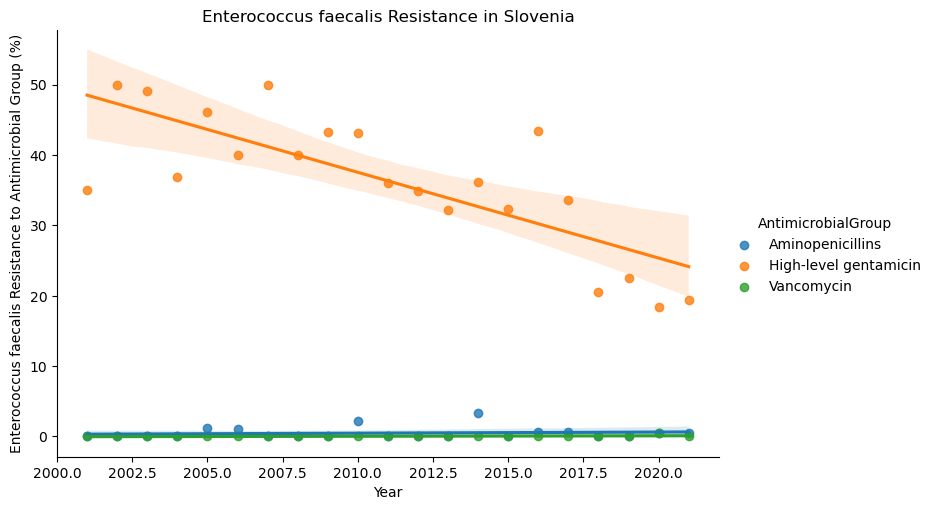

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


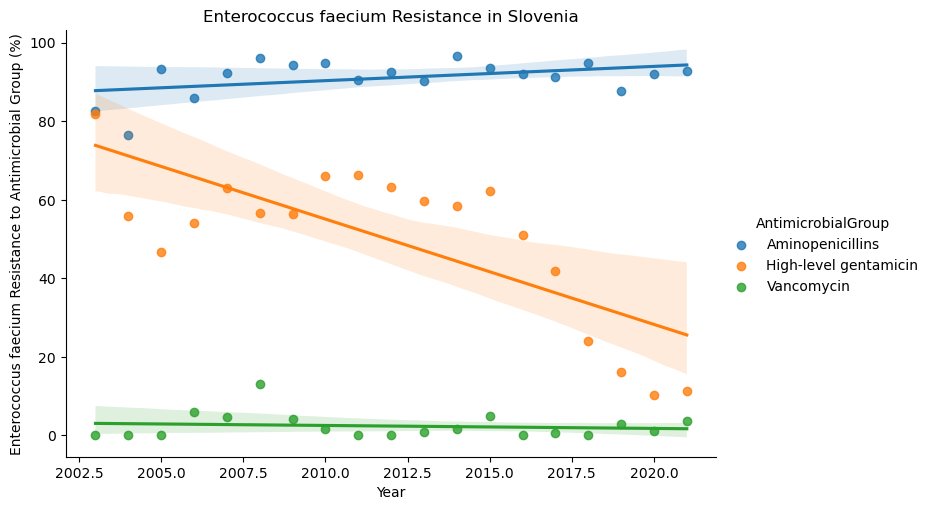

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


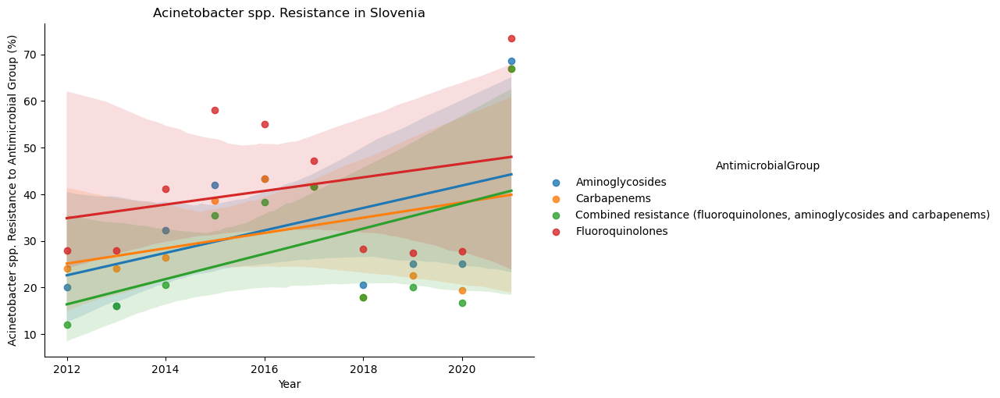

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


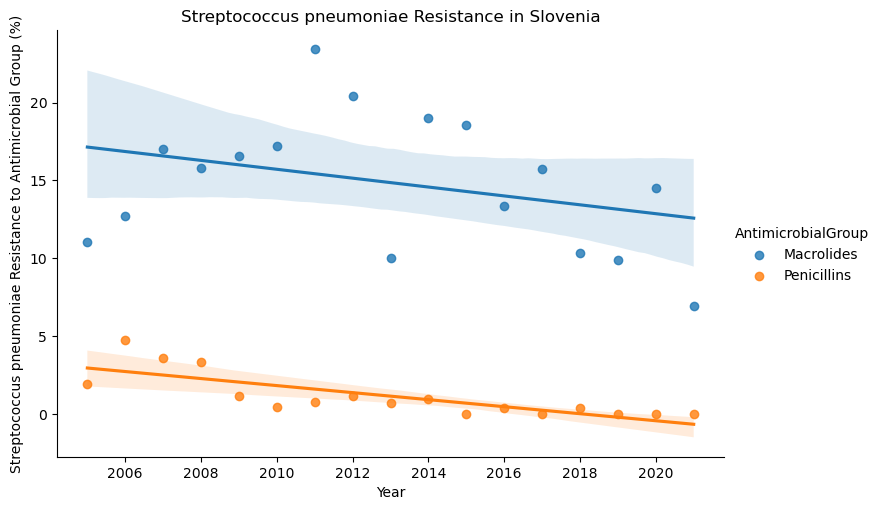

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


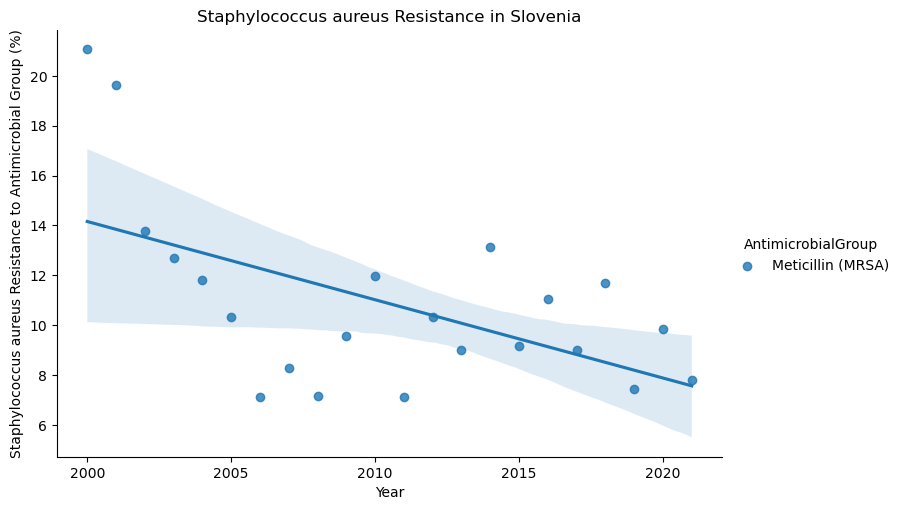

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


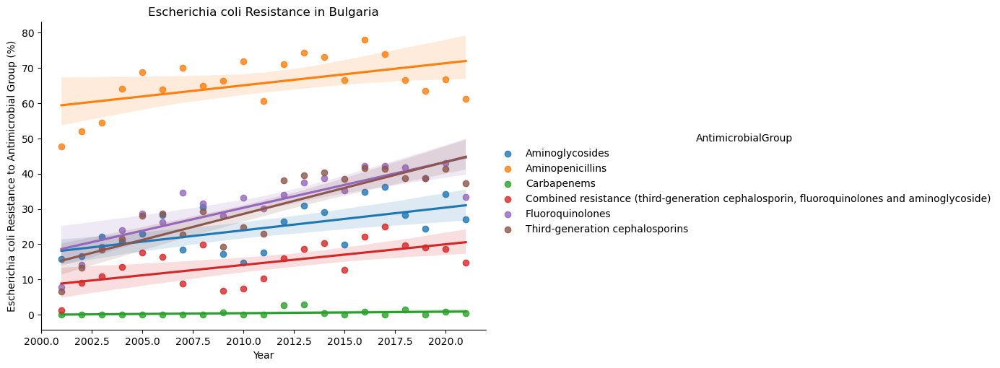

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


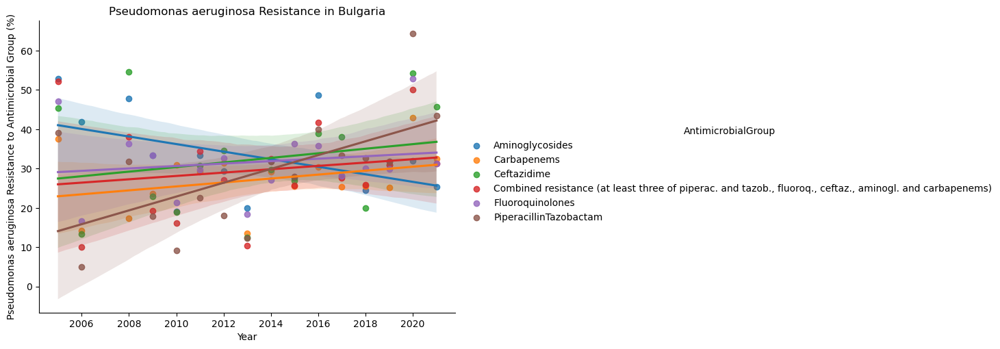

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


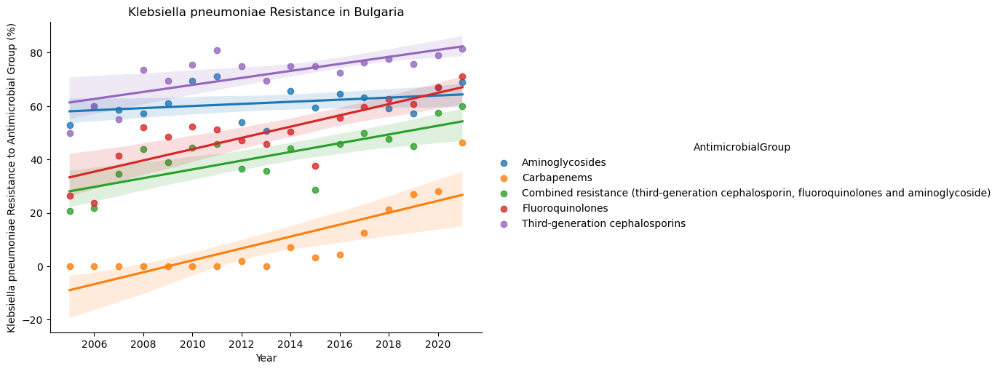

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


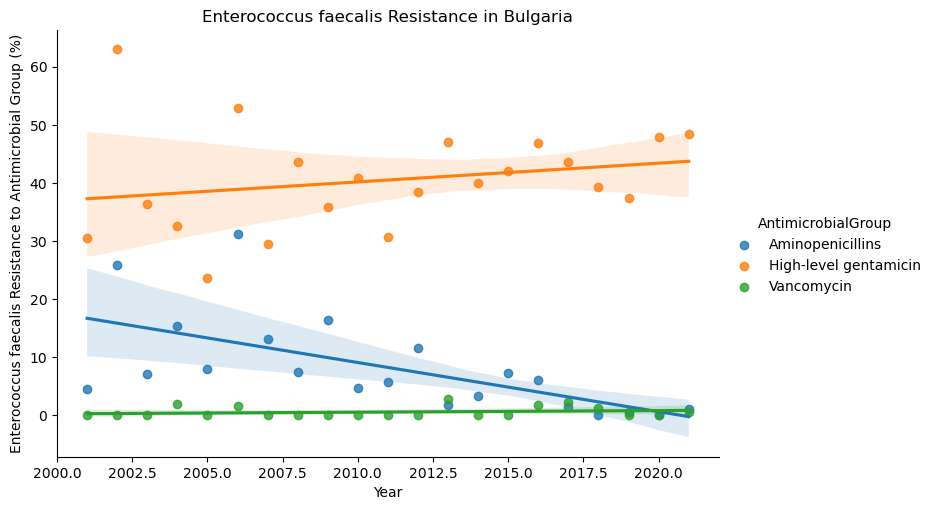

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


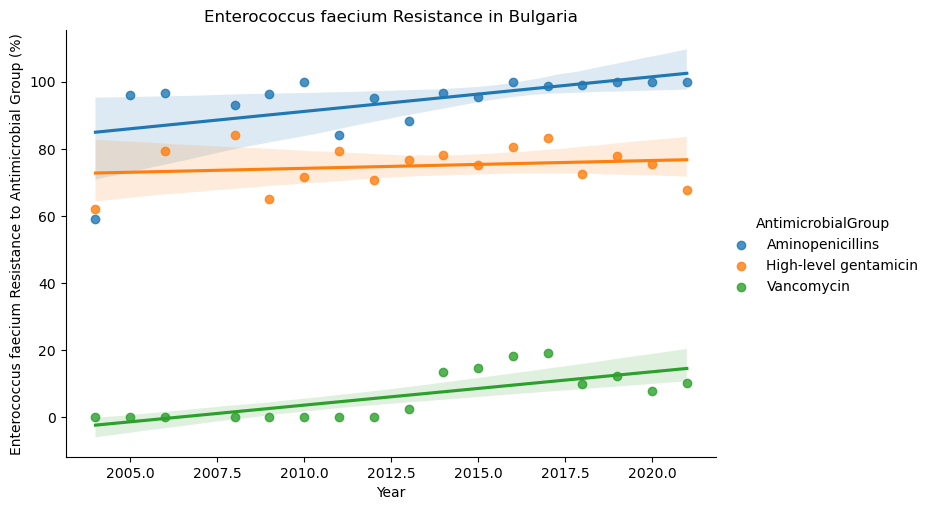

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


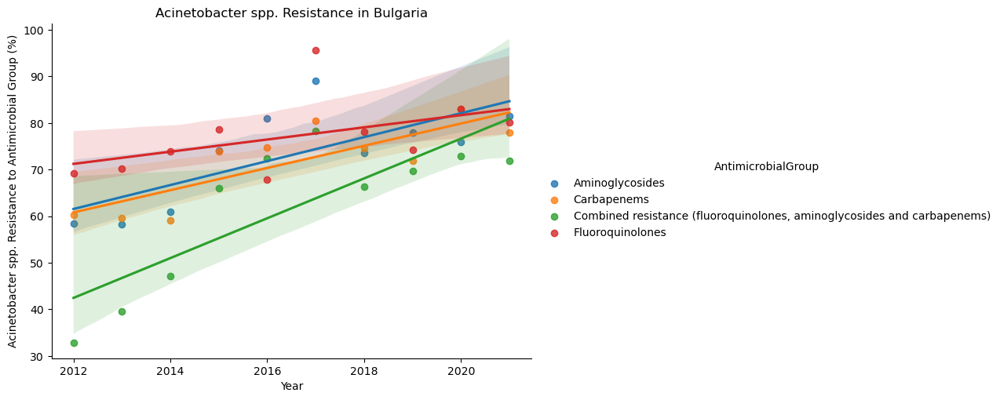

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


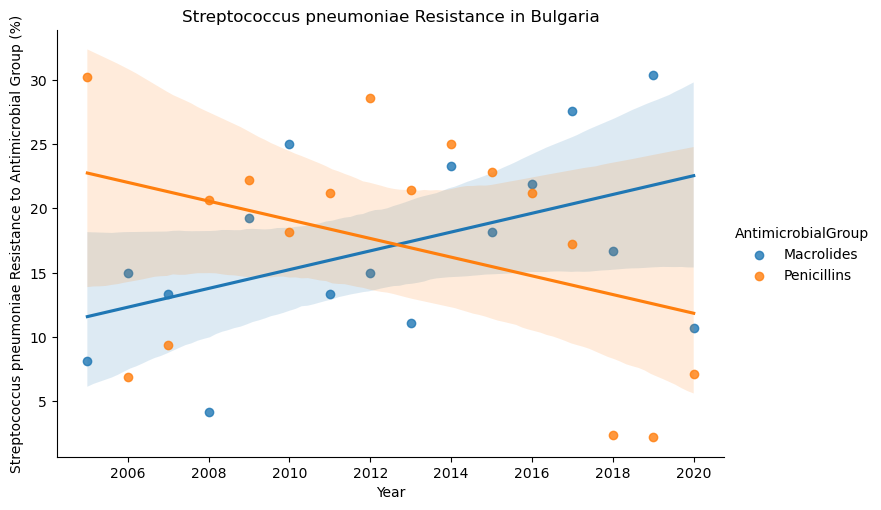

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


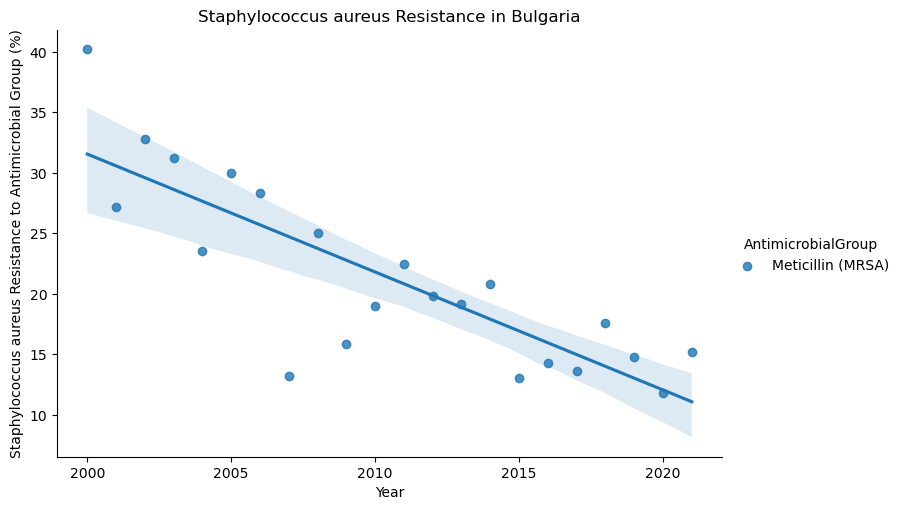

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


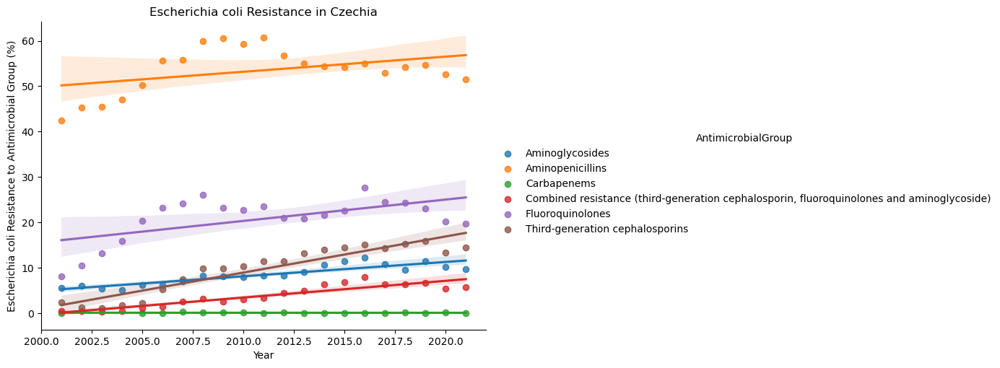

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


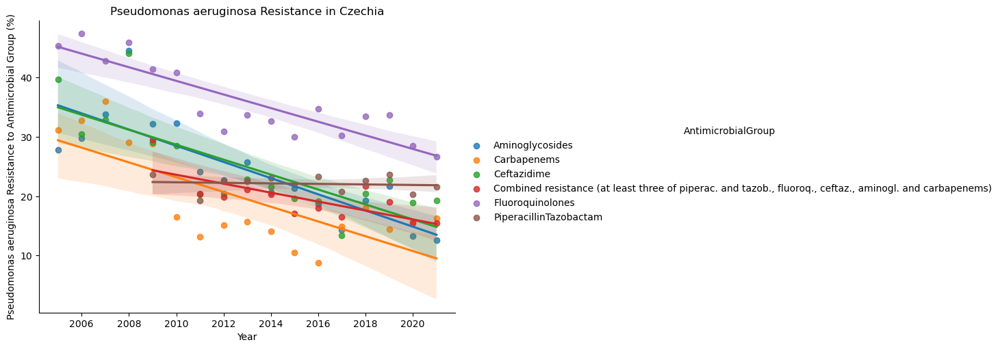

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


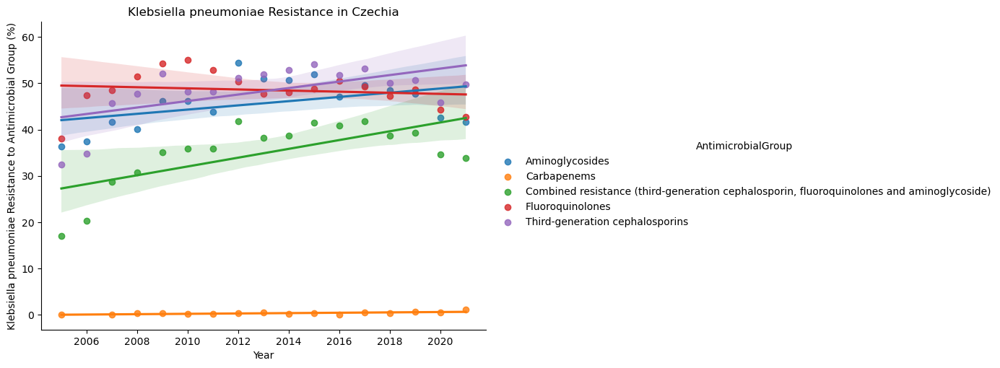

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


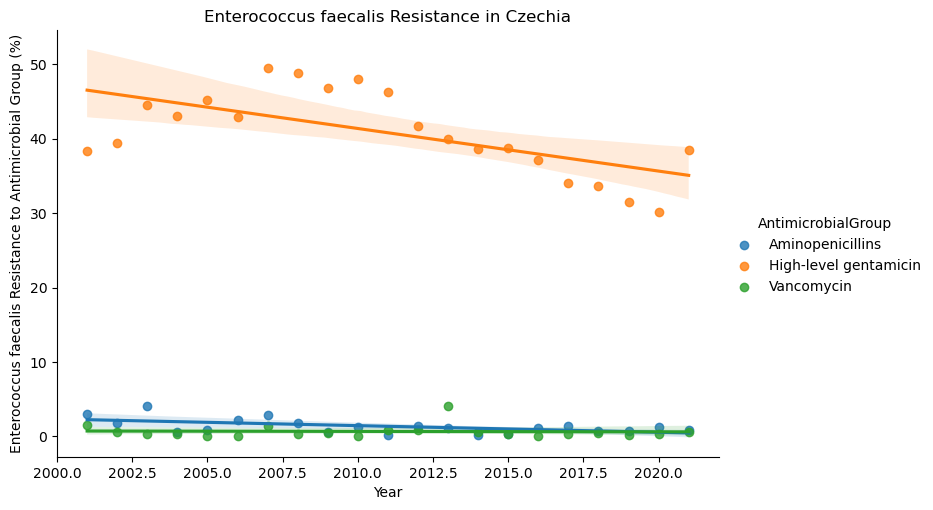

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


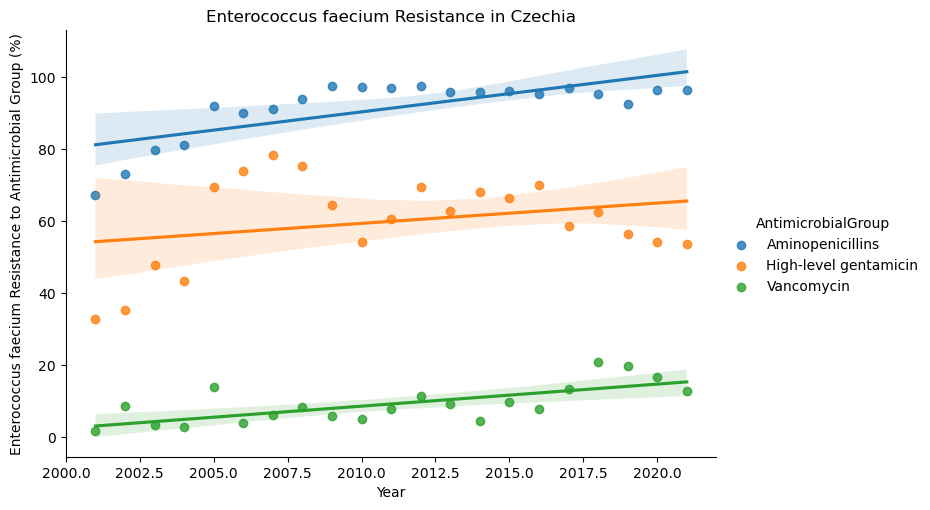

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


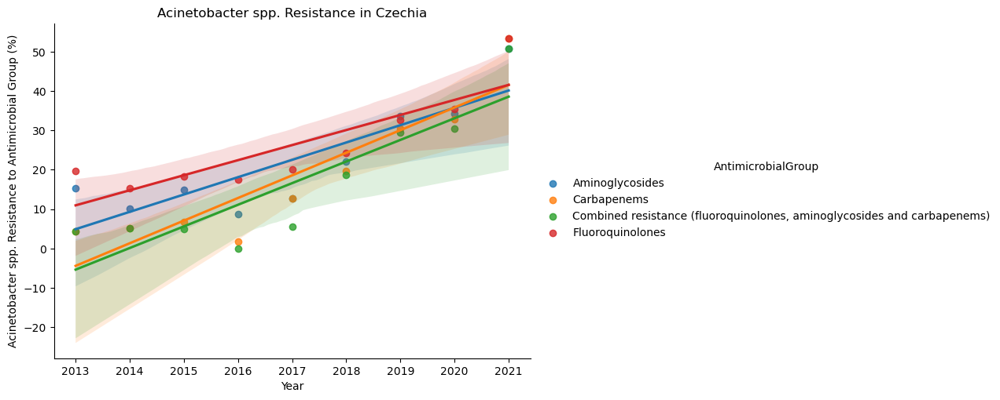

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


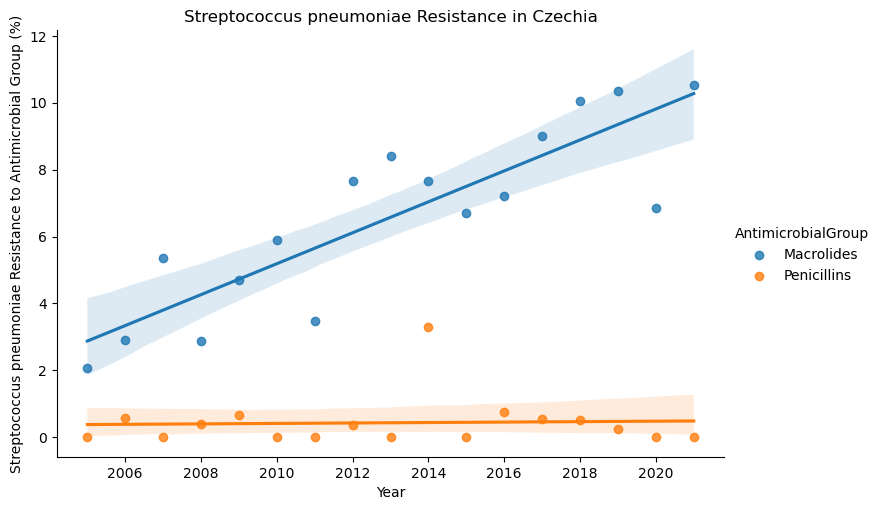

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


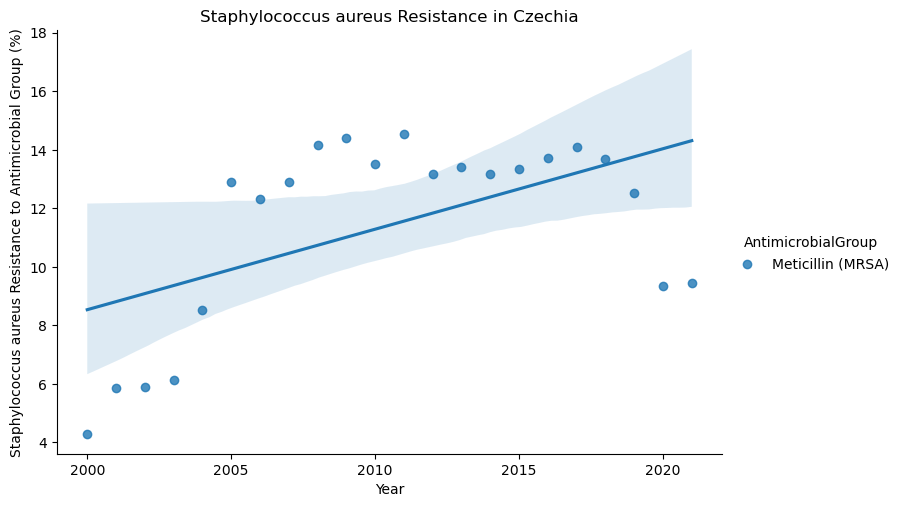

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


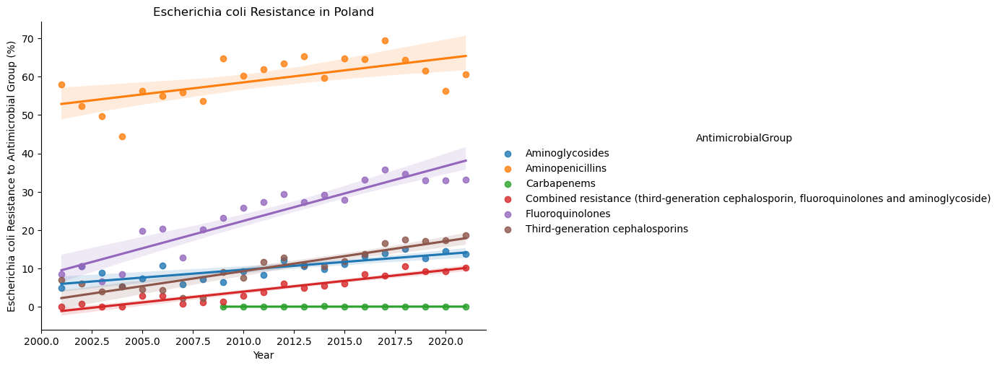

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


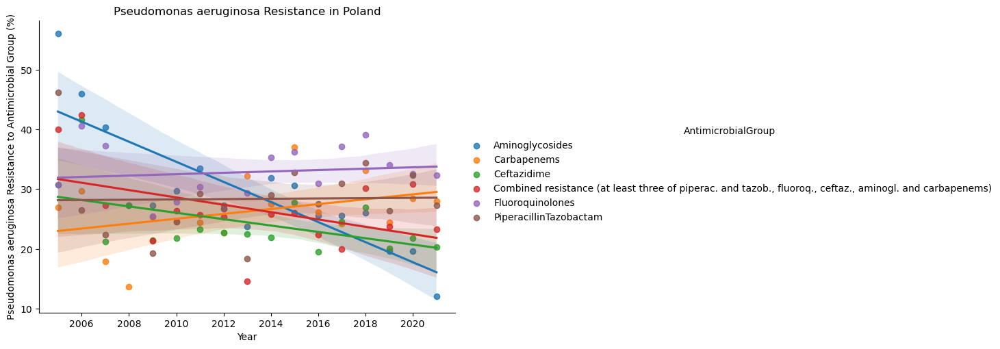

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


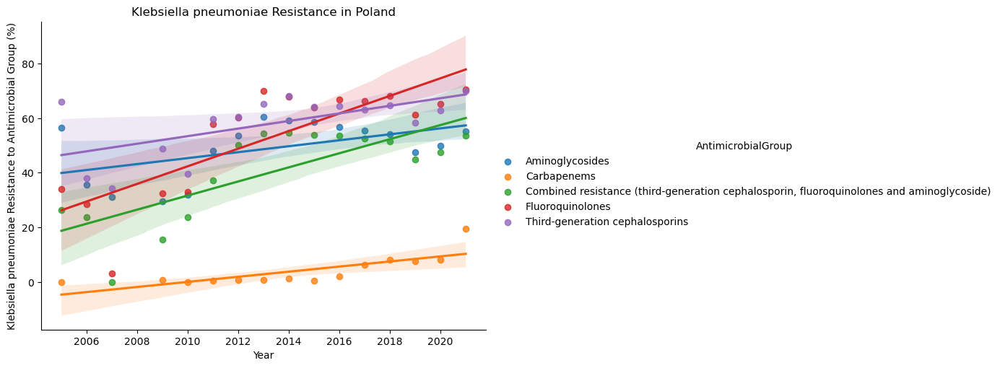

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


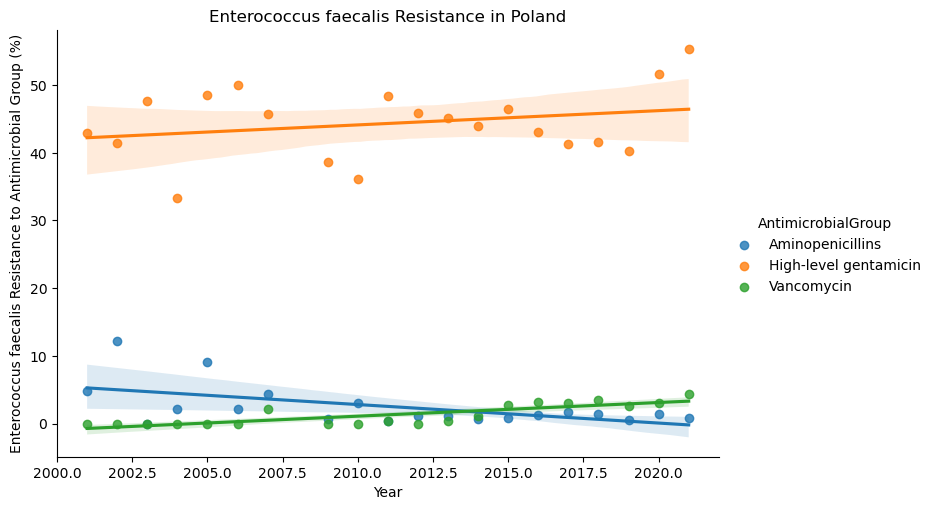

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


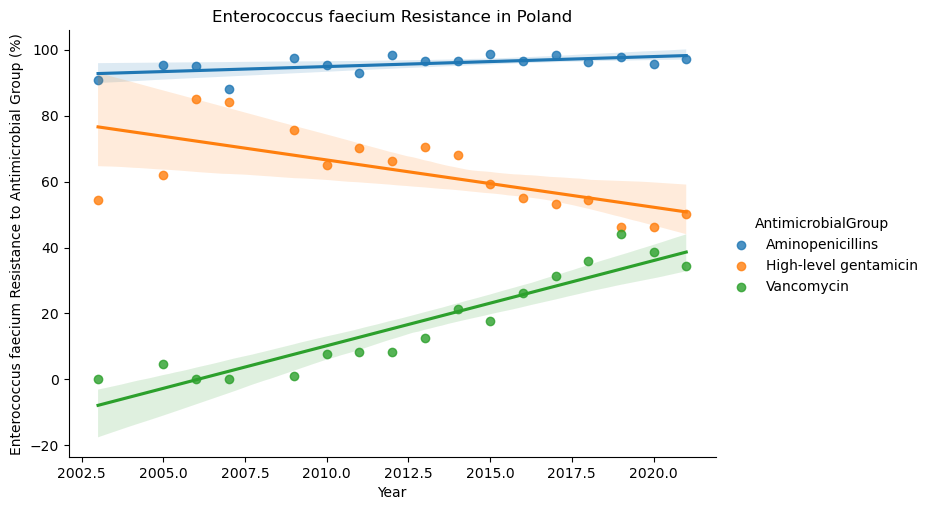

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


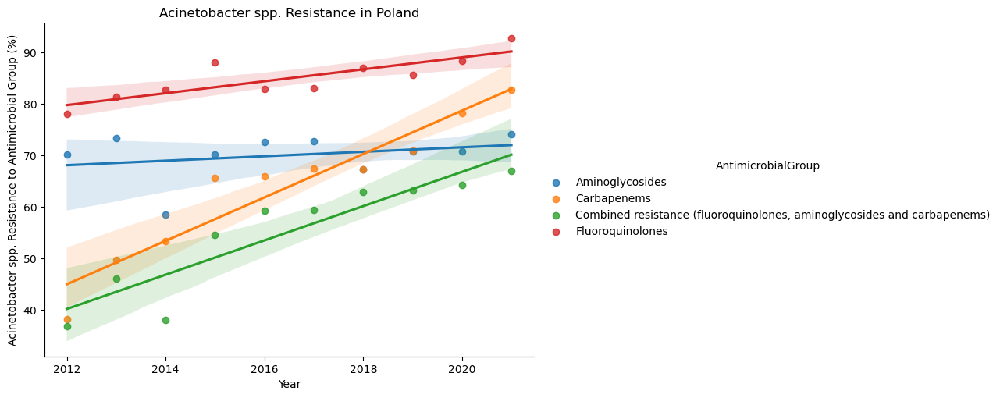

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


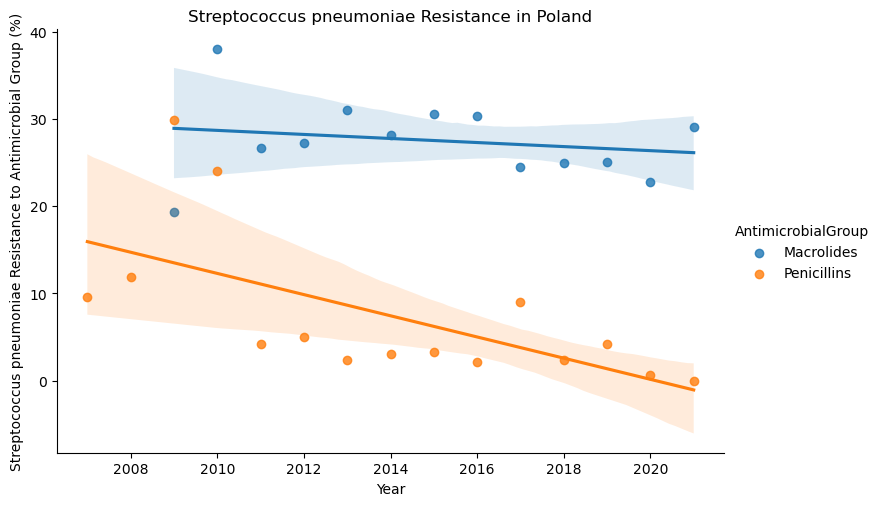

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


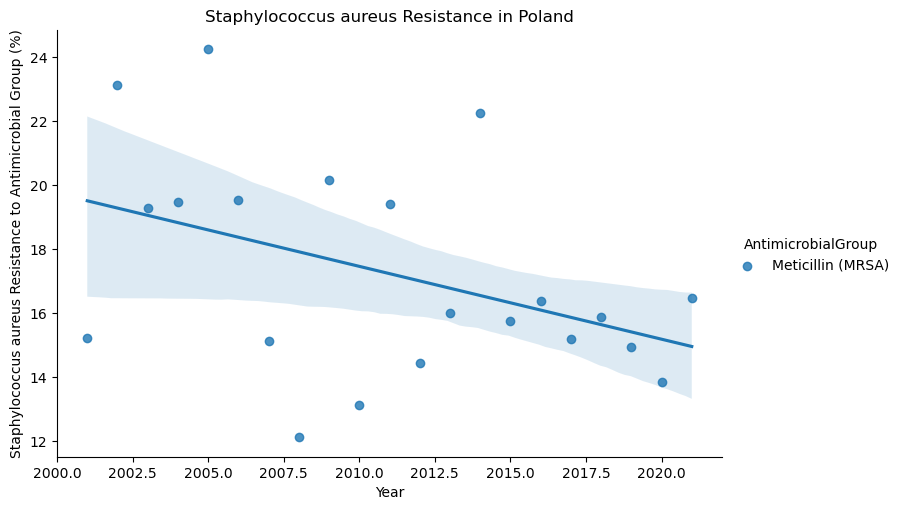

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


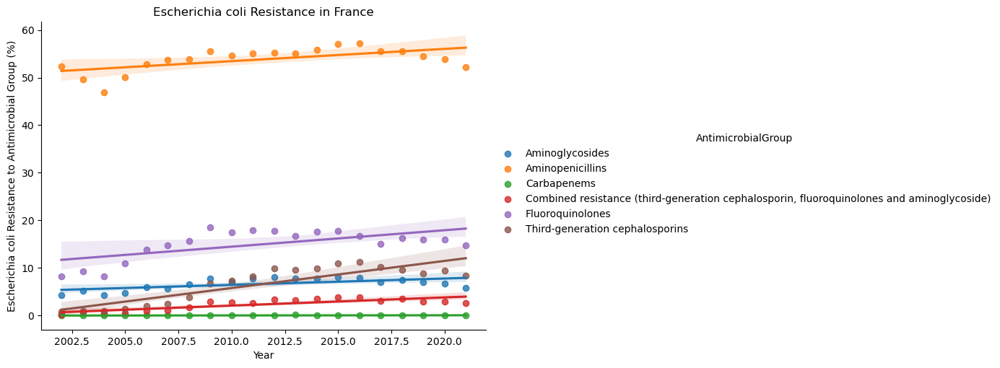

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


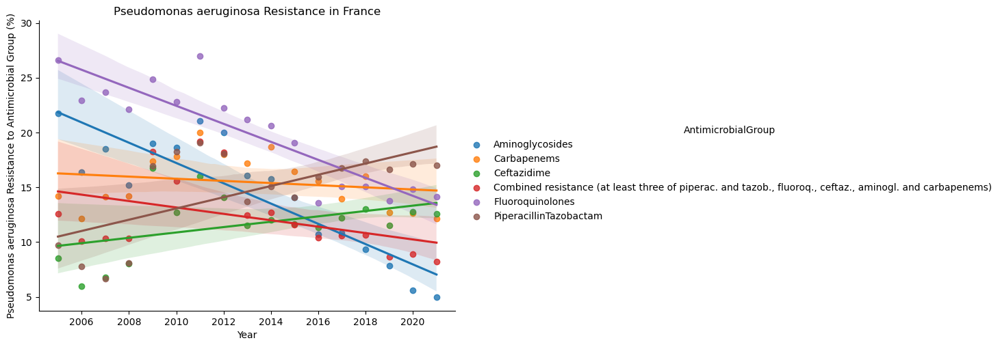

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


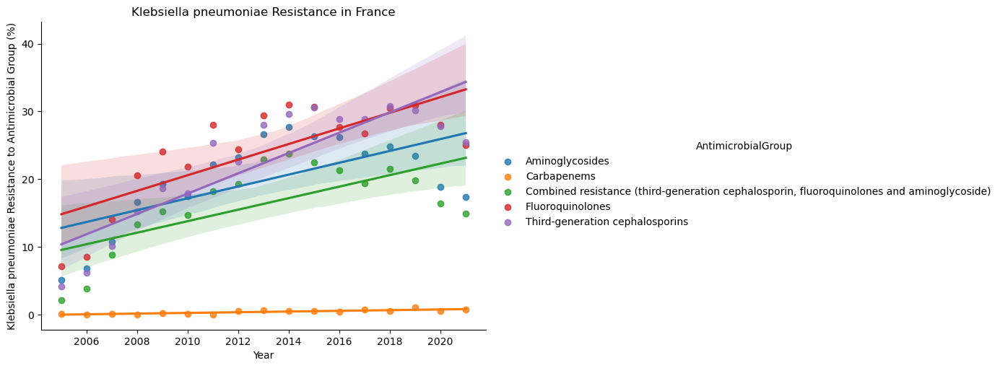

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


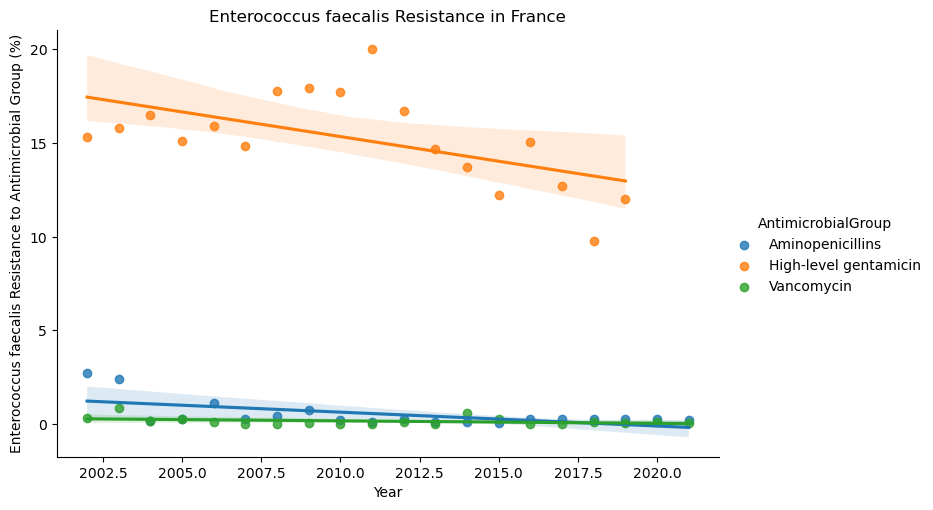

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


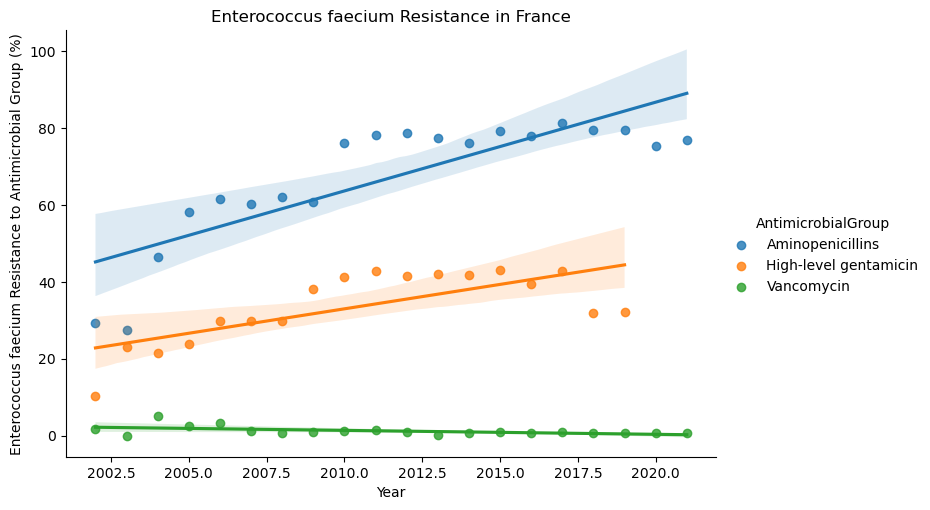

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


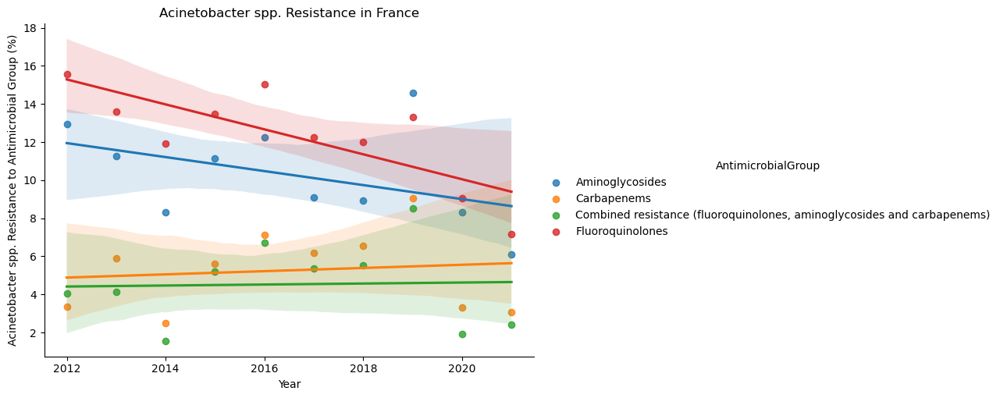

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


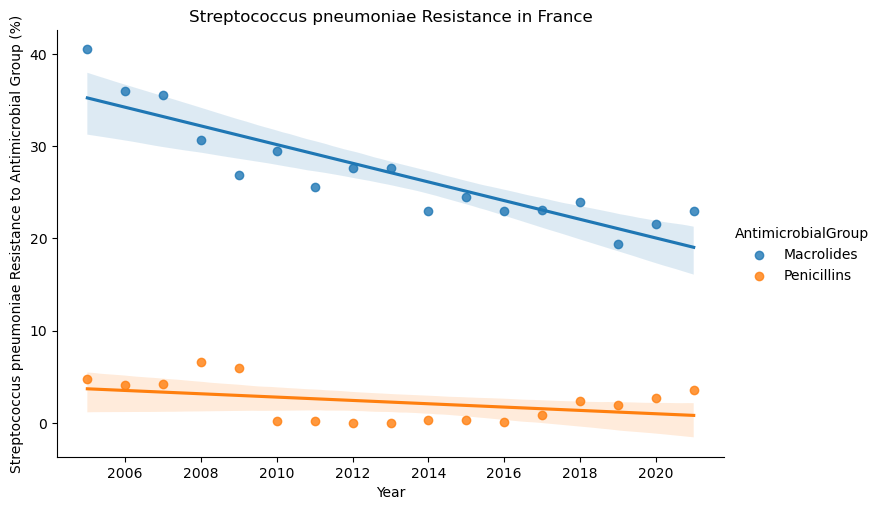

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


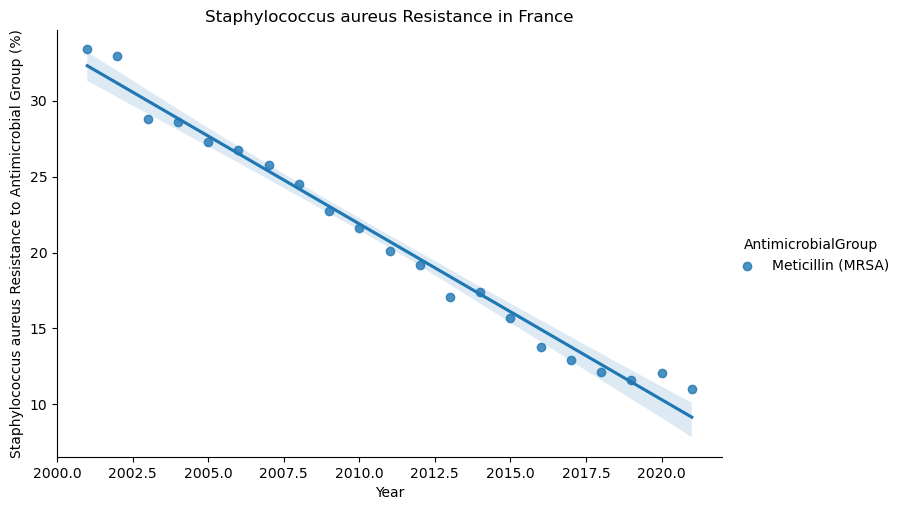

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


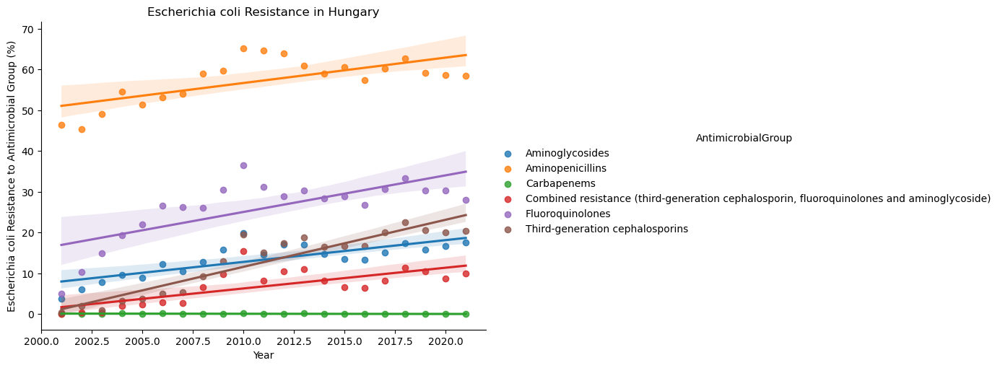

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


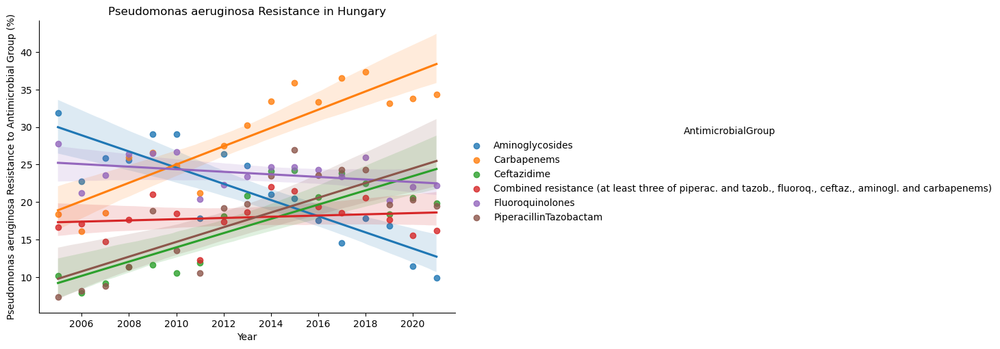

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


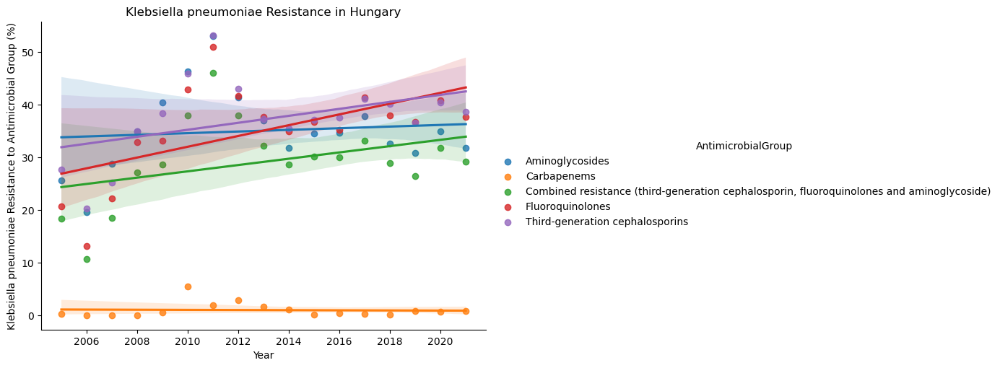

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


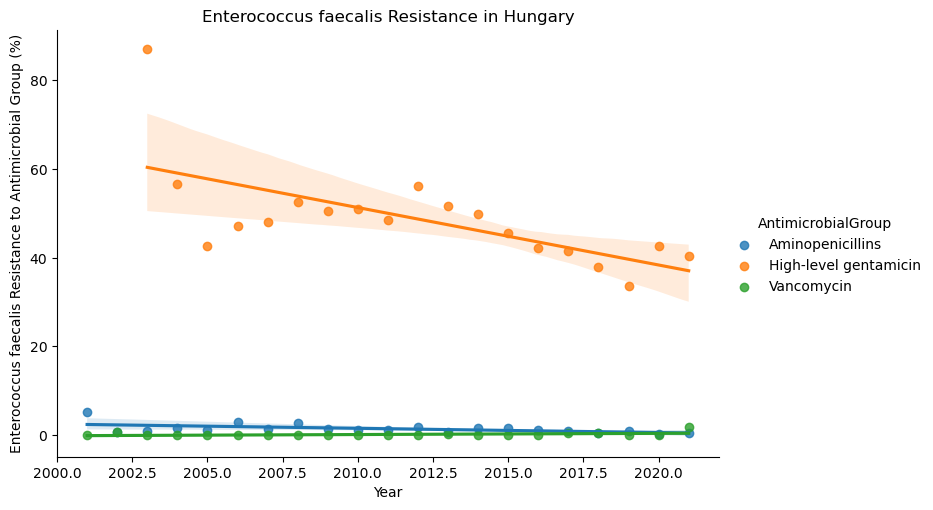

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


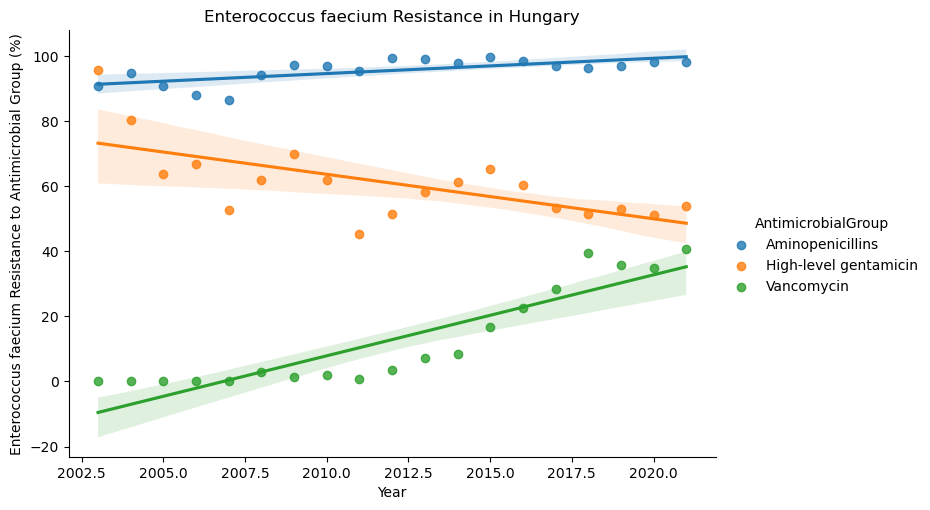

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


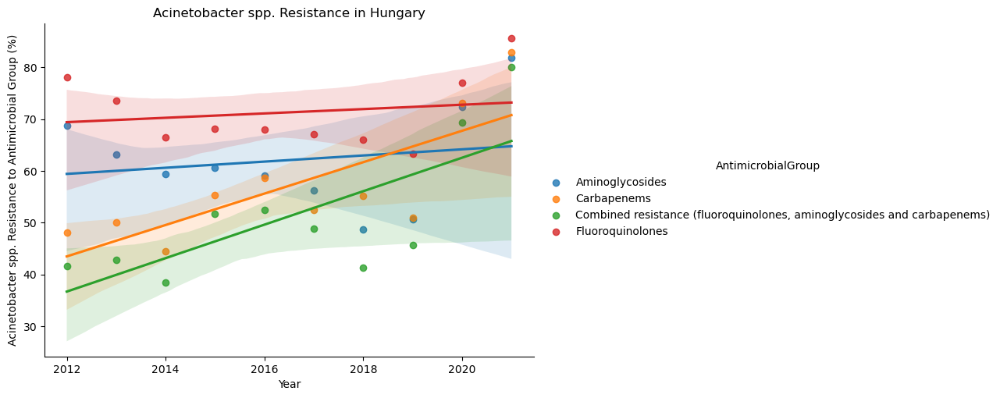

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


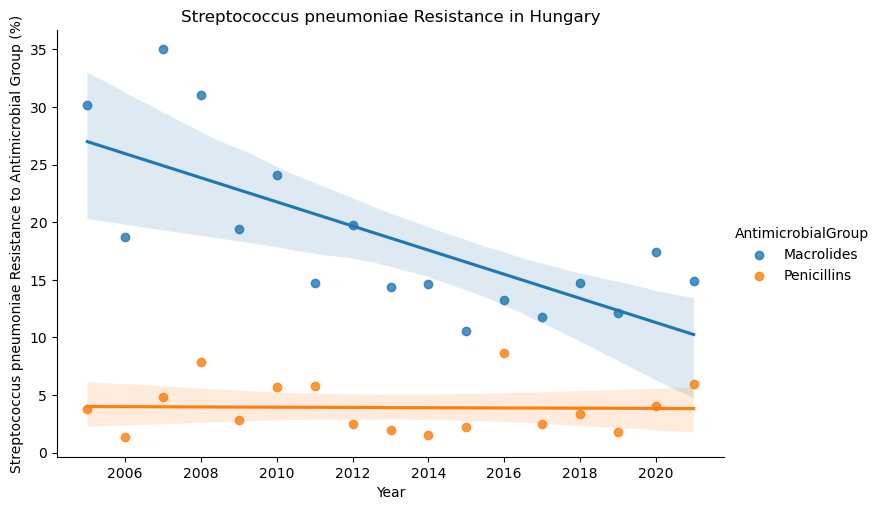

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


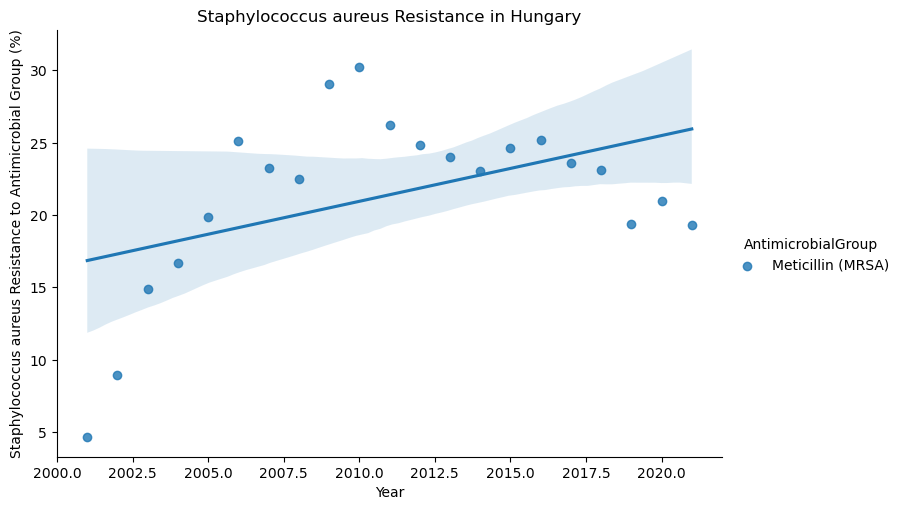

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


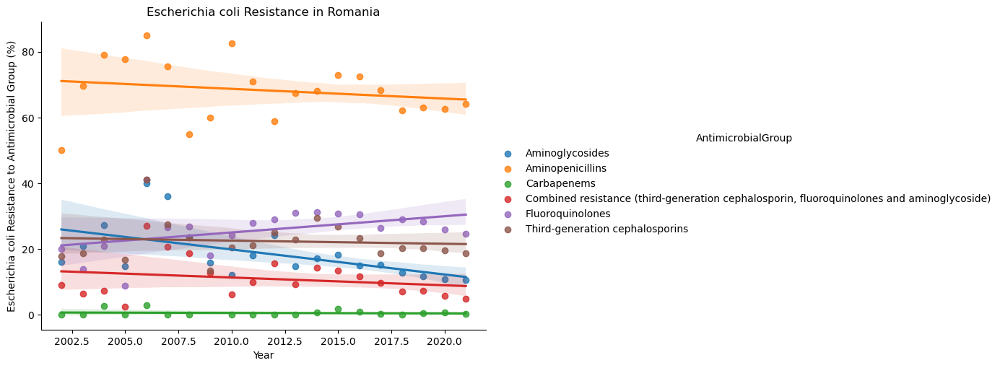

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


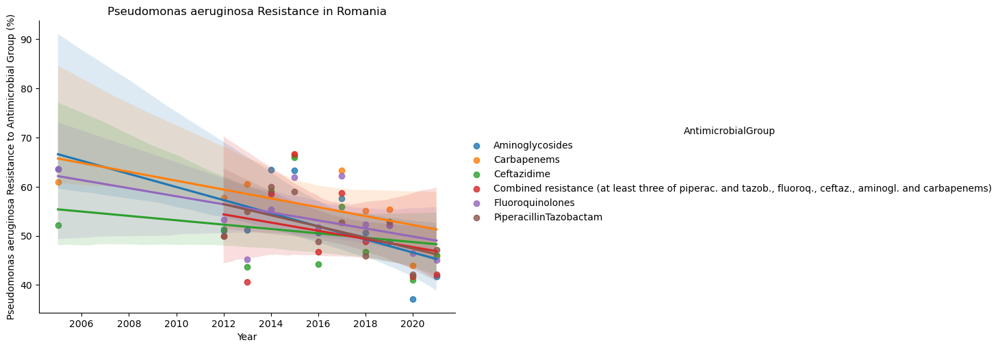

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


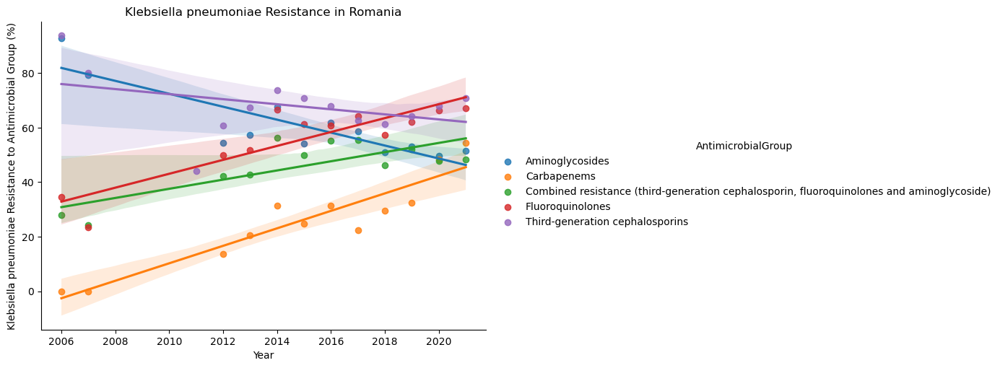

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


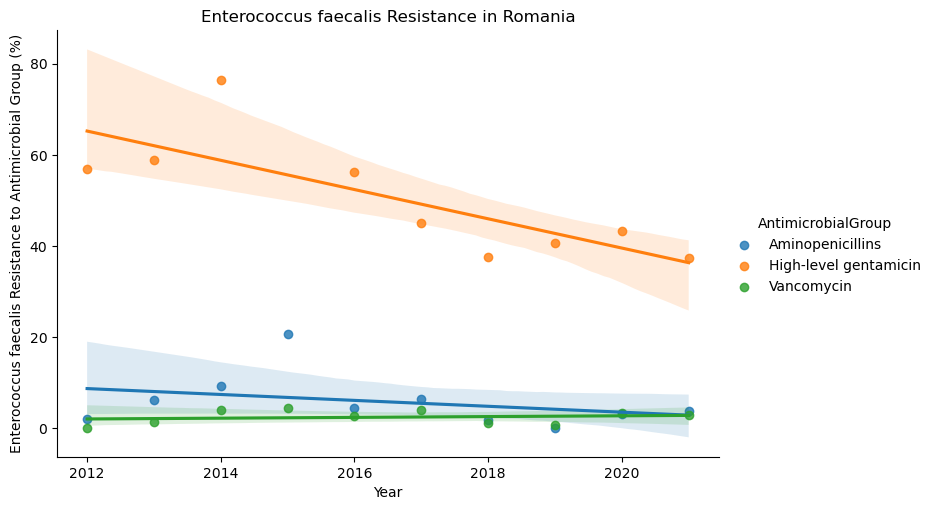

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


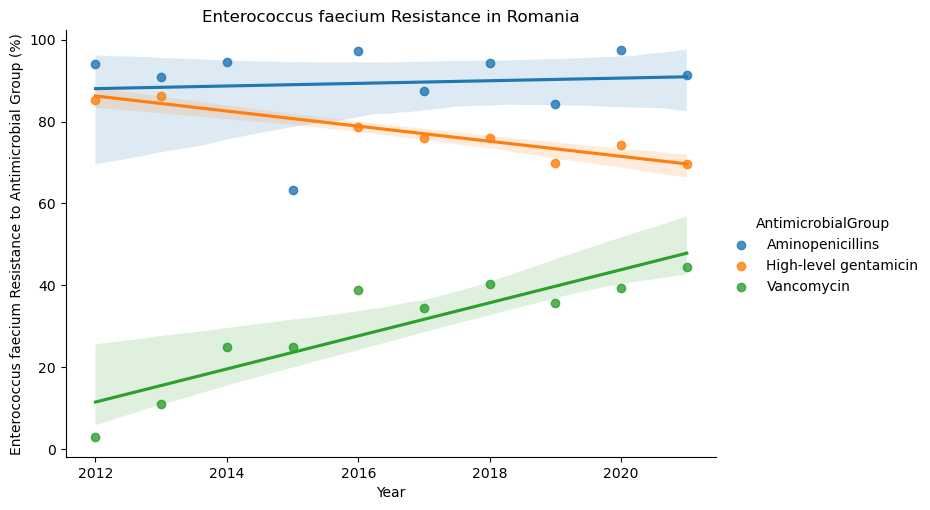

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


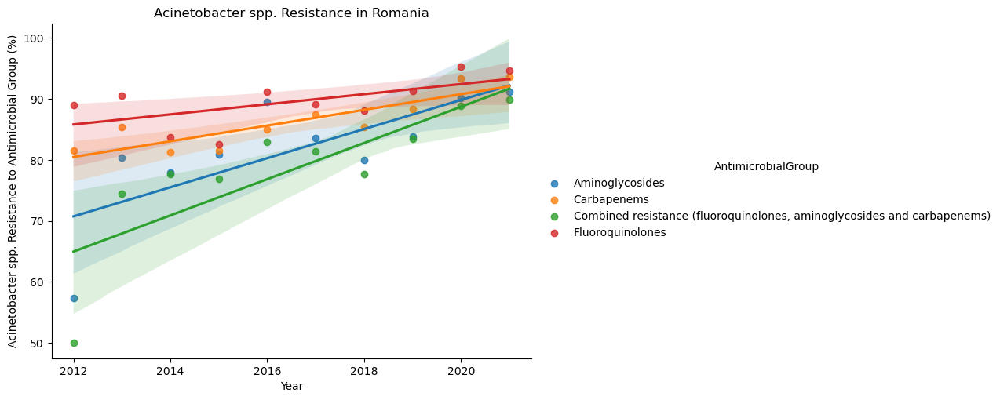

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


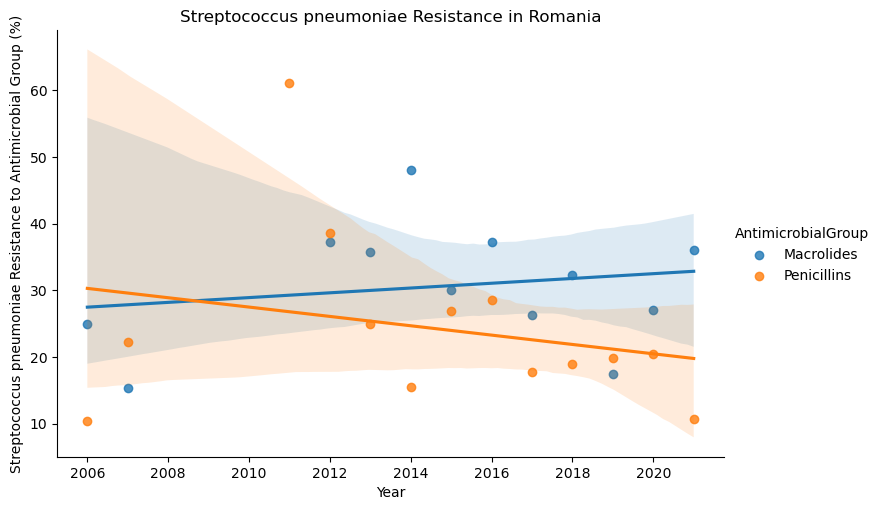

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


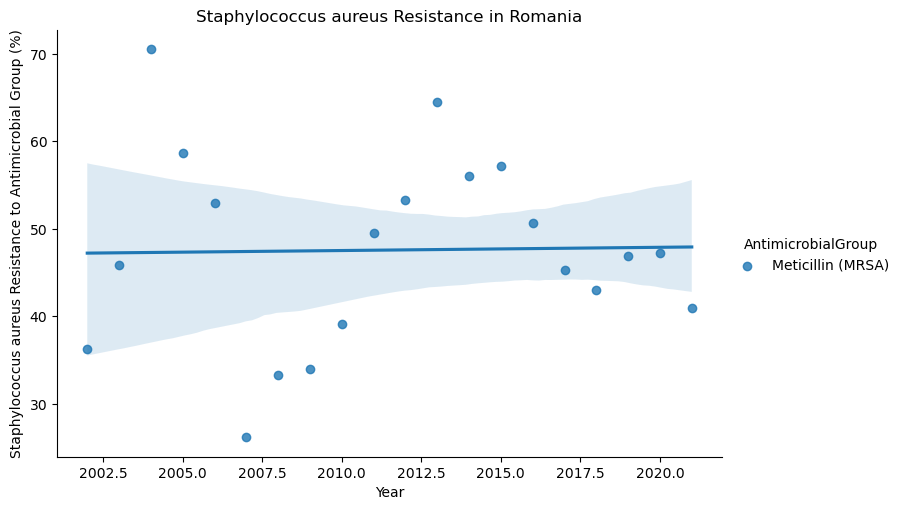

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


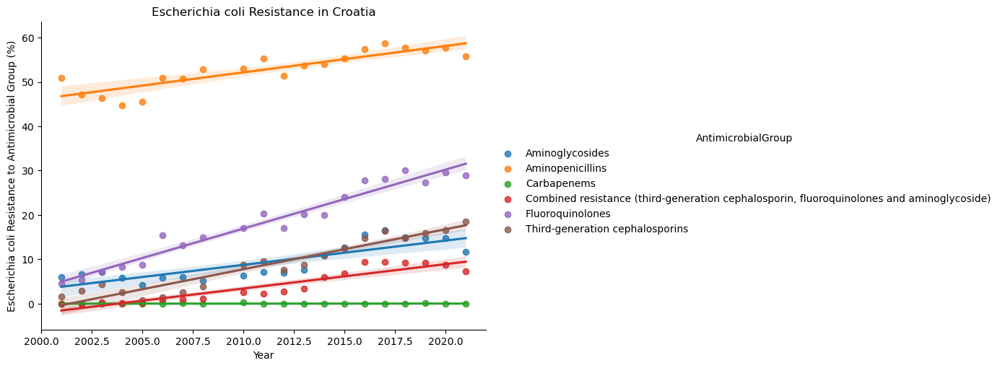

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


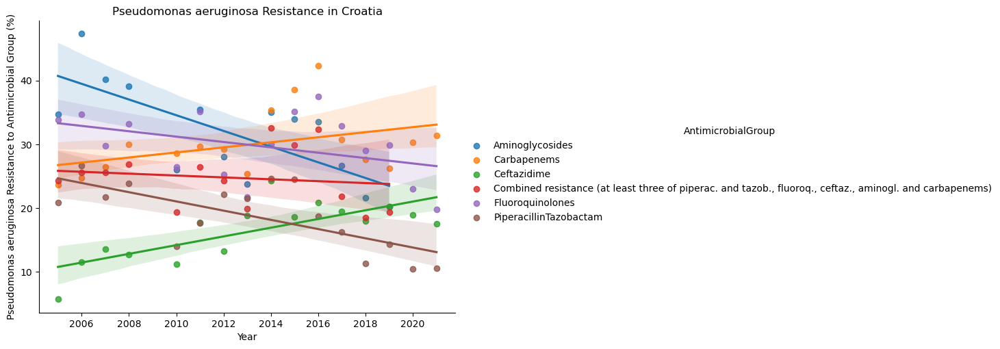

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


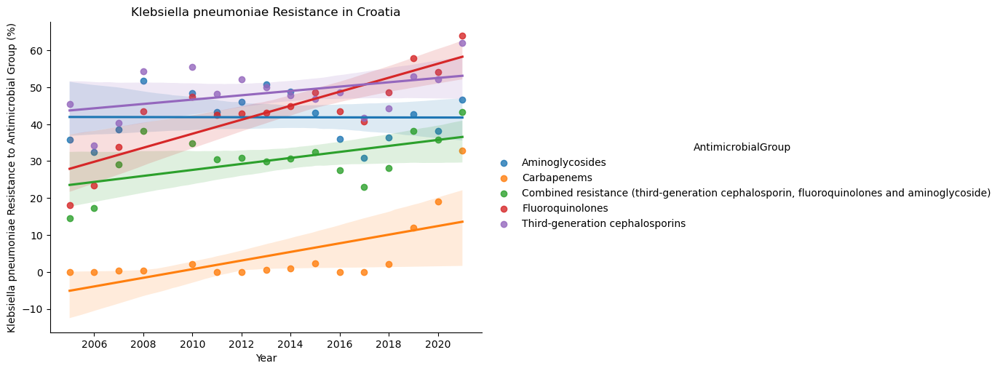

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


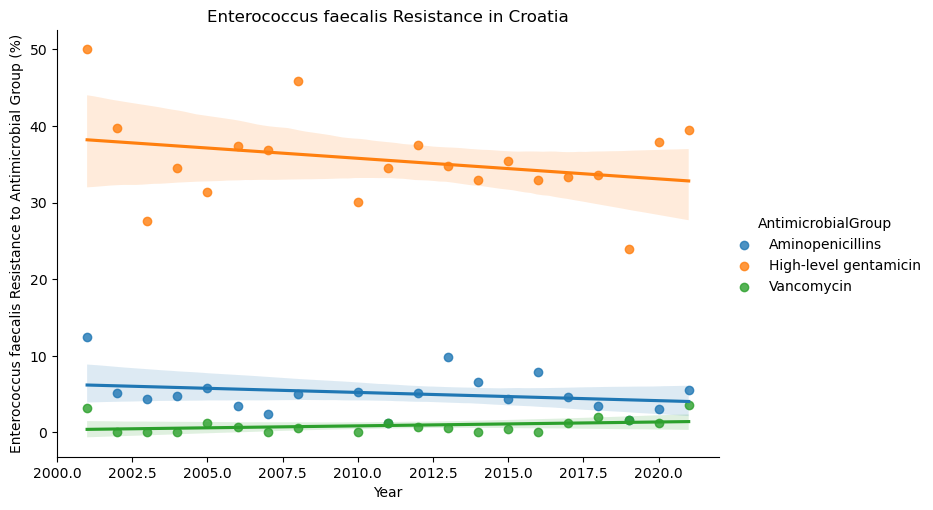

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


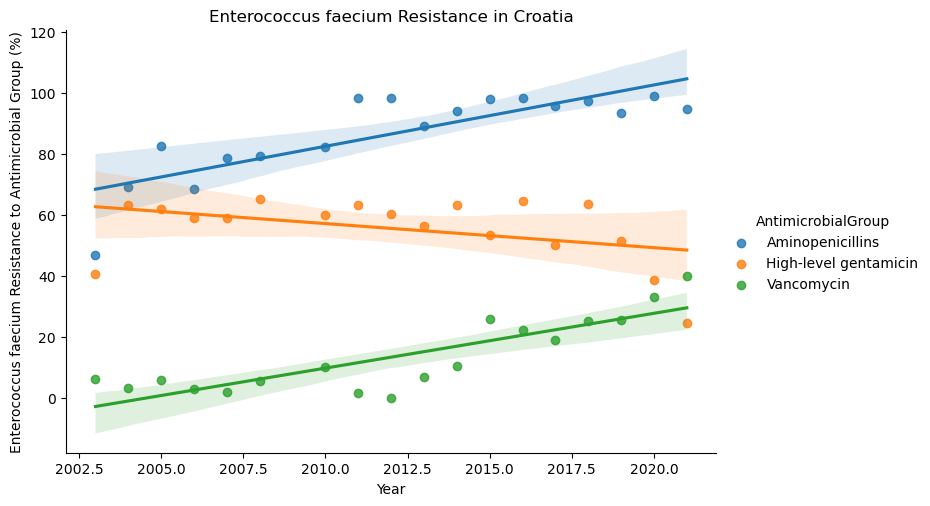

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


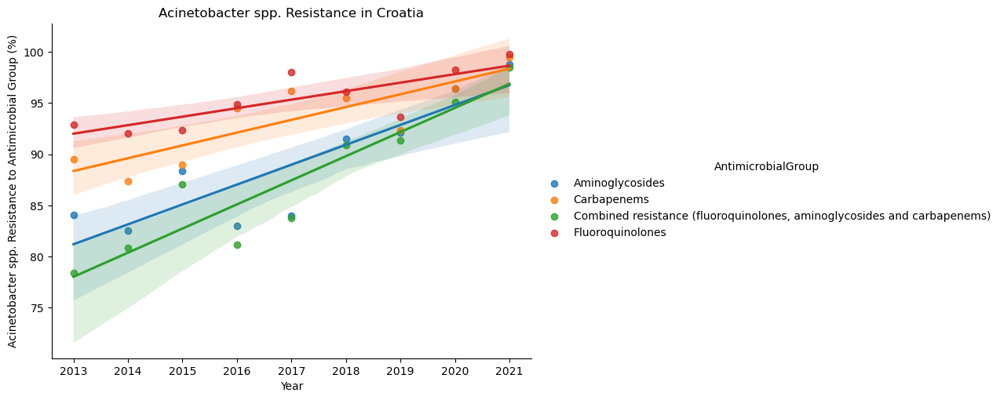

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


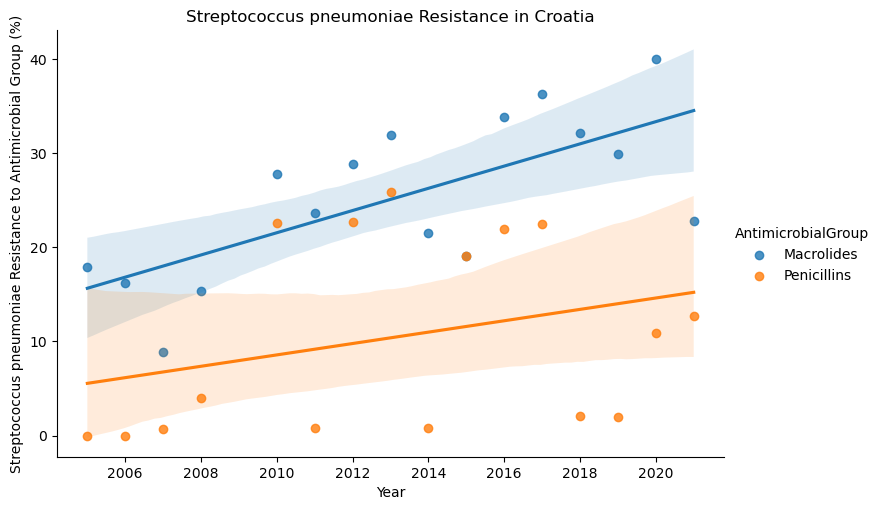

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


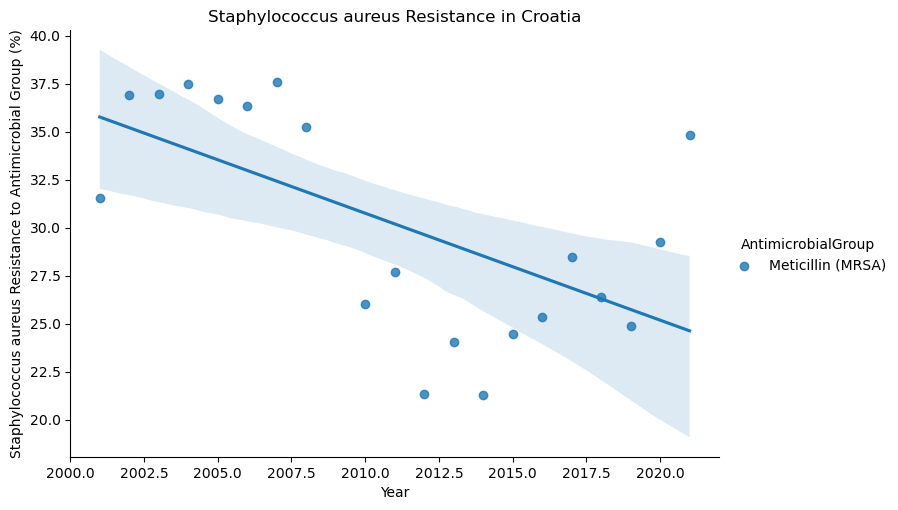

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


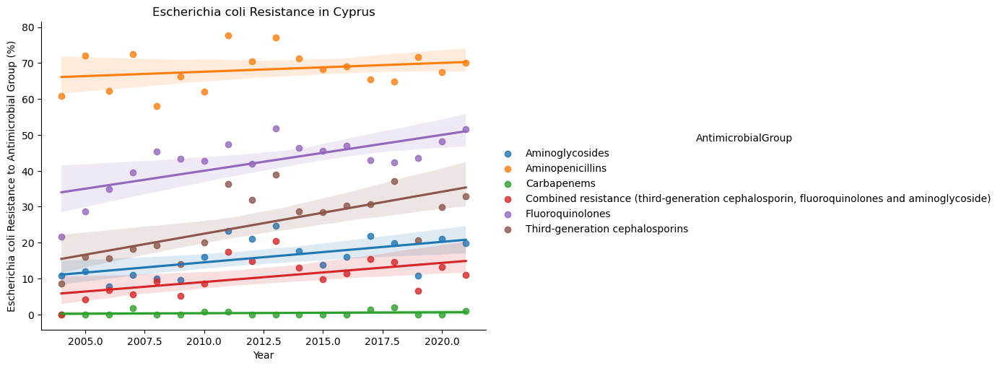

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


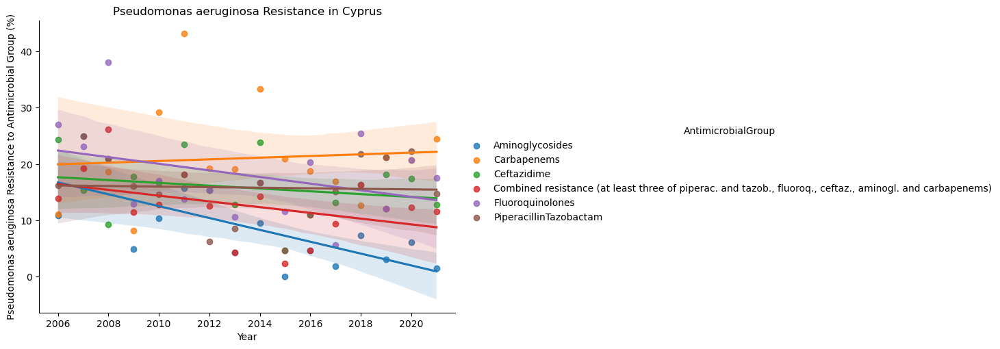

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


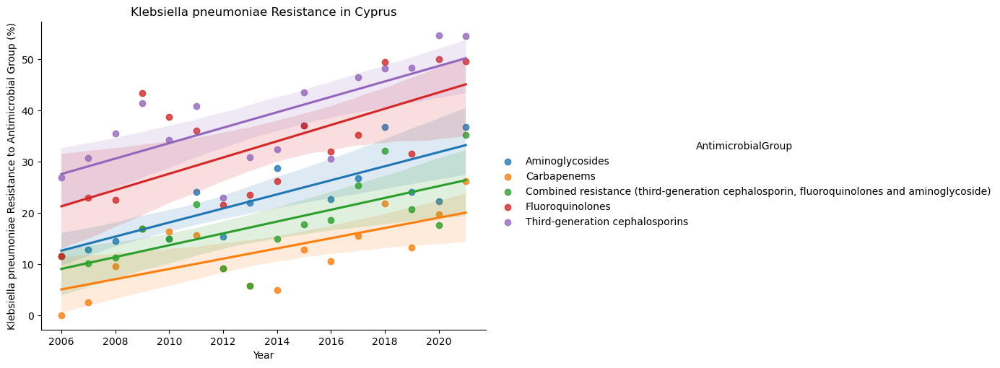

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


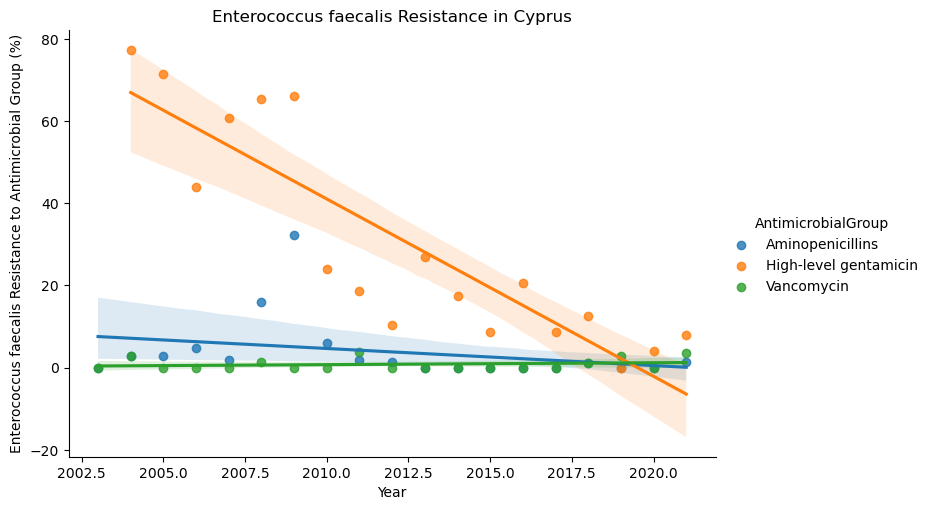

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


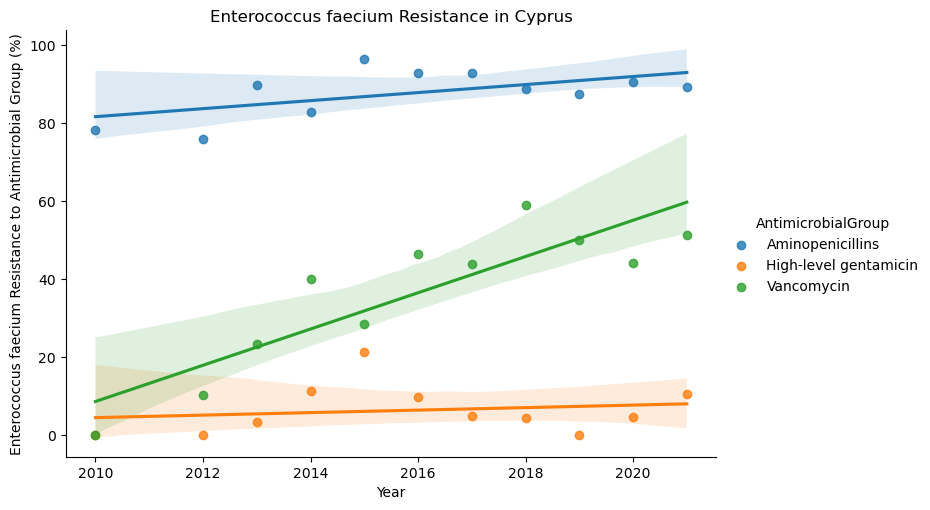

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


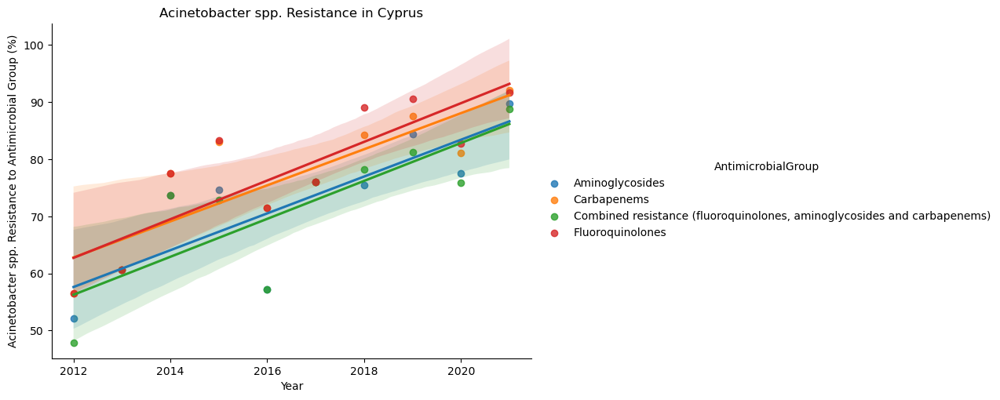

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


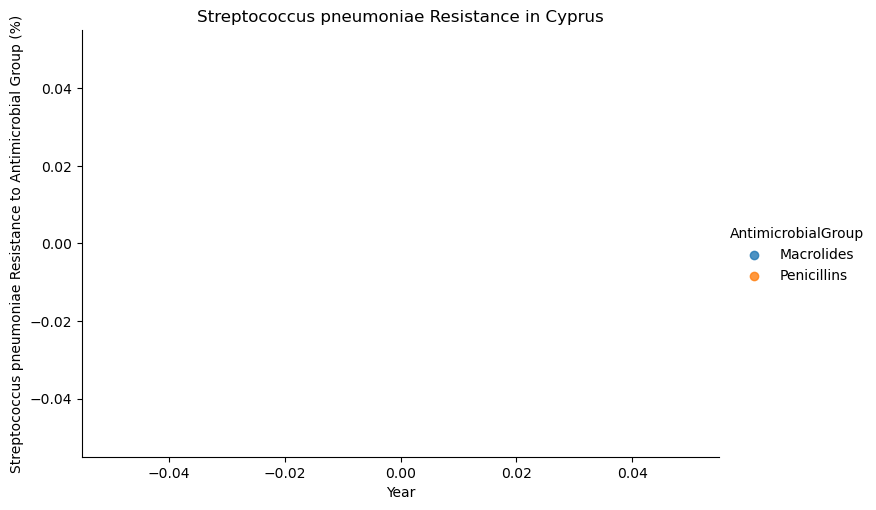

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


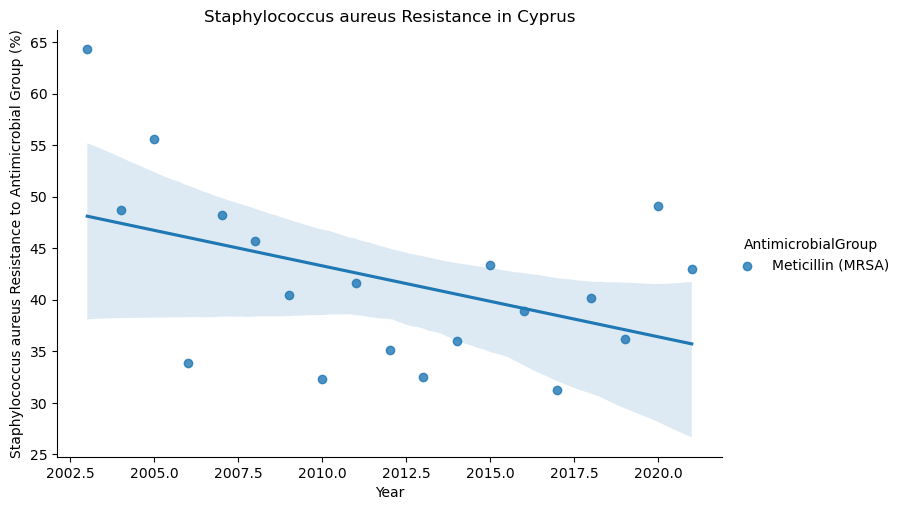

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


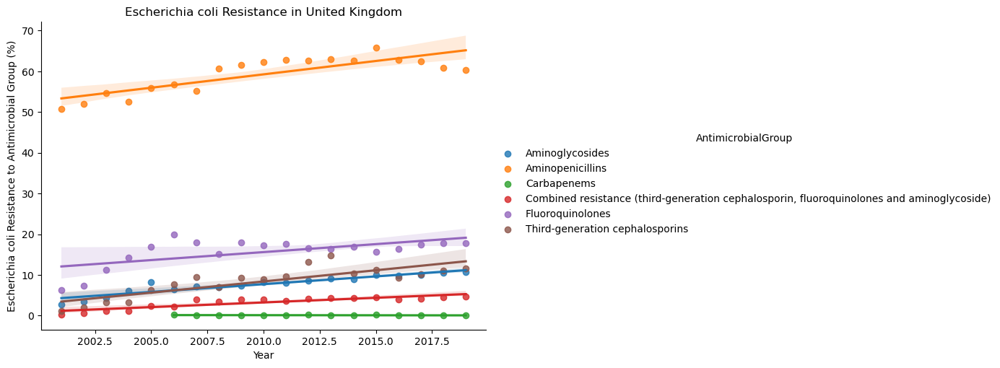

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


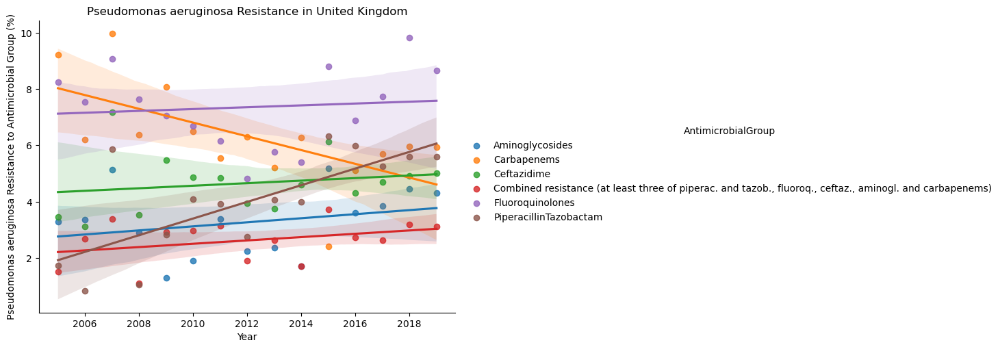

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


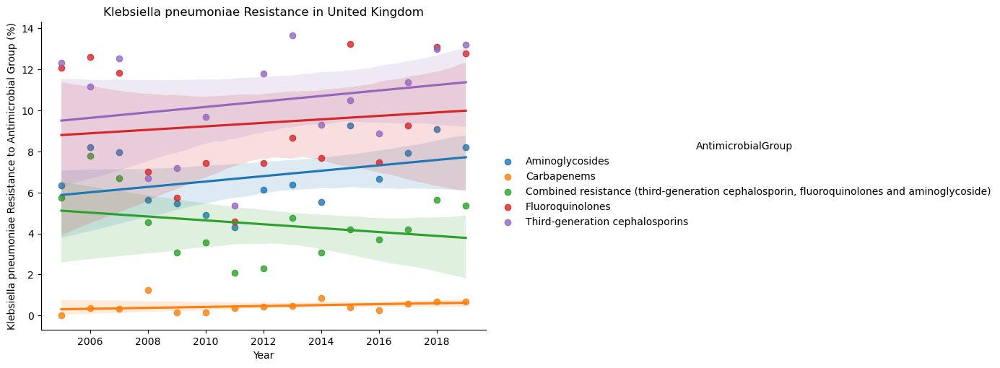

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


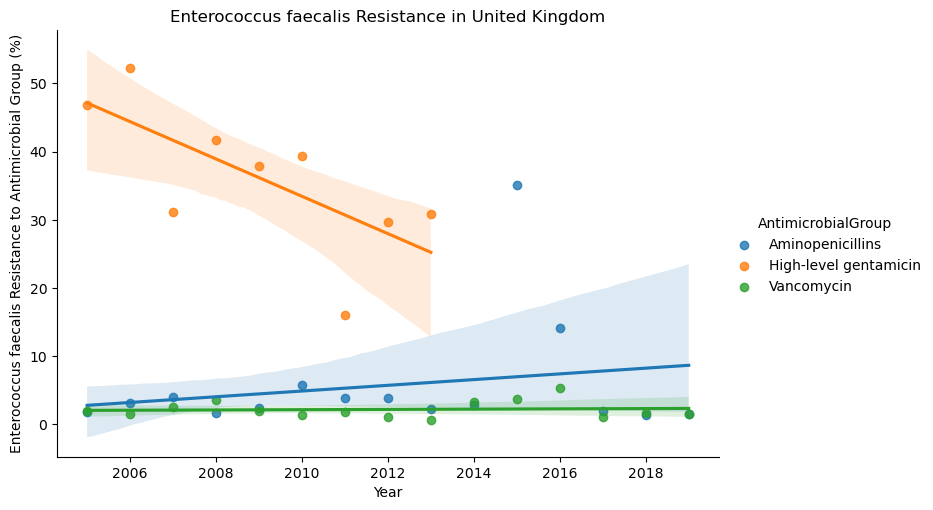

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


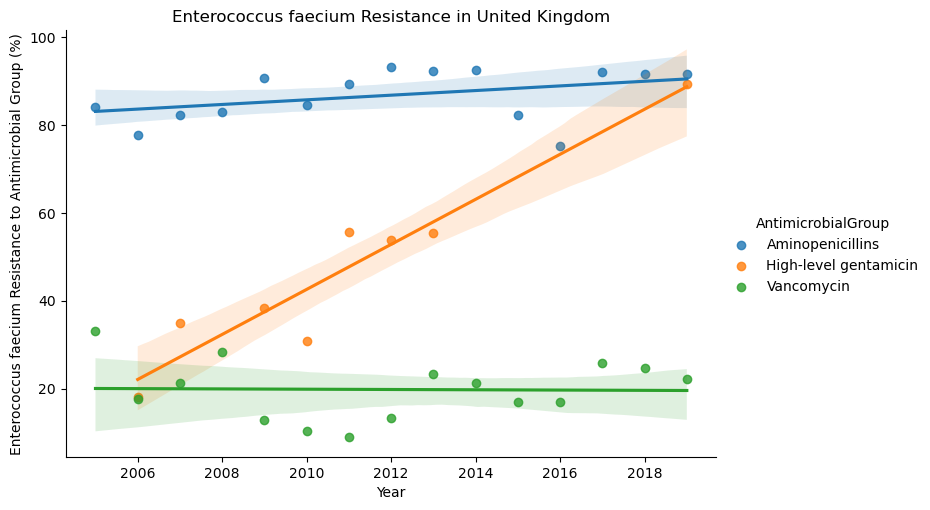

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


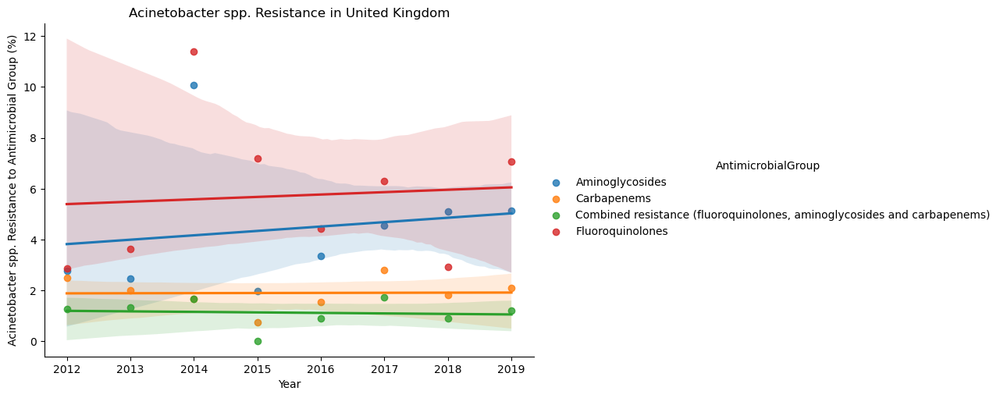

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


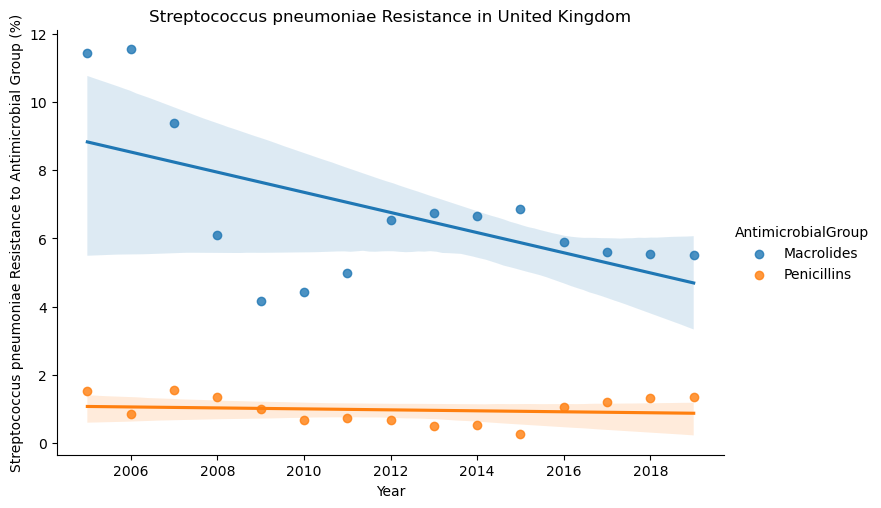

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


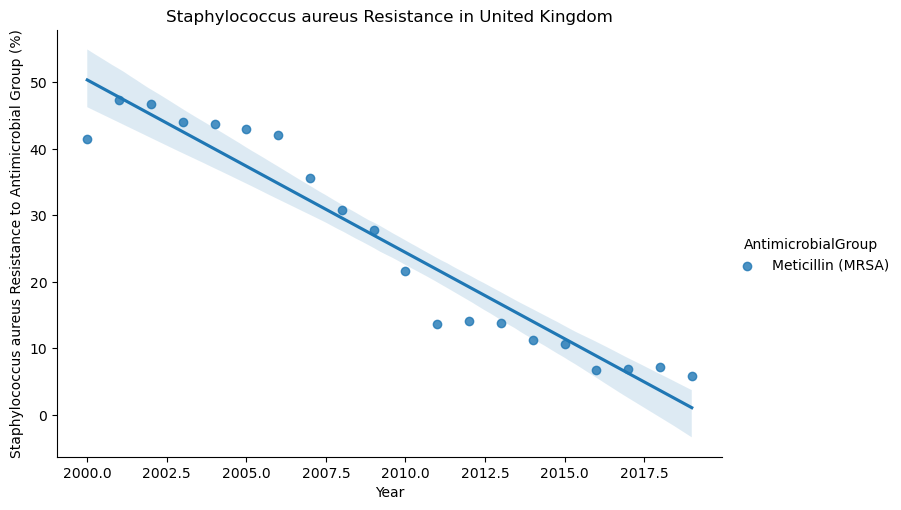

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


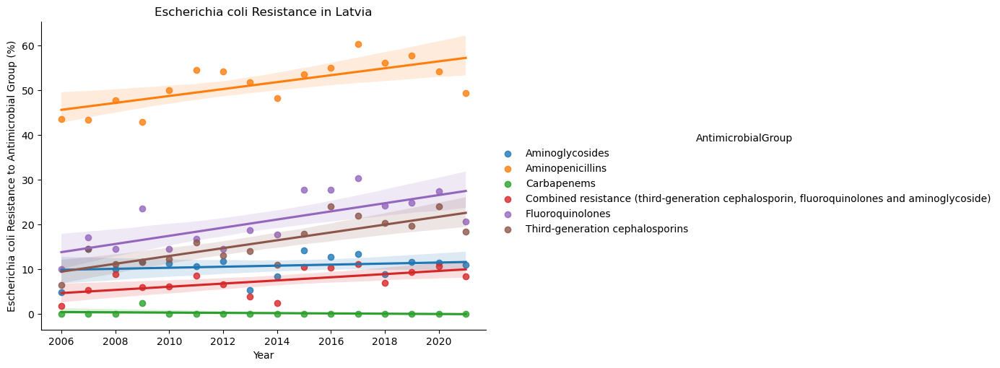

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


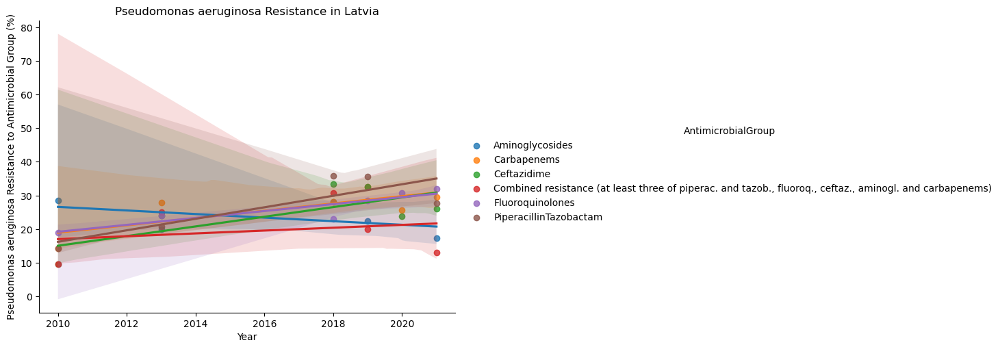

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


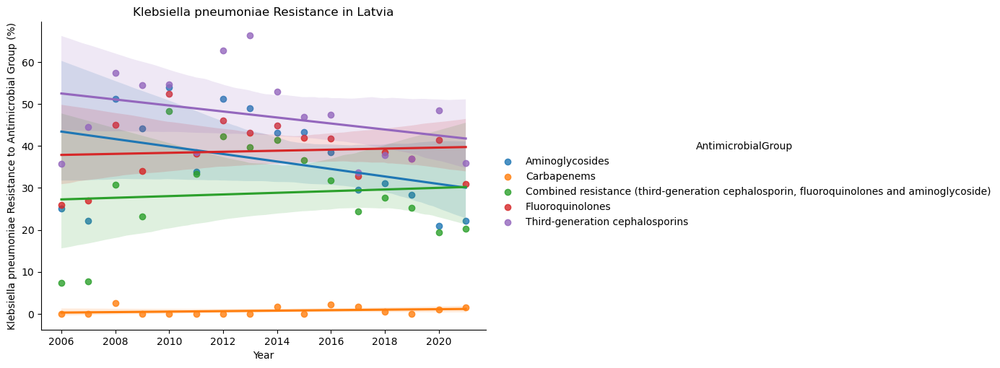

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


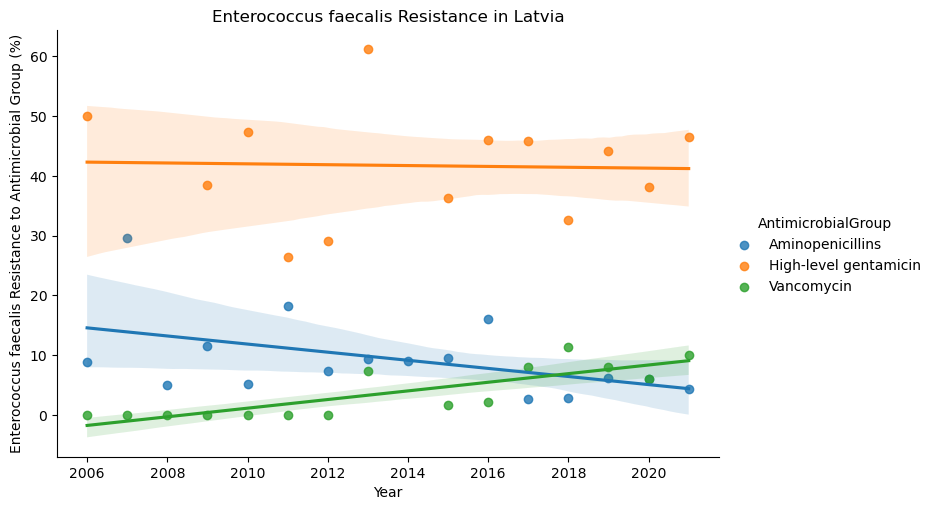

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


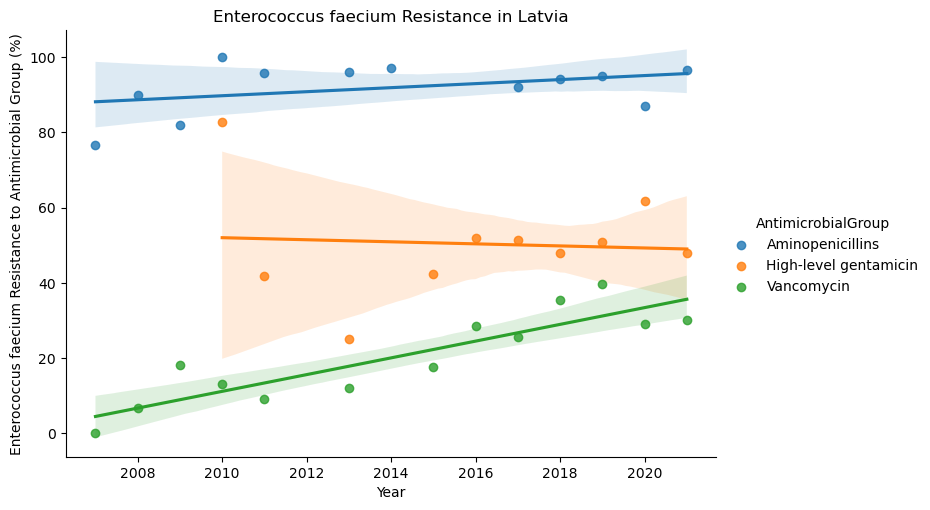

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


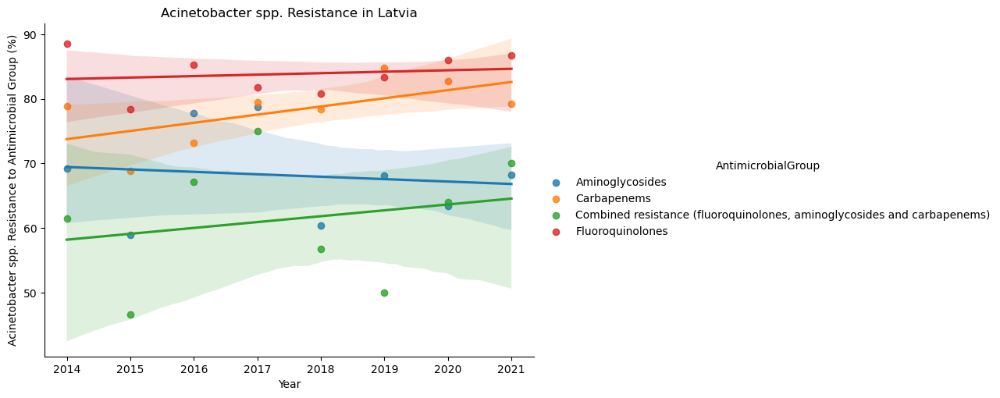

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


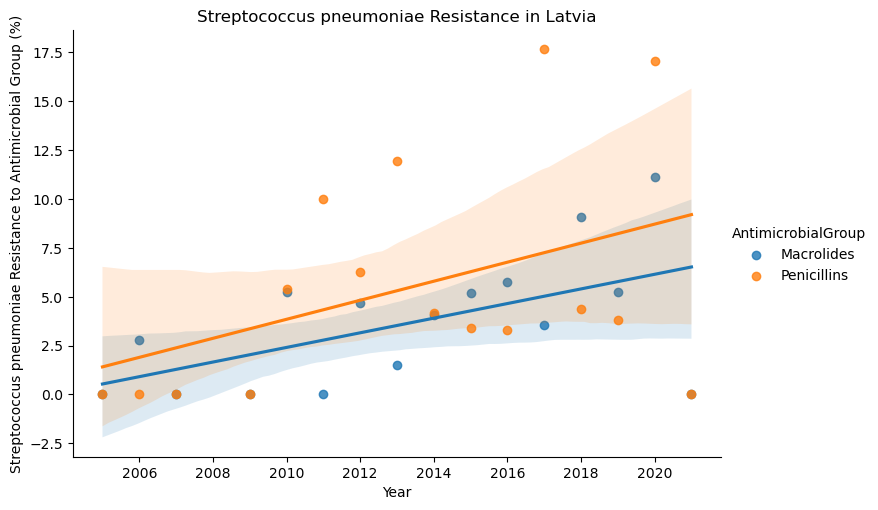

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


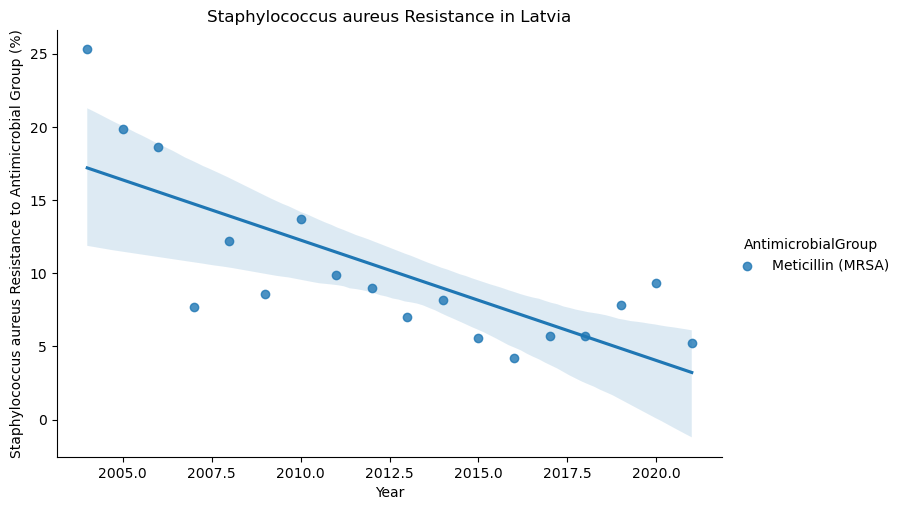

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


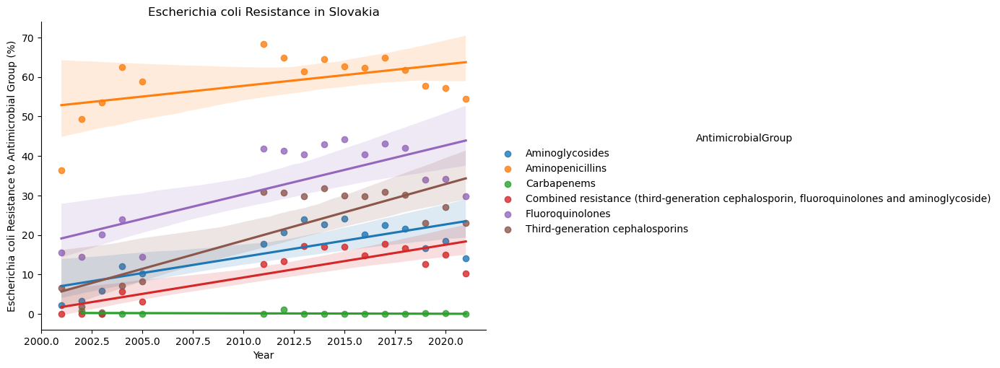

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


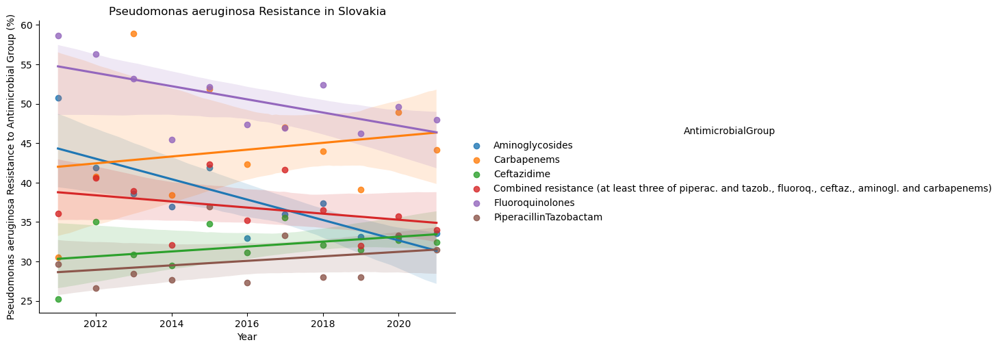

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


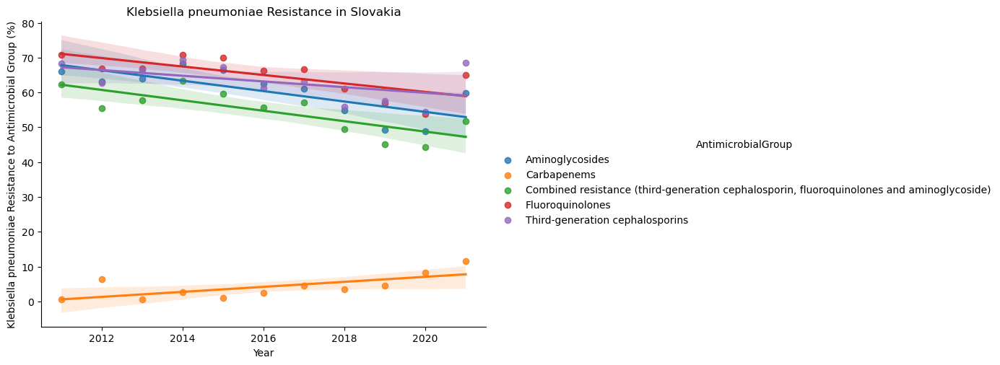

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


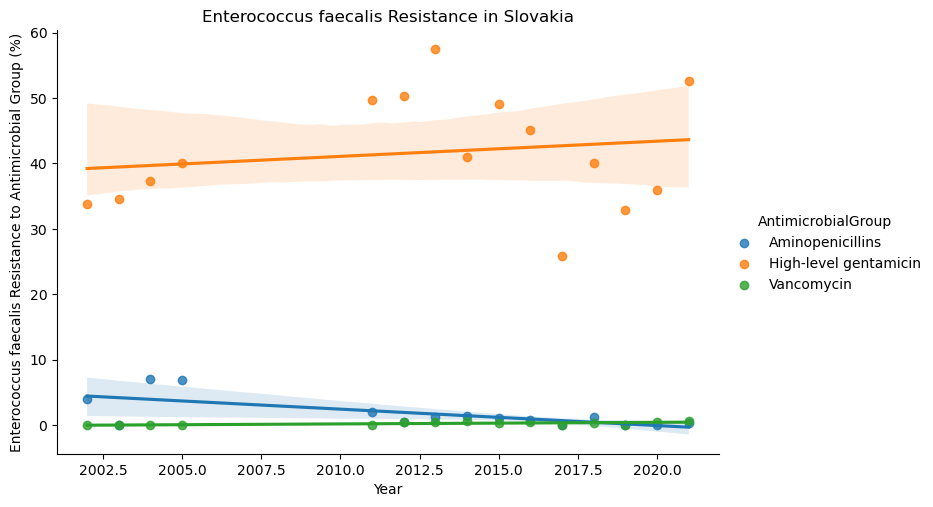

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


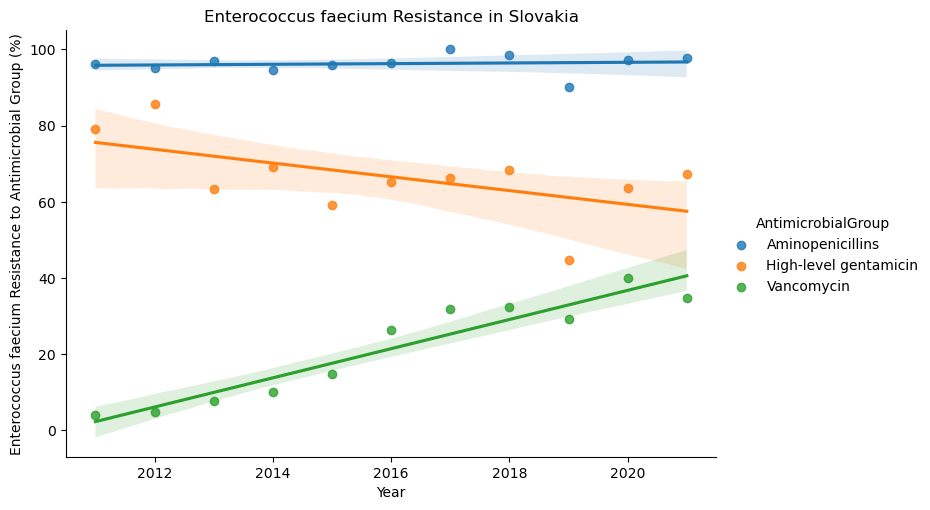

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


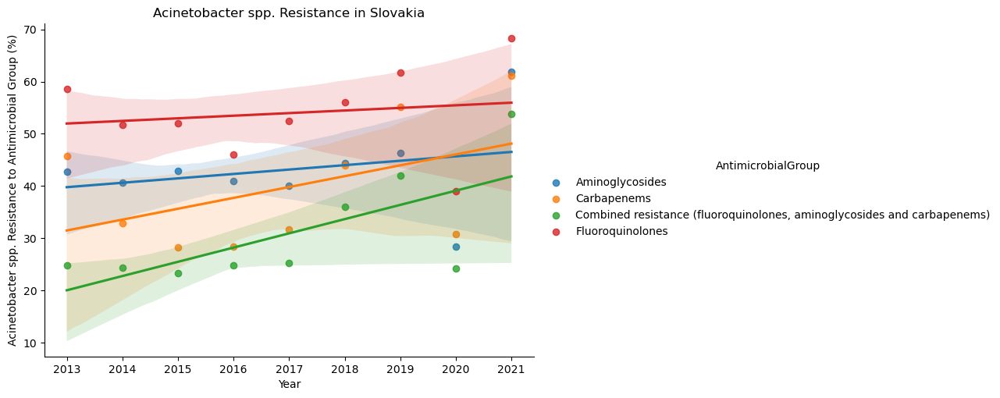

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


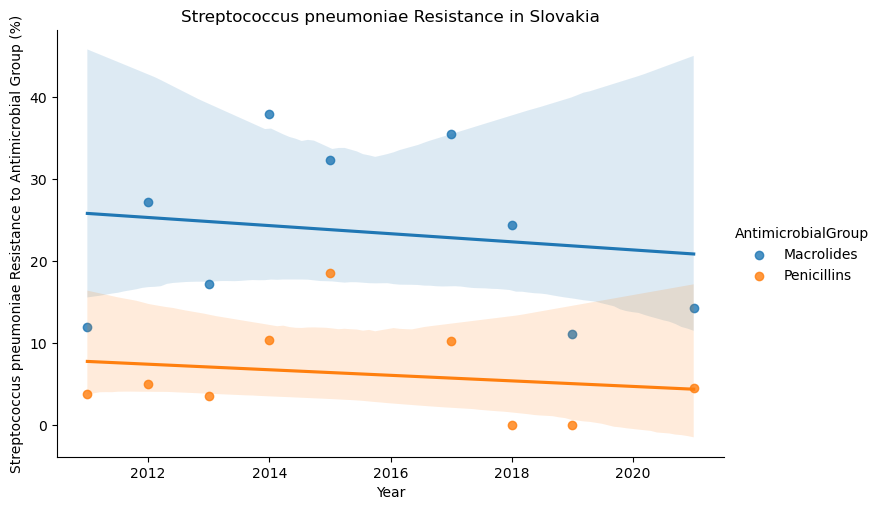

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


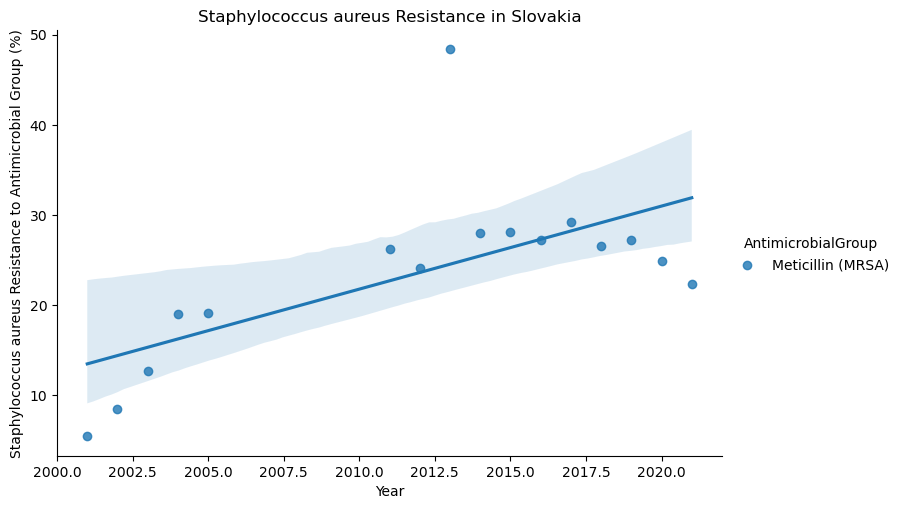

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


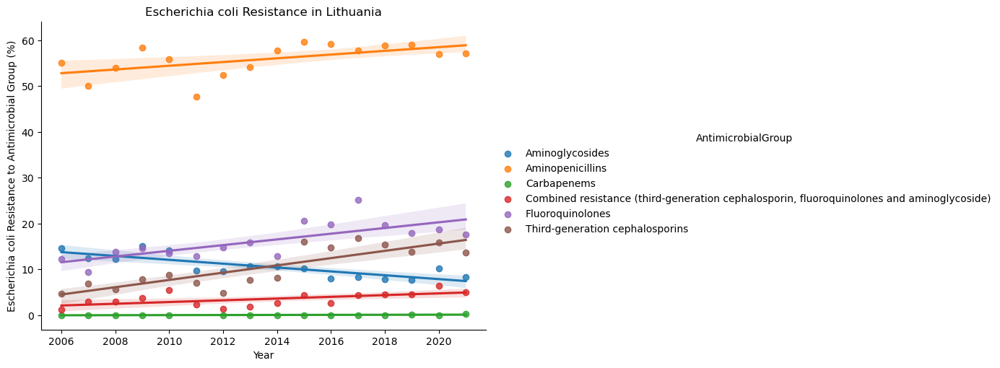

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


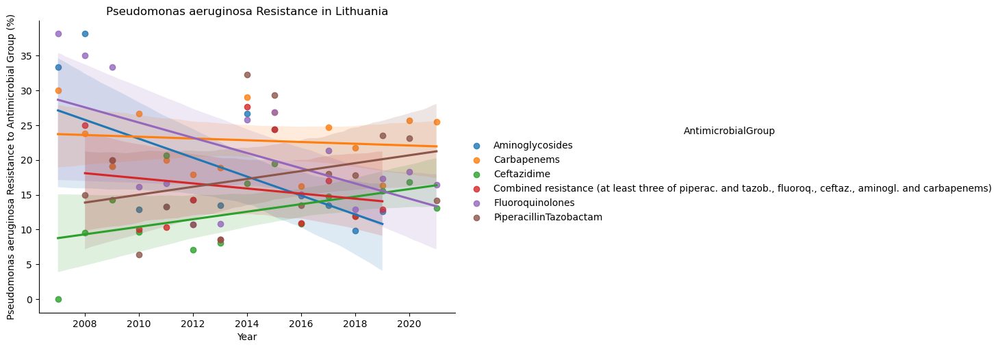

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


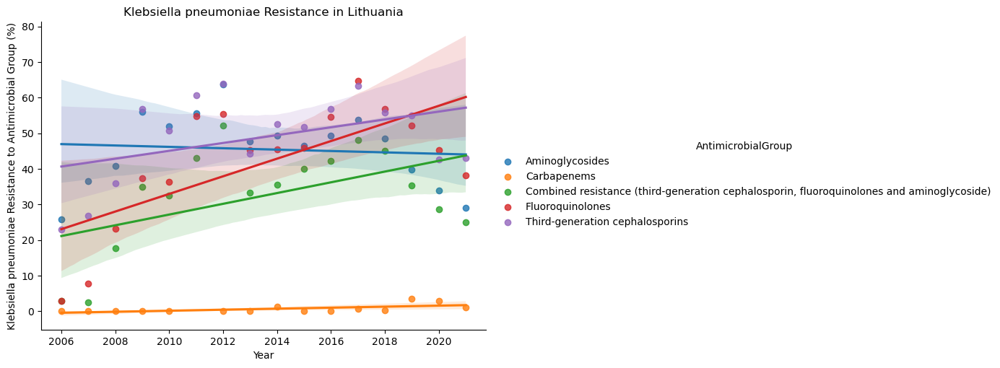

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


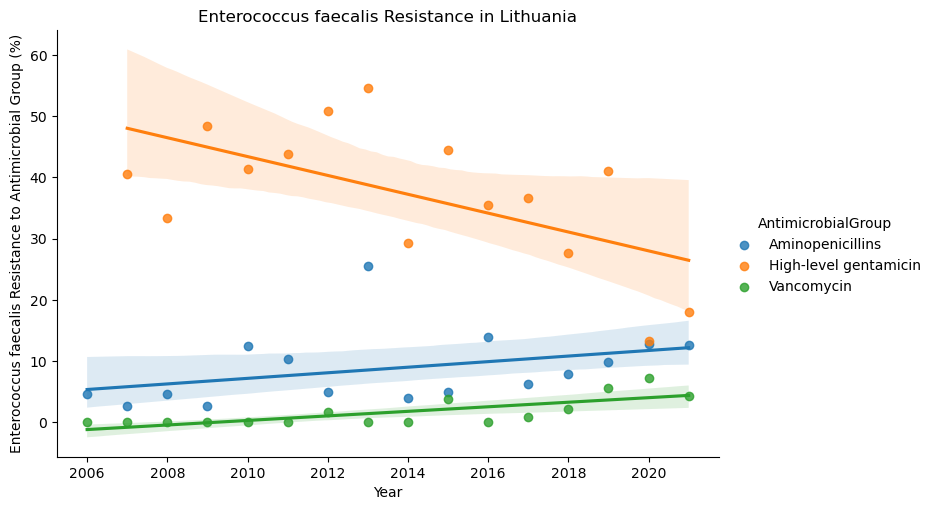

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


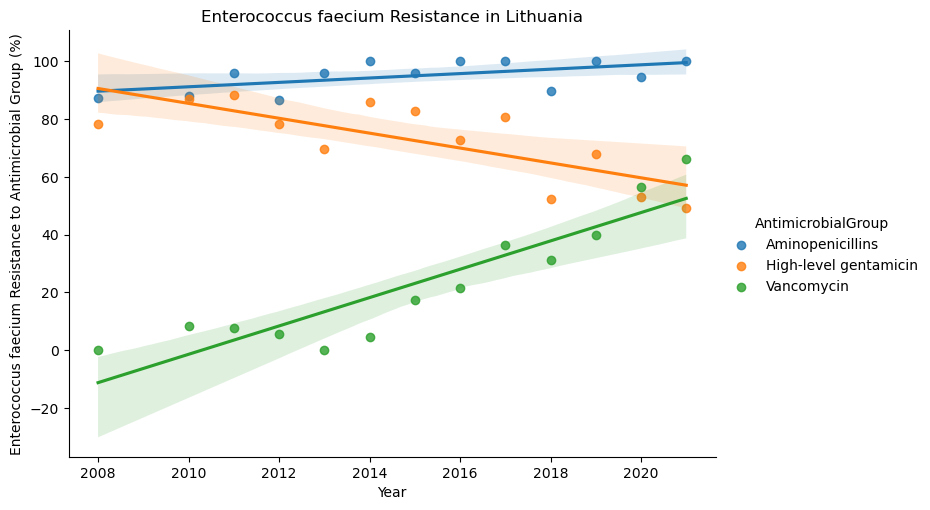

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


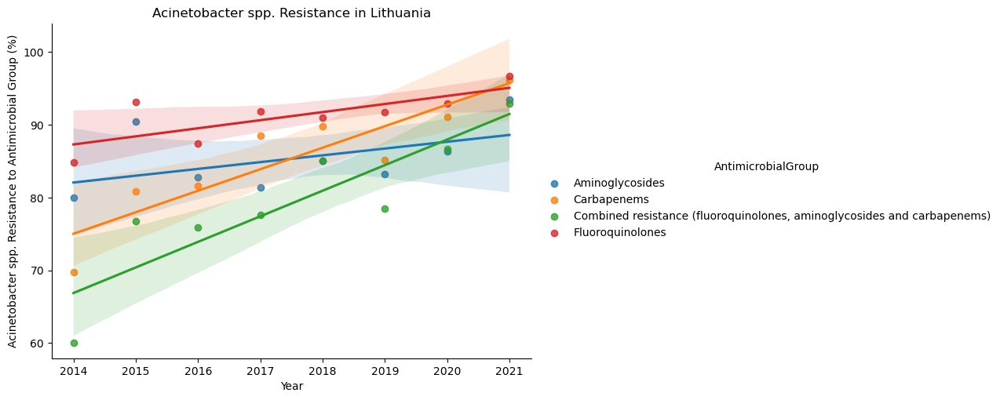

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


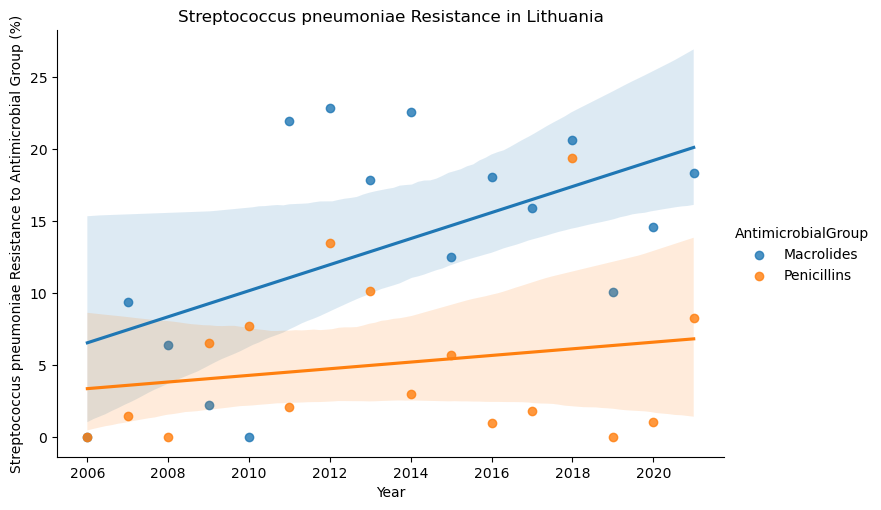

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


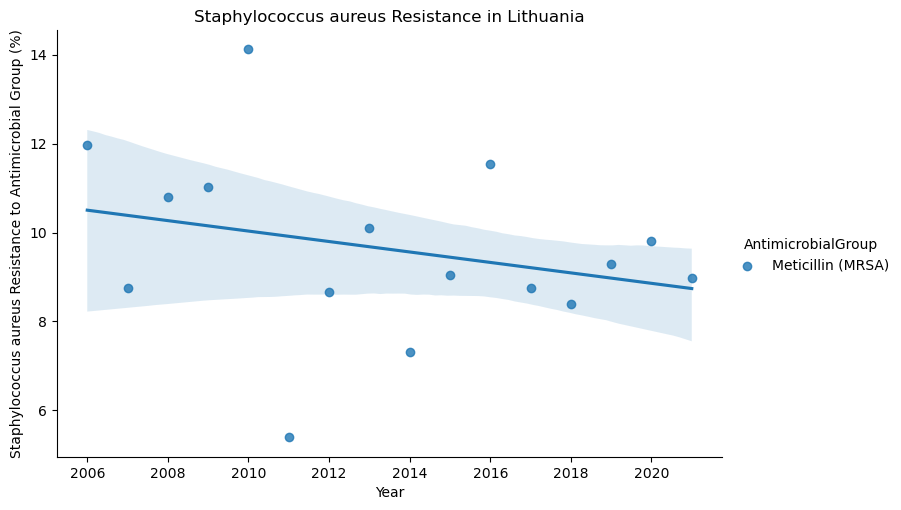

In [21]:
organisms = ['Escherichia coli', 'Pseudomonas aeruginosa', 'Klebsiella pneumoniae', 
             'Enterococcus faecalis', 'Enterococcus faecium', 'Acinetobacter spp.', 
             'Streptococcus pneumoniae', 'Staphylococcus aureus']

regions = ['Austria', 'Finland', 'Sweden', 'Portugal', 'Norway', 'Netherlands', 
           'Luxembourg', 'Italy', 'Belgium', 'Ireland', 'Iceland', 'Germany', 
           'Spain', 'Greece', 'Denmark', 'Estonia', 'Malta', 'Slovenia', 
           'Bulgaria', 'Czechia', 'Poland', 'France', 'Hungary', 'Romania', 
           'Croatia', 'Cyprus', 'United Kingdom', 'Latvia', 'Slovakia', 'Lithuania']

for region in regions:
    for organism in organisms:
        amr_1_df = amr_df.query("Organism == @organism and RegionName == @region")
        
        if not amr_1_df.empty:
            sns.lmplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", aspect=1.5)
            plt.xlabel("Year")
            plt.ylabel(f"{organism} Resistance to Antimicrobial Group (%)")
            plt.title(f"{organism} Resistance in {region}")
            plt.show()


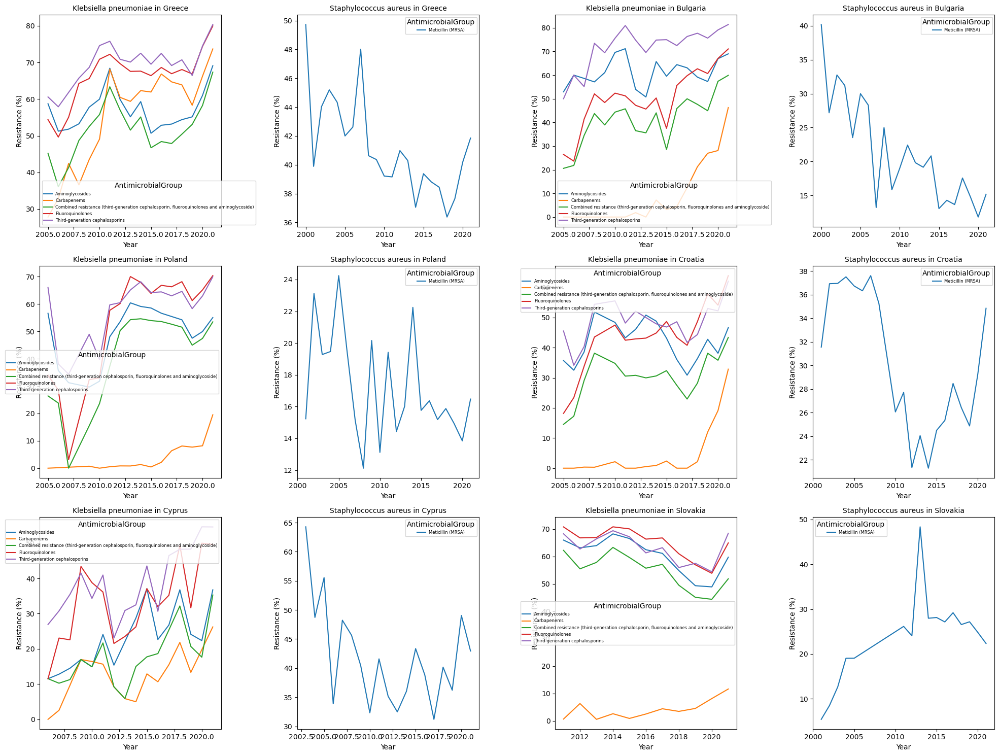

In [35]:
# Define organisms and regions
organisms = ['Klebsiella pneumoniae', 'Staphylococcus aureus', ]

regions = ['Greece', 'Bulgaria', 'Poland', 'Croatia', 'Cyprus', 'Slovakia']

# Calculate grid size for subplots
total_plots = len(organisms) * len(regions)
cols = 4  # Number of columns in the grid
rows = math.ceil(total_plots / cols)  # Calculate rows dynamically

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 5))
axes = axes.flatten()  # Flatten the 2D array of axes for easy iteration

# Loop over regions and organisms
plot_index = 0
for region in regions:
    for organism in organisms:
        # Filter data
        amr_1_df = amr_df.query("Organism == @organism and RegionName == @region")
        
        if not amr_1_df.empty:  # Plot only if data exists
            sns.lineplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", ax=axes[plot_index])
            axes[plot_index].set_title(f"{organism} in {region}", fontsize=10)
            axes[plot_index].set_xlabel("Year")
            axes[plot_index].set_ylabel("Resistance (%)")
            axes[plot_index].legend(fontsize=6, title="AntimicrobialGroup")
        else:
            axes[plot_index].axis('off')  # Turn off empty plots
            
        plot_index += 1

# Adjust layout
plt.tight_layout()
plt.show()

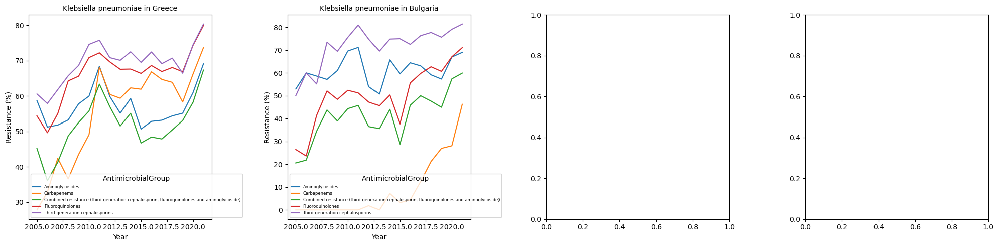

In [8]:
# Define organisms and regions
organisms = ['Klebsiella pneumoniae']

regions = ['Greece', 'Bulgaria']

# Calculate grid size for subplots
total_plots = len(organisms) * len(regions)
cols = 4  # Number of columns in the grid
rows = math.ceil(total_plots / cols)  # Calculate rows dynamically

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 5))
axes = axes.flatten()  # Flatten the 2D array of axes for easy iteration

# Loop over regions and organisms
plot_index = 0
for region in regions:
    for organism in organisms:
        # Filter data
        amr_1_df = amr_df.query("Organism == @organism and RegionName == @region")
        
        if not amr_1_df.empty:  # Plot only if data exists
            sns.lineplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", ax=axes[plot_index])
            axes[plot_index].set_title(f"{organism} in {region}", fontsize=10)
            axes[plot_index].set_xlabel("Year")
            axes[plot_index].set_ylabel("Resistance (%)")
            axes[plot_index].legend(fontsize=6, title="AntimicrobialGroup")
        else:
            axes[plot_index].axis('off')  # Turn off empty plots
            
        plot_index += 1

# Adjust layout
plt.tight_layout()
plt.show()

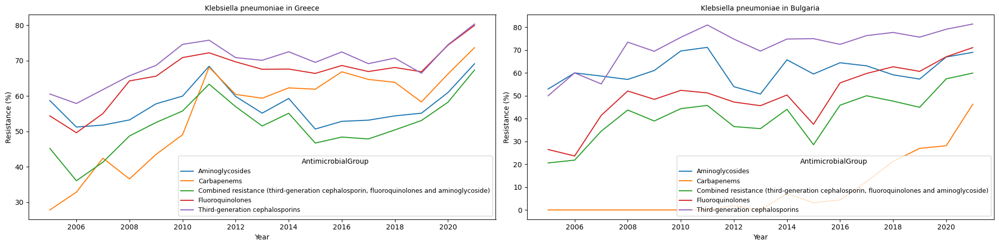

In [6]:
# Define organisms and regions
organisms = ['Klebsiella pneumoniae']

regions = ['Greece', 'Bulgaria']

# Calculate grid size for subplots
total_plots = len(organisms) * len(regions)
cols = 2  # Number of columns in the grid
rows = math.ceil(total_plots / cols)  # Calculate rows dynamically

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 5))
axes = axes.flatten()  # Flatten the 2D array of axes for easy iteration

# Loop over regions and organisms
plot_index = 0
for region in regions:
    for organism in organisms:
        # Filter data
        amr_1_df = amr_df.query("Organism == @organism and RegionName == @region")
        
        if not amr_1_df.empty:  # Plot only if data exists
            sns.lineplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", ax=axes[plot_index])
            axes[plot_index].set_title(f"{organism} in {region}", fontsize=10)
            axes[plot_index].set_xlabel("Year")
            axes[plot_index].set_ylabel("Resistance (%)")
            axes[plot_index].legend(fontsize=9, title="AntimicrobialGroup")
        else:
            axes[plot_index].axis('off')  # Turn off empty plots
            
        plot_index += 1

# Adjust layout
plt.tight_layout()
plt.show()

In [7]:
organism = 'Klebsiella pneumoniae' 
    
region = 'Bulgaria'
    
amr_1_df=amr_df.query("Organism ==@organism and RegionName ==@region")

sns.lineplot(data=amr_1_df, x="Year", y="PercentageResistant", hue="AntimicrobialGroup", ax=axes[plot_index])
axes[plot_index].set_title(f"{organism} in {region}", fontsize=10)
axes[plot_index].set_xlabel("Year")
axes[plot_index].set_ylabel("Resistance (%)")
axes[plot_index].legend(fontsize=9, title="AntimicrobialGroup")
plt.show()

IndexError: index 2 is out of bounds for axis 0 with size 2

/opt/conda/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


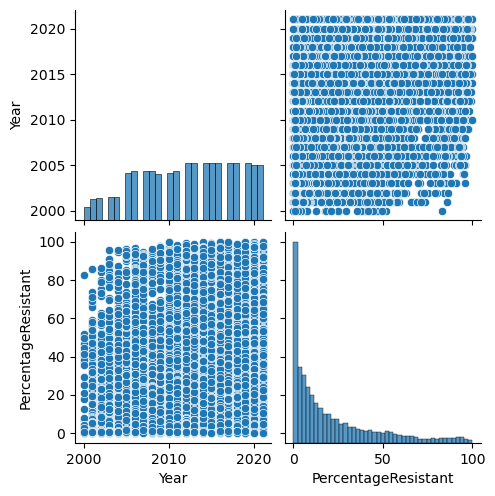

In [28]:
sns.pairplot(amr_df)
plt.show()